In [2]:
import numpy as np
import cv2
import csv
import matplotlib.pyplot as plt
import pandas as pd
import h5py as h5py
#from scipy import ndimage



class Image_stitching: 

    def __init__(self):
        self.name = "Peter"
        self.positions = []
        self.df = pd.DataFrame()
        self.intensity_map_14N = []
        self.intensity_map_15N = []
        self.intensity_map_12C = []
        self.best_positions = []
        self.best_positions.append(["Path", "Rotation", "Scaling", "CrossCorr", "y", "x"])

        self.angles = np.arange(-12, 12, 1)
        self.scaling_factors = np.arange(0.9, 1.1, 0.02) # np.linspace(0.64, 0.72, 10) # 0.84, 0.86, 0.88, 0.9, 0.92, 0.94, 
        self.scaling_factors_rough = np.arange(0.60, 0.65, 0.01) #0.7
        self.tolerance = 50
        self.border = 100 # Adds a border to the segmented image, so that it is always larger than Nano

        #Note that this values also have to be changed in "helper"
        self.exponent = 1
        self.negative_weighting = 1#1/3
        self.max_deviation_from_zero_big = 1000
        self.max_deviation_from_zero_small = 75

        self.temp_test_1 = []
        self.temp_test_2 = []
        self.temp_test_3 = []

######################### Image ###########################

    def _read_in_image(self, image_path):
        
        if (image_path[-3:]) == "png":
            image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        elif (image_path[-3:]) == "tif":
            image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
        else:
            print("Unknown format")
    
        return image
    
    def _read_in_h5(self, h5_path):

        with h5py.File(h5_path, 'r') as f:

            images = f['images'][:]
            labels = f['labels'][:]

        self.labels          = labels[49]

    def _rescale_NanoSIMS_image(self, image, scaling_factor = 0.6):
        (y,x) = image.shape
        y_resized, x_resized = int(y * scaling_factor), int(x * scaling_factor)

        resized = cv2.resize(image, [y_resized, x_resized], interpolation = cv2.INTER_AREA)
        return resized

    def rotate_image(self, image, angle):

        # Get the image's dimensions
        (h, w) = image.shape[:2]

        # Compute the center of the image
        center = (w / 2, h / 2)

        # Generate the 2x3 rotation matrix
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # Perform the rotation
        rotated = cv2.warpAffine(image, M, (w, h))

        

        return rotated
    
    def _divide_image(self, image):
        # Get the image's dimensions
        (h, w) = image.shape[:2]

        # Calculate the dimensions of the smaller images
        small_w = w // 2
        small_h = h // 2

        # A list to hold the smaller images
        small_images = []
        relative_positions = []

        # Extract each small image
        for i in range(3):
            for j in range(3):

                x_start, x_end = j * small_w // 2, (j + 2) * small_w // 2
                y_start, y_end = i * small_h // 2, (i + 2) * small_h // 2

                small_img = image[y_start:y_end, x_start:x_end]
                small_images.append(small_img)

                relative_positions.append([[y_start, y_end], [x_start, x_end]])

                #plt.imshow(small_img)
                #plt.show()

        return small_images, relative_positions

    def _find_all_explicit_labels(self, y_min, y_max, x_min, x_max):
        labels_inside = np.unique(self.labels_detailed[y_min:y_max, x_min:x_max])

        temp_labels = self.labels_detailed.copy()
        temp_labels[y_min:y_max, x_min:x_max] = 0
        labels_outside = np.unique(temp_labels)

        explicit_labels = np.setdiff1d(labels_inside, labels_outside)
        explicit_labels_image = np.where(np.isin(self.labels_detailed, explicit_labels), self.labels_detailed, 0)
        
        return explicit_labels, explicit_labels_image
    
######################### Data storage ###########################

    def _save_best_positions(self, path):

        # open the file in the write mode
        f = open(path + r'\scan.csv', 'a')

        # create the csv writer
        writer = csv.writer(f)
        

        for position in self.positions:
                writer.writerow(position)

        f.close()

    def _save_intensity_map(self, path):

        # open the file in the write mode
        f = open(path + r'\intensitymap.csv', 'a')

        # create the csv writer
        writer = csv.writer(f)
        

        for position in self.positions:
                writer.writerow(position)

        f.close()


######################### Alignment ###########################

    def _cross_correlation(self, image1, image2, return_best_cc = False):
        
        # Determine the size for padding based on the larger image dimensions
        max_rows = max(image1.shape[0], image2.shape[0])
        max_cols = max(image1.shape[1], image2.shape[1])
        
        # Pad the images to the same size
        img1_padded = cv2.copyMakeBorder(image1, 0, max_rows - image1.shape[0], 0, max_cols - image1.shape[1], cv2.BORDER_CONSTANT, value=0)
        img2_padded = cv2.copyMakeBorder(image2, 0, max_rows - image2.shape[0], 0, max_cols - image2.shape[1], cv2.BORDER_CONSTANT, value=0)
        
        # Compute the Fourier Transform of the padded images
        f1 = np.fft.fft2(img1_padded)
        f2 = np.fft.fft2(img2_padded)
        
        # Compute the cross-correlation using the Fourier Transforms
        correlation = np.fft.ifft2(f1 * np.conj(f2))
        
        # Find the location of the maximum value in the cross-correlation
        y, x = np.unravel_index(np.argmax(correlation), correlation.shape)

        if return_best_cc == True:

            return y, x, np.max(correlation).real

        else:

            return y, x
        
    def _cross_correlation_with_negative(self, image1, image2, return_best_cc = False, max_deviation_from_zero = 1000):
        image1[image1 == 0] = - np.max(image1) * self.negative_weighting
        # Determine the size for padding based on the larger image dimensions
        max_rows = max(image1.shape[0], image2.shape[0])
        max_cols = max(image1.shape[1], image2.shape[1])
        
        # Pad the images to the same size
        img1_padded = cv2.copyMakeBorder(image1, 0, max_rows - image1.shape[0], 0, max_cols - image1.shape[1], cv2.BORDER_CONSTANT, value=0)
        img2_padded = cv2.copyMakeBorder(image2, 0, max_rows - image2.shape[0], 0, max_cols - image2.shape[1], cv2.BORDER_CONSTANT, value=0)
        
        # Compute the Fourier Transform of the padded images
        f1 = np.fft.fft2(img1_padded)
        f2 = np.fft.fft2(img2_padded)
        
        # Compute the cross-correlation using the Fourier Transforms
        correlation = np.fft.ifft2(f1 * np.conj(f2))

        correlation = correlation[0:max_deviation_from_zero, 0:max_deviation_from_zero]
        
        # Find the location of the maximum value in the cross-correlation
        y, x = np.unravel_index(np.argmax(correlation), correlation.shape)

        if return_best_cc == True:

            return y, x, np.max(correlation).real

        else:

            return y, x
    
    def _cross_correlation_with_inverse(self, image1, image2, return_best_cc = False):

        # Creating the inverse images
        inverse_image1 = np.ones(image1.shape) * np.max(image1) - image1
        inverse_image2 = image2

        # Determine the size for padding based on the larger image dimensions
        max_rows = max(image1.shape[0], image2.shape[0])
        max_cols = max(image1.shape[1], image2.shape[1])

        inv_max_rows = max(inverse_image1.shape[0], inverse_image2.shape[0])
        inv_max_cols = max(inverse_image1.shape[1], inverse_image2.shape[1])

        # Pad the images to the same size
        img1_padded = cv2.copyMakeBorder(image1, 0, max_rows - image1.shape[0], 0, max_cols - image1.shape[1], cv2.BORDER_CONSTANT, value=0)
        img2_padded = cv2.copyMakeBorder(image2, 0, max_rows - image2.shape[0], 0, max_cols - image2.shape[1], cv2.BORDER_CONSTANT, value=0)

        inv_img1_padded = cv2.copyMakeBorder(inverse_image1, 0, inv_max_rows - inverse_image1.shape[0], 0, inv_max_cols - inverse_image1.shape[1], cv2.BORDER_CONSTANT, value=0)
        inv_img2_padded = cv2.copyMakeBorder(inverse_image2, 0, inv_max_rows - inverse_image2.shape[0], 0, inv_max_cols - inverse_image2.shape[1], cv2.BORDER_CONSTANT, value=0)

        # Compute the Fourier Transform of the padded images
        f1 = np.fft.fft2(img1_padded)
        f2 = np.fft.fft2(img2_padded)

        inv_f1 = np.fft.fft2(inv_img1_padded)
        inv_f2 = np.fft.fft2(inv_img2_padded)

        # Compute the cross-correlation using the Fourier Transforms
        correlation     = np.fft.ifft2(f1 *     np.conj(f2))
        inv_correlation = np.fft.ifft2(inv_f1 * np.conj(inv_f2))

        # Idea: Rescaling this to ignore border 

        correlation_normalized     = correlation /     np.max(correlation)
        inv_correlation_normalized = inv_correlation / np.max(inv_correlation)

        prod_correlation = 0*correlation_normalized + inv_correlation_normalized

        # Find the location of the maximum value in the cross-correlation
        y, x = np.unravel_index(np.argmax(prod_correlation), prod_correlation.shape)
        y, x = np.unravel_index(np.argmin(prod_correlation), prod_correlation.shape)

        if return_best_cc == True:
            #print(np.max(correlation),  np.max(inv_correlation))
            #print(np.max(prod_correlation).real)
            return y, x, np.max(prod_correlation).real
            

        else:

            return y, x



######################### Stitching ###########################

    def _stitching(self, image1, image2, x, y):

        if len(image1.shape) == 2 & len(image2.shape) == 2:

            # Create an output image filled with zeros (black)
            h1, w1 = image1.shape
            h2, w2 = image2.shape
            output = np.zeros((max(h1, y + h2), max(w1, x + w2)), dtype=np.uint8)
            
            # Place the images on the output image
            output[y:y+h2, x:x+w2] = image2
            output[0:h1, 0:w1]    += image1
            output = np.clip(output, 0, 255)


        elif len(image1.shape) == 3 & len(image2.shape) == 3:

            # Create an output image filled with zeros (black)
            h1, w1, _ = image1.shape
            h2, w2, _ = image2.shape
            output = np.zeros((max(h1, y + h2), max(w1, x + w2), 3), dtype=np.uint8)
            
            # Place the images on the output image
            output[y:y+h2, x:x+w2] = image2
            output[0:h1, 0:w1]    += image1
            output = np.clip(output, 0, 255)

        else: 
            print("ERROR")

        return output

    def _highlight_difference(self, image1, image2, x, y, mode = "twochanneloverlay"):

        if (len(image1.shape) == 2) & (len(image2.shape) == 2) & (mode == "overlay"):

            image1 = (np.array(image1,dtype=np.uint)*128)//np.max(image1)
            image2 = (np.array(image2,dtype=np.uint)*255)//np.max(image2)

            # Create an output image filled with zeros (black)
            h1, w1 = image1.shape
            h2, w2 = image2.shape
            output = np.zeros((max(h1, y + h2), max(w1, x + w2)), dtype=np.uint)
            
            # Place the images on the output image
            output[y:y+h2, x:x+w2] = image2 
            output[0:h1, 0:w1] += image1
            output[y:h1, x:w1] = output[y:h1, x:w1] // 2 
            output = np.clip(output, 0, 255)
            output = np.array(output, dtype=np.uint8)
            self._show_image(output)

        
        elif (len(image1.shape) == 2) & (len(image2.shape) == 2) & (mode == "onoff"):
            image1_mask = image1 > 0
            image1_mask_inverted = image1 == 0
            image2 = (np.array(image2,dtype=np.uint)*255)//np.max(image2)

            # Create an output image filled with zeros (black)
            h1, w1 = image1.shape
            h2, w2 = image2.shape
            output = np.zeros((max(h1, y + h2), max(w1, x + w2)), dtype=np.uint)
            # Place the images on the output image
            output[y:y+h2, x:x+w2] = image2 
            output1 = output.copy()
            output2 = output.copy()
            output1[0:h1, 0:w1] = np.where(image1_mask, output[0:h1, 0:w1], 0) 
            output2[0:h1, 0:w1] = np.where(image1_mask_inverted, output[0:h1, 0:w1], 0)
            self._show_image(output1)
            self._show_image(output2)

                    
        elif (len(image1.shape) == 2) & (len(image2.shape) == 2) & (mode == "twochanneloverlay"):
            image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)
            image2 = (np.array(image2,dtype=np.uint)*255)//np.max(image2)

            # Create an output image filled with zeros (black)
            h1, w1 = image1.shape
            h2, w2 = image2.shape

            output = np.zeros((max(h1, y + h2), max(w1, x + w2)), dtype=np.uint)
            output[y:y+h2, x:x+w2] = image2 
            plt.imshow(output, interpolation='none') 

            output = np.zeros((max(h1, y + h2), max(w1, x + w2)), dtype=np.uint)
            output[0:h1, 0:w1] = image1
            plt.imshow(output, cmap='jet', alpha = 0.5, interpolation='none')

            plt.show()

            


        elif len(image1.shape) == 3 & len(image2.shape) == 3:
            print("Servus")
            # Create an output image filled with zeros (black)
            h1, w1, _ = image1.shape
            h2, w2, _ = image2.shape
            output = np.zeros((max(h1, y + h2), max(w1, x + w2), 3), dtype=np.uint8)
            
            # Place the images on the output image
            output[y:y+h2, x:x+w2] = image2
            output[0:h1, 0:w1] += image1
            #output = np.clip(output, 0, 255)

        else: 
            print("ERROR")

        return output


######################### Visualize image ###########################

    def _show_image(self, image):
        if False: 
            # Display the result
            cv2.imshow("Overlapped Images", image)
            cv2.waitKey(0)
            cv2.destroyAllWindows()

        else:
            plt.imshow(image)
            plt.show()

######################### Helping the algorithm ###########################

    def _helper(self, MF_mask_path, MF_mask, image_index):
        # Limit search radius

        self.exponent = 1
        self.negative_weighting = 1/3
        self.max_deviation_from_zero_big = 1000

        if MF_mask_path == r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\seg_im_bin\Timelapse_pos11_TxRed_frame049_seg_bin.png":
            

            if image_index == 4:

                y_min, y_max, x_min, x_max = 0, 400, 0, 450
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max

            elif image_index == 9:

                y_min, y_max, x_min, x_max = 0, 400, 260, 450
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, self.labels.shape[0], x_min, self.labels.shape[1] 
                
            else:

                y_min, y_max, x_min, x_max = 0, MF_mask.shape[0], 0, MF_mask.shape[1]
                y_min_label, y_max_label, x_min_label, x_max_label = 0, self.labels.shape[0], 0, self.labels.shape[1]
        
        elif MF_mask_path == r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\seg_im_bin\Timelapse_pos8_TxRed_frame049_seg_bin.png":

            if image_index == 1:
                y_min, y_max, x_min, x_max = 0, 400, 0, 400
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max
                #self.negative_weighting = 1
                self.max_deviation_from_zero_big = 100

            elif image_index == 6:

                y_min, y_max, x_min, x_max = 0, 400, 250, 550 #0, 350, 100, 550
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max
                self.negative_weighting = 1

            elif image_index == 5:

                y_min, y_max, x_min, x_max = 200, 750, 340, 720
                self.max_deviation_from_zero_small = 75
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max
                self.negative_weighting = 2/3
                self.max_deviation_from_zero_big = 100

            elif image_index == 7:

                y_min, y_max, x_min, x_max = 220, 590, 560, 850
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max
                #self.negative_weighting = 1
                self.max_deviation_from_zero_big = 100

            else:

                y_min, y_max, x_min, x_max = 0, MF_mask.shape[0], 0, MF_mask.shape[1]
                y_min_label, y_max_label, x_min_label, x_max_label = 0, self.labels.shape[0], 0, self.labels.shape[1]

        elif MF_mask_path == r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\seg_im_bin\Timelapse_pos11_TxRed_frame049_seg_bin.png":

            if image_index == 2:

                y_min, y_max, x_min, x_max = 100, 600, 0, 300
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max

            elif image_index == 3:

                y_min, y_max, x_min, x_max = 100, 370, 0, 320
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max

            elif image_index == 4:

                y_min, y_max, x_min, x_max = 100, 370, 200, 500
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max

            elif image_index == 9:

                y_min, y_max, x_min, x_max = 100, 370, 300, 700
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max

            elif image_index == 10:

                y_min, y_max, x_min, x_max = 300, 600, 250, 400
                y_min_label, y_max_label, x_min_label, x_max_label = y_min, y_max, x_min, x_max
            
            else:

                y_min, y_max, x_min, x_max = 0, MF_mask.shape[0], 0, MF_mask.shape[1]
                y_min_label, y_max_label, x_min_label, x_max_label = 0, self.labels.shape[0], 0, self.labels.shape[1]
                
        else:

            y_min, y_max, x_min, x_max = 0, MF_mask.shape[0], 0, MF_mask.shape[1]
            y_min_label, y_max_label, x_min_label, x_max_label = 0, self.labels.shape[0], 0, self.labels.shape[1]

        self.labels_detailed = self.labels_detailed[y_min_label : self.labels.shape[0], x_min_label : self.labels.shape[1]]

        MF_mask = MF_mask[y_min : y_max, x_min : x_max]

        search_radius = [y_min, y_max, x_min, x_max]

        self.labels = self.labels[y_min_label : y_max_label, x_min_label : x_max_label]
        
        

        return MF_mask, search_radius


######################### NanoSIMS functions ###########################

    def test_nano_stitching(self, NanoSIMS_path,  arrangement):

        image1_path = NanoSIMS_path[0] + str(2) + NanoSIMS_path[1]
        image2_path = NanoSIMS_path[0] + str(3) + NanoSIMS_path[1]

        image1 = self._read_in_image(image1_path)
        image2 = self._read_in_image(image2_path)

        print(image1.shape)

        self._show_image(image1)
        best_y, best_x = self._cross_correlation_with_negative(image1, image2 )

        print(best_x, best_y)

        stitched = self._stitching(image1, image2, x = best_x, y = best_y)

        print(stitched.shape)
        self._show_image(stitched)

    def test_find_position_within(self, NanoSIMS_path, MF_mask_path, arrangement, max_deviation_from_zero= 1000):

        image1_path = MF_mask_path 
        image2_path = NanoSIMS_path[0] + str(2) + NanoSIMS_path[1]

        image1 = self._read_in_image(image1_path)
        image_1_2 = np.zeros([image1.shape[0] + 50, image1.shape[1] + 50], dtype=np.uint8)
        image_1_2[50:,50:] = image1
        image1 = image_1_2
        image2 = self._read_in_image(image2_path)
        image2 = self._rescale_NanoSIMS_image(image2)

        print(image1.shape)

        self._show_image(image1)
        best_y, best_x = self._cross_correlation_with_negative(image1, image2, max_deviation_from_zero= max_deviation_from_zero)

        print(best_x, best_y)
        

        stitched = self._stitching(image1, image2, x = best_x, y = best_y)

        self._show_image(stitched)

    def scan(self, NanoSIMS_image_, MF_mask_, Results_path, NanoSIMS_path, angles = np.linspace(-8, 8, 20), scaling_factors = np.linspace(0.64, 0.72, 10), max_deviation_from_zero=1000):

        self.positions = []
        self.positions.append(["Path", "Rotation", "Scaling", "CrossCorr", "y", "x"])
        
        print(max_deviation_from_zero)

        for angle in angles: 

                for scaling_factor in scaling_factors:

                    NanoSIMS_image_scaled = self._rescale_NanoSIMS_image(NanoSIMS_image_, scaling_factor)
                    NanoSIMS_image_rot = self.rotate_image(NanoSIMS_image_scaled, angle)
                    
                    #best_y, best_x, best_cc = self._cross_correlation(MF_mask_, NanoSIMS_image_rot, return_best_cc = True)
                    #best_y, best_x, best_cc = self._cross_correlation_with_inverse(MF_mask_, NanoSIMS_image_rot, return_best_cc = True)
                    best_y, best_x, best_cc = self._cross_correlation_with_negative(MF_mask_, NanoSIMS_image_rot, return_best_cc = True, max_deviation_from_zero= max_deviation_from_zero)
                    
                    self.positions.append([NanoSIMS_path, angle, scaling_factor, best_cc / scaling_factor ** self.exponent, best_y, best_x]) #best_cc / scaling_factor**2 ,best_y, best_x]) # 

        self._save_best_positions(Results_path)
        df = pd.DataFrame(self.positions[1:], columns = self.positions[0]) 

        return df
    
    def best_of_scan_from_csv(self, NanoSIMS_image_, MF_mask_, Results_path, show_image = False, show_difference = False):
        
        image1 = MF_mask_
        image2 = NanoSIMS_image_

        
        # Read in scan and plot best image
        df = pd.read_csv(Results_path + r"\scan.csv")
        best_values = df.iloc[np.argmax(df["CrossCorr"])]

        image2_scaled = self._rescale_NanoSIMS_image(image2, best_values["Scaling"])
        image_2_rot = self.rotate_image(image2_scaled, best_values["Rotation"])

        f = open(Results_path + r"\best.csv", 'a')

        # create the csv writer
        writer = csv.writer(f)
        writer.writerow(list(best_values))

        f.close()




        stitched_image = self._stitching(image1, image_2_rot, x = best_values["x"], y = best_values["y"])
        if show_image == True:
            self._show_image(stitched_image)

        if show_difference == True:
            difference_image = self._highlight_difference(image1, image_2_rot, x = best_values["x"], y = best_values["y"])
            self._show_image(difference_image)

        return best_values, stitched_image
    
    def best_of_scan_from_df(self, NanoSIMS_image_, MF_mask_, Results_path, df, show_image = True, show_difference = True, mode = "twochanneloverlay", max_deviation_from_zero = 100):
        
        # Read in scan and plot best image
        best_values = df.iloc[np.argmax(df["CrossCorr"])]
        self.best_positions.append(best_values)

        # Rescale and rotate the image according to the best position
        NanoSIMS_image_scaled = self._rescale_NanoSIMS_image(NanoSIMS_image_, best_values["Scaling"])
        NanoSIMS_image_rot    = self.rotate_image(NanoSIMS_image_scaled, best_values["Rotation"])

        # Save the best position for later times
        f = open(Results_path + r"\best.csv", 'a')
        writer = csv.writer(f)
        writer.writerow(list(best_values))
        f.close()

        # Show the results
        if show_image == True:
            stitched_image = self._stitching(image1 = MF_mask_, image2 = NanoSIMS_image_rot, x = best_values["x"], y = best_values["y"])
            self._highlight_difference(image1 = MF_mask_, image2 = NanoSIMS_image_rot, x = best_values["x"], y = best_values["y"], mode = mode)
            self._show_image(stitched_image)

        if show_difference == True:
            difference_image = self._highlight_difference(image1 = MF_mask_, image2 = NanoSIMS_image_rot, x = best_values["x"], y = best_values["y"], mode = mode)

        return best_values

    def divide_and_conquer(self, NanoSIMS_path_14N, NanoSIMS_path_15N, NanoSIMS_path_12C, MF_mask_path, Results_path, h5_path, image_index = 2, mode = "onoff", max_deviation_from_zero = 100):

        # Read in Microfluidics image
        MF_mask = self._read_in_image(MF_mask_path)
        
        # Add border to the image, such that it will always stay at the top-left corner (easier implementation later)
        border = self.border
        temp_MF_mask = np.zeros([MF_mask.shape[0] + 2 * border, MF_mask.shape[1] + 2 * border], dtype=np.uint8)
        temp_MF_mask[border: -border,border: -border] = MF_mask
        MF_mask = temp_MF_mask

        # Read in NanoSIMS_image from channels 14N (which will be used to adjust the positions); 15N and 12C 
        NanoSIMS_path  = NanoSIMS_path_14N[0] + str(image_index) + NanoSIMS_path_14N[1]
        NanoSIMS_image = self._read_in_image(NanoSIMS_path)
        self._show_image(NanoSIMS_image)

        NanoSIMS_path_15N  = NanoSIMS_path_15N[0] + str(image_index) + NanoSIMS_path_15N[1]
        NanoSIMS_image_15N = self._read_in_image(NanoSIMS_path_15N)

        NanoSIMS_path_12C  = NanoSIMS_path_12C[0] + str(image_index) + NanoSIMS_path_12C[1]
        NanoSIMS_image_12C = self._read_in_image(NanoSIMS_path_12C)


        """
        Implement a tool to help the guesser
        
        """
        
        # Read in h5-File
        self._read_in_h5(h5_path)
        temp_labels = np.zeros([self.labels.shape[0] + 2 * border, self.labels.shape[1] + 2 * border], dtype=np.uint16)
        temp_labels[border: -border, border: - border] = self.labels
        self.labels = np.pad(temp_labels, pad_width=100, constant_values=0) [100:, 100:]
        self.labels_detailed = self.labels.copy()
        
        MF_mask, search_radius = self._helper(MF_mask_path = MF_mask_path, MF_mask = MF_mask, image_index = image_index) #Also update labels file!! 

        

        # Scan for best position of NanoSIMS image in microfluidics image
        df         = self.scan(NanoSIMS_image_ = NanoSIMS_image, MF_mask_ = MF_mask, Results_path = Results_path, NanoSIMS_path = NanoSIMS_path, scaling_factors = self.scaling_factors_rough, angles= self.angles, max_deviation_from_zero = self.max_deviation_from_zero_big)
        best_value = self.best_of_scan_from_df(NanoSIMS_image_ = NanoSIMS_image, MF_mask_ = MF_mask, Results_path = Results_path, df = df, show_image = True, show_difference = False, mode = mode)

        print(best_value)

        # Rotate and rescale the image according to the best position
        temp_NanoSIMS_image = self._rescale_NanoSIMS_image(NanoSIMS_image, best_value["Scaling"])
        NanoSIMS_image      = self.rotate_image(image = temp_NanoSIMS_image, angle = best_value["Rotation"]) 

        temp_NanoSIMS_image_15N = self._rescale_NanoSIMS_image(NanoSIMS_image_15N, best_value["Scaling"])
        NanoSIMS_image_15N      = self.rotate_image(image = temp_NanoSIMS_image_15N, angle = best_value["Rotation"]) 

        temp_NanoSIMS_image_12C = self._rescale_NanoSIMS_image(NanoSIMS_image_12C, best_value["Scaling"])
        NanoSIMS_image_12C      = self.rotate_image(image = temp_NanoSIMS_image_12C, angle = best_value["Rotation"]) 

        # Show the image 


        # Divide image into nine smaller images 
        divided_NanoSIMS_image, relative_position_divided_NanoSIMS_image = self._divide_image(NanoSIMS_image)
        divided_NanoSIMS_image_15N, _                                    = self._divide_image(NanoSIMS_image_15N)
        divided_NanoSIMS_image_12C, _                                    = self._divide_image(NanoSIMS_image_12C)

        tolerance = self.tolerance  #How much "tolerance" to the rough stitching
        
        resulting_image = np.zeros([NanoSIMS_image.shape[0] + 2 * tolerance, NanoSIMS_image.shape[1] + 2 * tolerance])

        for index in range(len(divided_NanoSIMS_image)):

            #Define current images
            small_image     = divided_NanoSIMS_image[index].copy()
            small_image_15N = divided_NanoSIMS_image_15N[index].copy()
            small_image_12C = divided_NanoSIMS_image_12C[index].copy()

            y_small_image, x_small_image = small_image.shape
            relative_position = relative_position_divided_NanoSIMS_image[index] 

            #Define cropped mask
            y_min, y_max = best_value["y"] + relative_position[0][0],  best_value["y"] + relative_position[0][1]
            x_min, x_max = best_value["x"] + relative_position[1][0],  best_value["x"] + relative_position[1][1]
            cropped_MF_mask = MF_mask[y_min: y_max, x_min: x_max].copy()
            temp_MF_mask    = np.zeros([cropped_MF_mask.shape[0] + 2 * tolerance, cropped_MF_mask.shape[1] + 2 * tolerance], dtype=np.uint8)
            temp_MF_mask[tolerance: - tolerance, tolerance: - tolerance] = cropped_MF_mask
            cropped_MF_mask = temp_MF_mask.copy()
            
            #Calculate best position on cropped mask
            df_small_image =          self.scan(NanoSIMS_image_ = small_image.copy(), MF_mask_ = cropped_MF_mask, Results_path = Results_path, NanoSIMS_path = NanoSIMS_path + "SubimageIndex" + str(index), scaling_factors = self.scaling_factors, angles = self.angles, max_deviation_from_zero = self.max_deviation_from_zero_small)
            best_values_small_image = self.best_of_scan_from_df(NanoSIMS_image_ = small_image, MF_mask_ = cropped_MF_mask, Results_path = Results_path, df = df_small_image, show_image = False, show_difference = True, max_deviation_from_zero = self.max_deviation_from_zero_small)
            
            print(best_values_small_image)

            y_diff, x_diff = relative_position[0][0] + best_values_small_image["y"], relative_position[1][0] + best_values_small_image["x"]

            resulting_small_image     = self.rotate_image(small_image,     best_values_small_image["Rotation"])[:y_small_image, :x_small_image]
            resulting_small_image_15N = self.rotate_image(small_image_15N, best_values_small_image["Rotation"])[:y_small_image, :x_small_image]
            resulting_small_image_12C = self.rotate_image(small_image_12C, best_values_small_image["Rotation"])[:y_small_image, :x_small_image]

            resulting_image[y_diff : y_diff + y_small_image, x_diff : x_diff + x_small_image] = resulting_small_image

            
            
            #Find labels in the current image and  
            y_min_labels, y_max_labels = best_value["y"] + y_diff,  best_value["y"] + y_diff + y_small_image
            x_min_labels, x_max_labels = best_value["x"] + x_diff,  best_value["x"] + x_diff + x_small_image
            
            print(x_min_labels, x_max_labels, y_min_labels, y_max_labels)
            print(self.labels_detailed.shape)

            labels_in_small_image, _ = self._find_all_explicit_labels(y_min = y_min_labels, y_max = y_max_labels, x_min = x_min_labels, x_max = x_max_labels)
            label_image =              self.labels_detailed[y_min_labels: y_max_labels, x_min_labels: x_max_labels].copy()
            
            print(label_image.shape)

            for label in labels_in_small_image:
                
                self.intensity_map_14N.append([label, np.sum(resulting_small_image    [label_image == label])/len(resulting_small_image    [label_image == label])])
                self.intensity_map_15N.append([label, np.sum(resulting_small_image_15N[label_image == label])/len(resulting_small_image_15N[label_image == label])])
                self.intensity_map_12C.append([label, np.sum(resulting_small_image_12C[label_image == label])/len(resulting_small_image_12C[label_image == label])])

        plt.imshow(resulting_image)
        plt.title("Resulting image")
        plt.show()
        
        #NanoSIMS_image = resulting_image
        #df = self.scan(NanoSIMS_image_ = NanoSIMS_image, MF_mask_ = MF_mask, Results_path = Results_path, NanoSIMS_path = NanoSIMS_path + "CorrectedImage")
        #best_value = self.best_of_scan_from_df(NanoSIMS_image_ = NanoSIMS_image, MF_mask_ = MF_mask, Results_path = Results_path, df = df, show_image = True, show_difference = False)


        return resulting_image
    
    def big_stichted_image(self, resulting_image_list): 
        self.best_positions
        resulting_image_list
        df_best_positions = pd.DataFrame(self.best_positions[1:], columns = self.best_positions[0])

        #Find main strings
        df_best_positions = df_best_positions[np.array([path.find("SubimageIndex") for path in self.best_positions["Path"]]) == -1]
               

        return 0

    def create_combined_image(self, NanoSIMS_path_14N, NanoSIMS_path_15N, NanoSIMS_path_12C, MF_mask_path, Results_path, h5_path, arrangement, mode = "onoff"):
        resulting_image_list = []
        for image_column in arrangement:
            temp_resulting_image_list = []
            for image_index in image_column:
                
                res = self.divide_and_conquer(NanoSIMS_path_14N = NanoSIMS_path_14N, NanoSIMS_path_15N = NanoSIMS_path_15N, NanoSIMS_path_12C = NanoSIMS_path_12C, MF_mask_path = MF_mask_path, Results_path = Results_path, h5_path = h5_path, image_index = image_index, mode = mode)
                temp_resulting_image_list.append(res)
            resulting_image_list.append(temp_resulting_image_list)
            
        self._save_intensity_map(Results_path)
        
        return resulting_image_list
        


In [8]:
N14_image_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\15N\FW_1108_pos8_chn1_2-15N12C.tif"
N15_image_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\14N\FW_1108_pos8_chn1_2-14N12C.tif"

In [29]:
N14_image = cv2.imread(N14_image_path, cv2.IMREAD_UNCHANGED)
N15_image = cv2.imread(N15_image_path, cv2.IMREAD_UNCHANGED)

In [30]:
N14_image[N14_image == 0] = 1
N15_image[N14_image == 0] = 0

In [32]:
(np.array(N15_image,dtype=np.float32)) / np.array(N14_image,dtype=np.float32)

array([[ 2.       ,  4.       ,  4.       , ...,  4.172414 ,  2.7777777,
         9.       ],
       [ 1.       ,  2.       ,  1.       , ...,  2.909091 ,  2.8484848,
        10.       ],
       [ 1.       ,  0.       ,  3.       , ...,  3.7931035,  4.172414 ,
        14.       ],
       ...,
       [ 4.       ,  8.       ,  2.       , ...,  5.6666665,  8.833333 ,
        10.       ],
       [10.       ,  7.       ,  3.       , ..., 13.25     , 10.       ,
         8.       ],
       [10.       , 43.       ,  6.       , ...,  4.       ,  2.945946 ,
        32.       ]], dtype=float32)

In [39]:
np.hist(np.array(N15_image,dtype=np.float32))

AttributeError: module 'numpy' has no attribute 'hist'

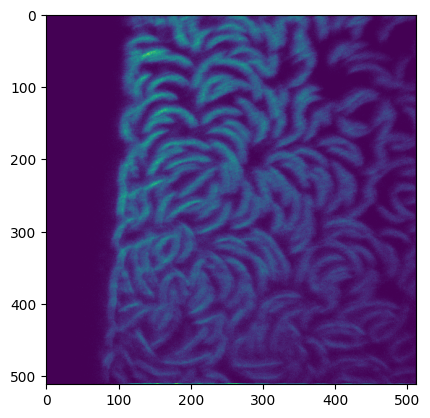

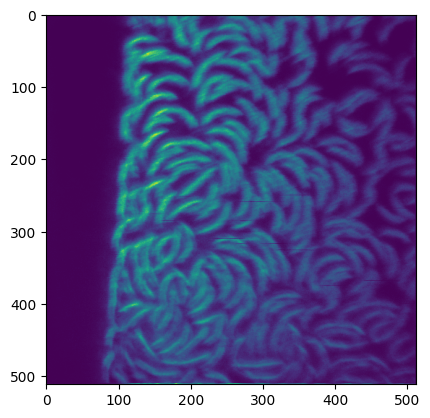

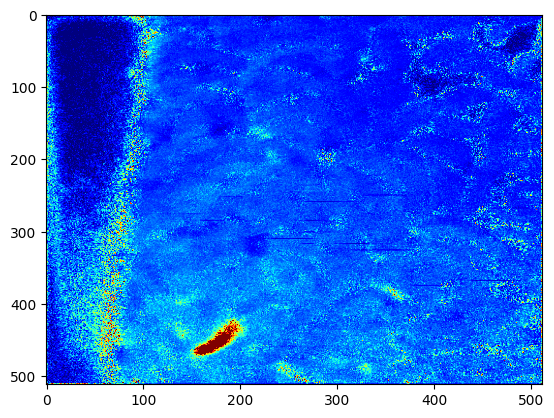

In [37]:
plt.imshow(N14_image)
plt.show()
plt.imshow(N15_image)
plt.show()
plt.imshow((np.array(N15_image,dtype=np.float32)) / np.array(N14_image,dtype=np.float32), vmin=1, vmax=20, cmap='jet', aspect='auto')
plt.show()

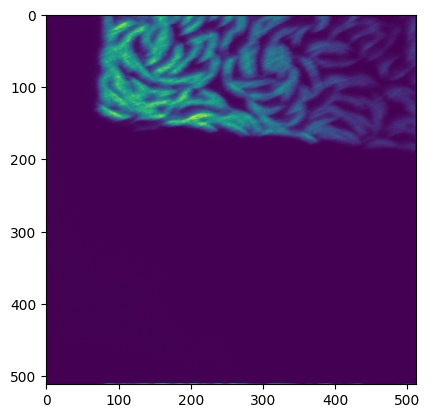

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


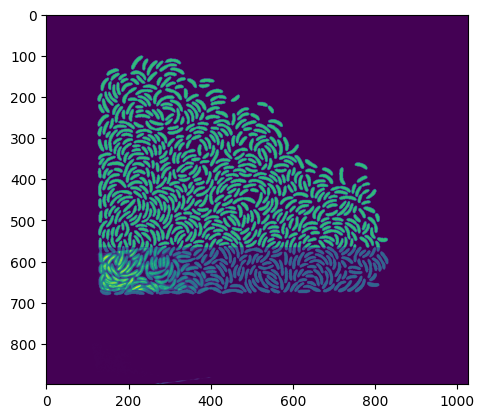

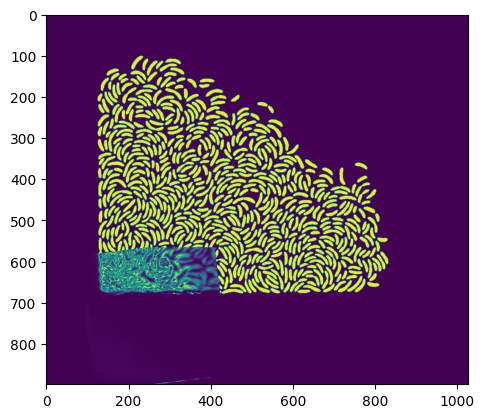

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     7
Scaling                                                   0.65
CrossCorr                                    1429413092.307692
y                                                          567
x                                                           96
Name: 119, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


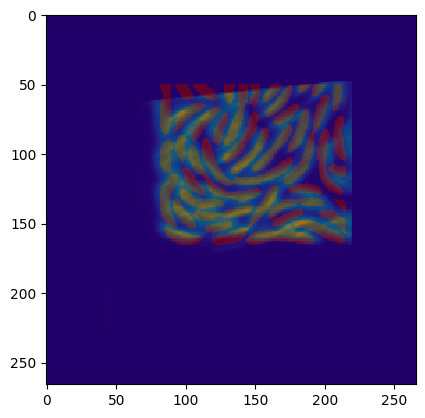

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                   1.08
CrossCorr                                     660802513.888889
y                                                           47
x                                                           41
Name: 130, dtype: object
137 303 614 780
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


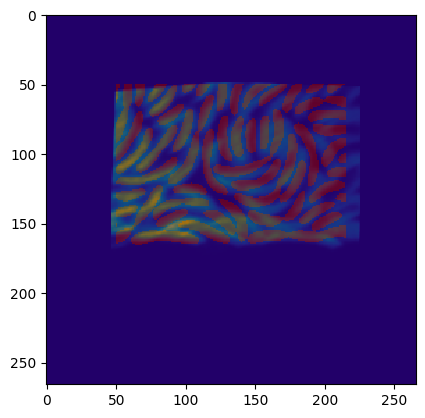

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                   1.08
CrossCorr                                          608937875.0
y                                                           49
x                                                           47
Name: 119, dtype: object
226 392 616 782
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


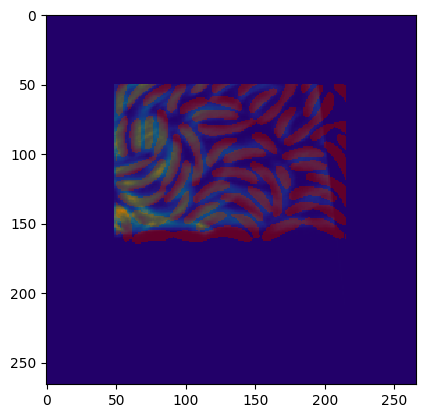

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          289631805.0
y                                                           50
x                                                           49
Name: 137, dtype: object
311 477 617 783
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


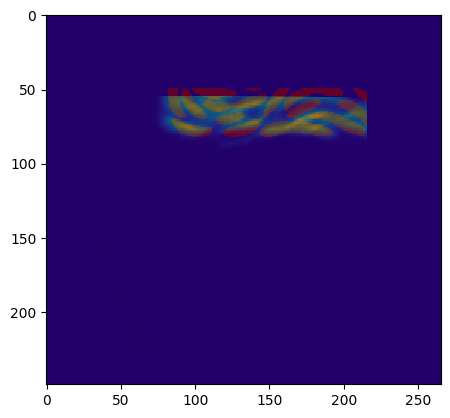

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                   1.08
CrossCorr                                     202570111.111111
y                                                           55
x                                                           37
Name: 130, dtype: object
133 299 705 871
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


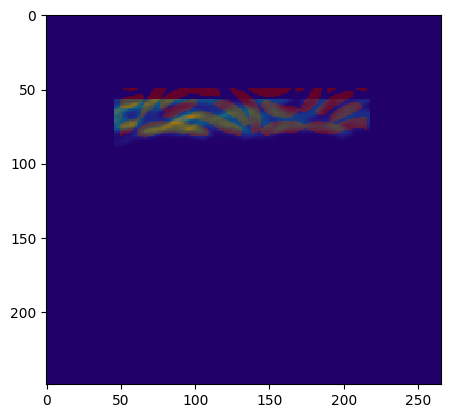

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     190331019.230769
y                                                           57
x                                                           46
Name: 139, dtype: object
225 391 707 873
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


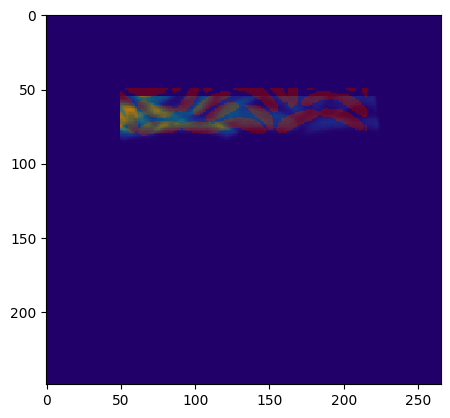

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                           90361800.0
y                                                           55
x                                                           50
Name: 142, dtype: object
312 478 705 871
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


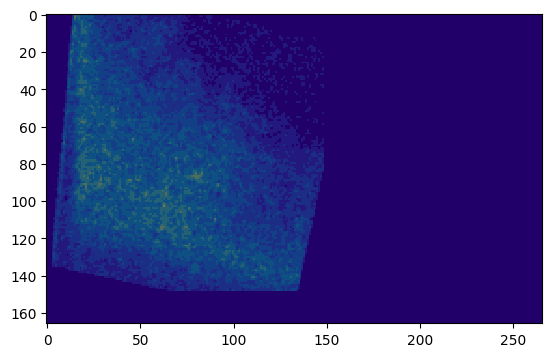

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
96 262 733 899
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


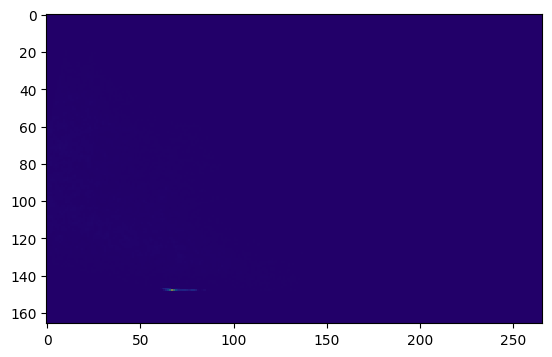

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
179 345 733 899
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


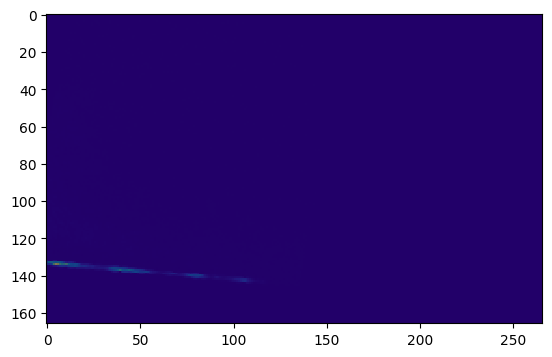

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
262 428 733 899
(899, 1127)
(166, 166)


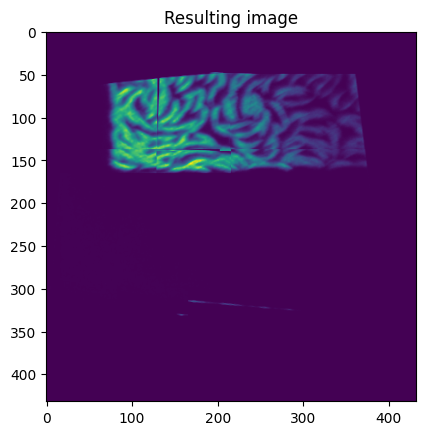

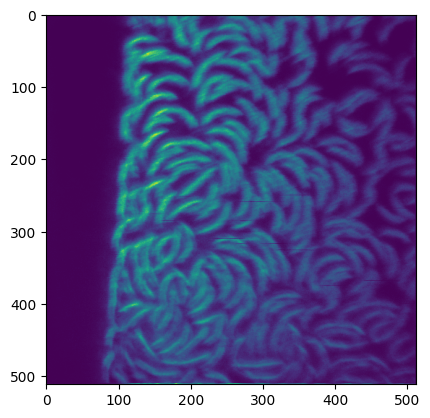

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


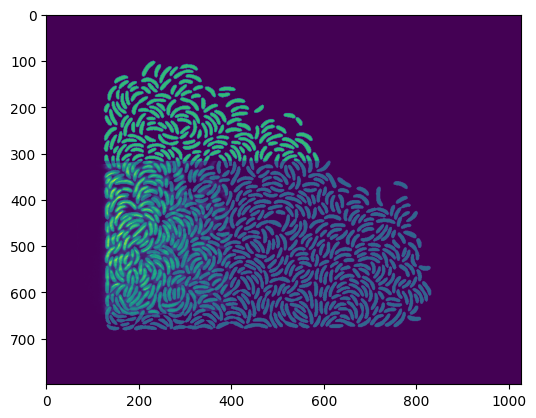

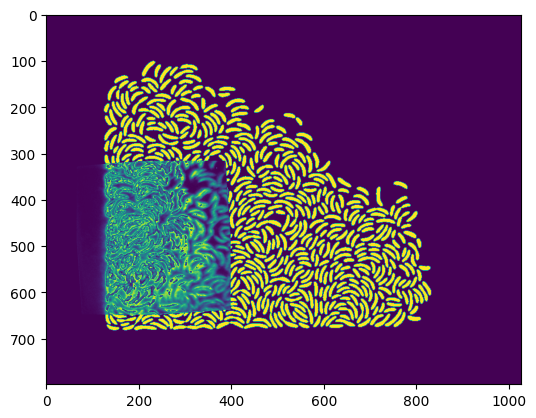

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     4
Scaling                                                   0.65
CrossCorr                                    3803427392.307692
y                                                          317
x                                                           66
Name: 101, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


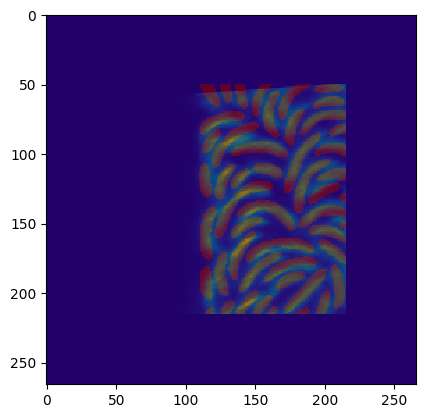

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          762690465.0
y                                                           50
x                                                           50
Name: 137, dtype: object
116 282 367 533
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


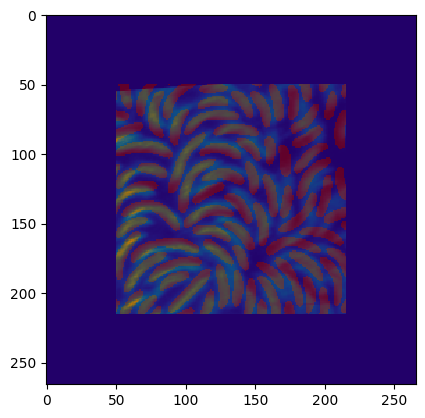

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          967499070.0
y                                                           50
x                                                           50
Name: 137, dtype: object
199 365 367 533
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


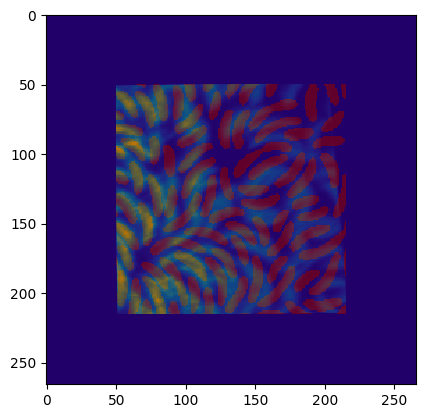

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          494467440.0
y                                                           50
x                                                           50
Name: 148, dtype: object
282 448 367 533
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


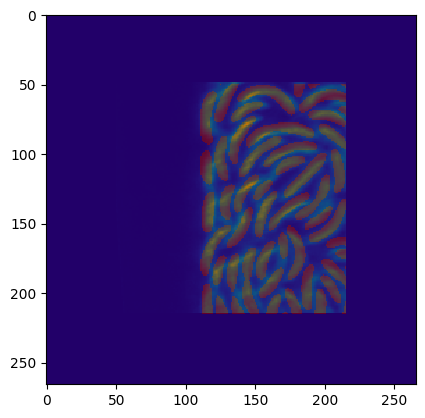

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          798597015.0
y                                                           49
x                                                           50
Name: 137, dtype: object
116 282 449 615
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


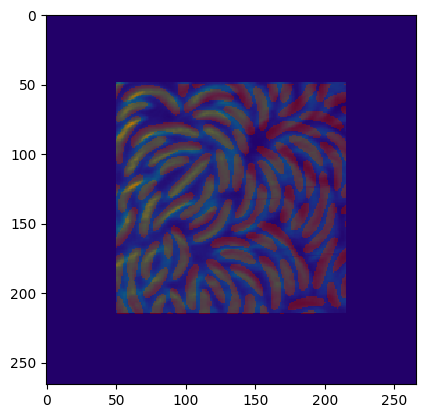

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                         1024396710.0
y                                                           49
x                                                           50
Name: 137, dtype: object
199 365 449 615
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


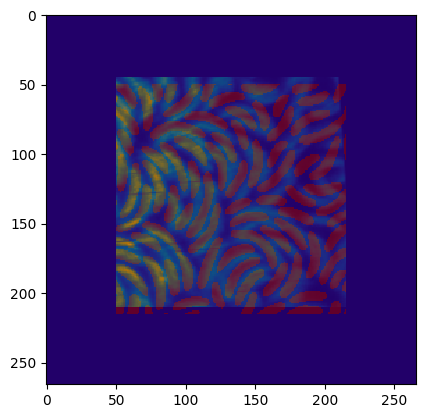

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          580998375.0
y                                                           45
x                                                           50
Name: 137, dtype: object
282 448 445 611
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


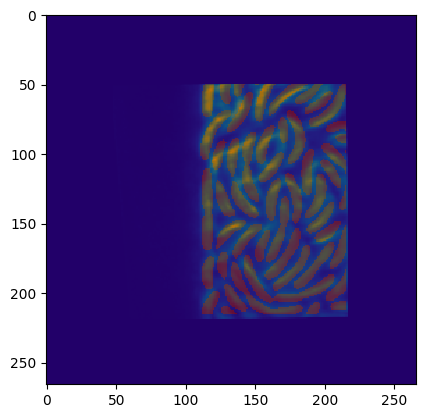

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                   1.02
CrossCorr                                          700640000.0
y                                                           50
x                                                           48
Name: 149, dtype: object
114 280 533 699
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


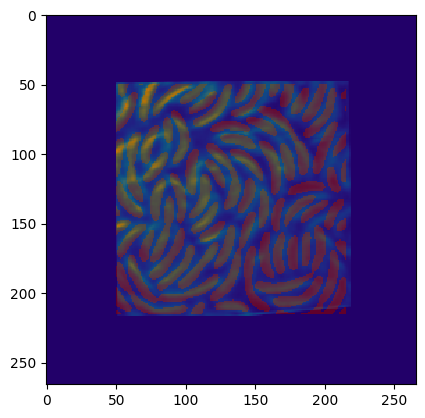

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                   1.02
CrossCorr                                          889029500.0
y                                                           48
x                                                           50
Name: 149, dtype: object
199 365 531 697
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


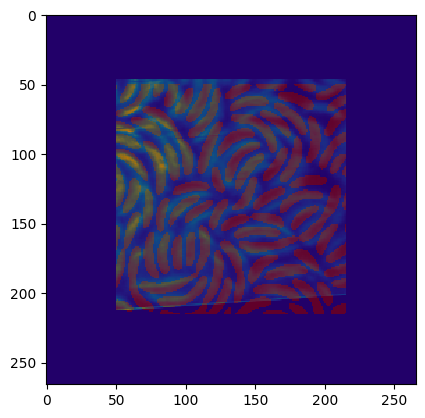

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          534652380.0
y                                                           47
x                                                           50
Name: 137, dtype: object
282 448 530 696
(899, 1127)
(166, 166)


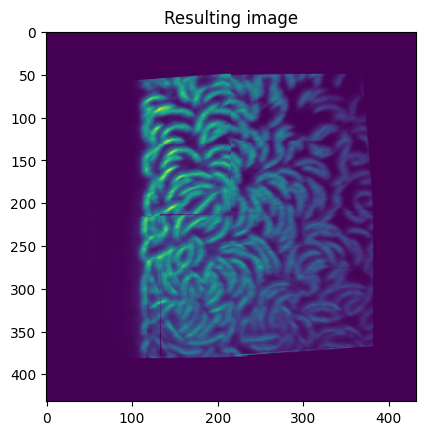

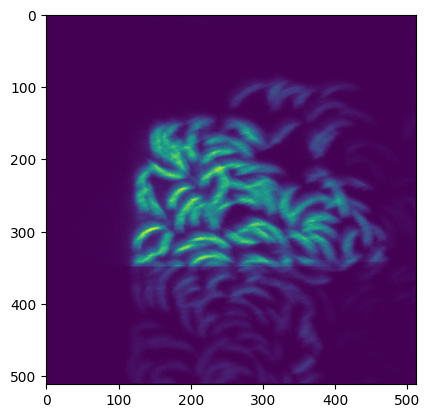

100


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


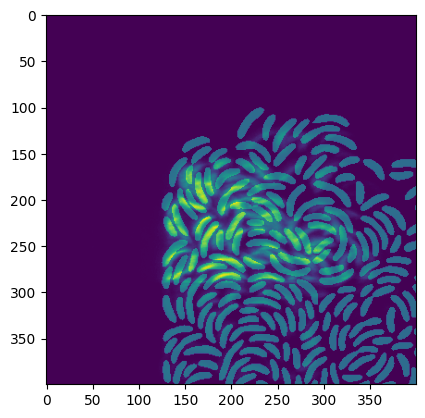

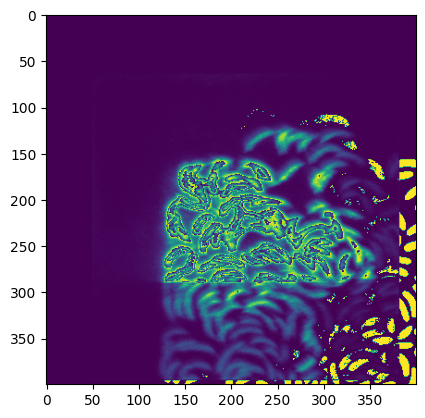

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                    1543243915.384615
y                                                           64
x                                                           50
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


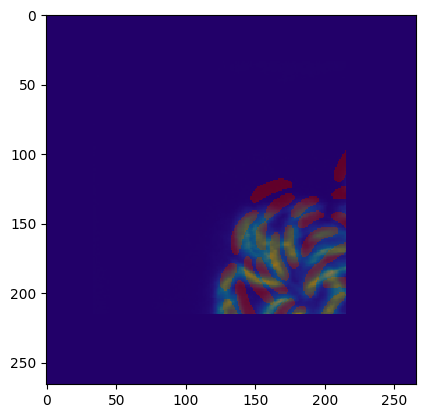

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     250620954.545455
y                                                           34
x                                                           34
Name: 142, dtype: object
84 250 98 264
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


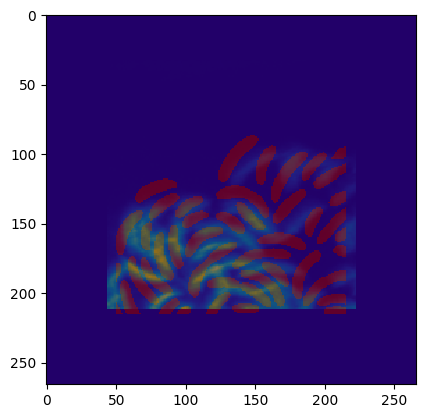

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.08
CrossCorr                                     372819444.444444
y                                                           33
x                                                           44
Name: 141, dtype: object
177 343 97 263
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


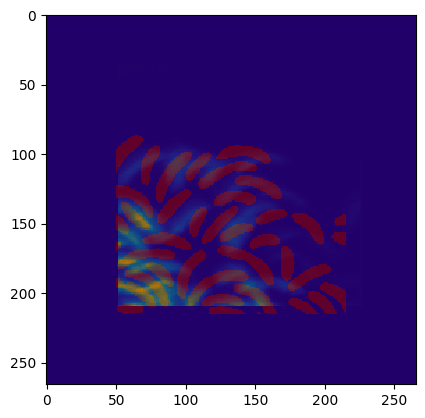

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.06
CrossCorr                                     183369778.301887
y                                                           35
x                                                           52
Name: 140, dtype: object
268 434 99 265
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


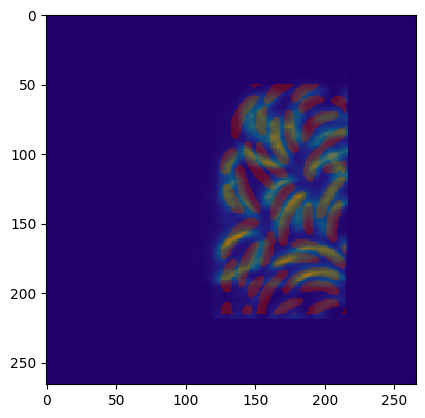

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                   1.08
CrossCorr                                     529474208.333333
y                                                           40
x                                                           38
Name: 130, dtype: object
88 254 187 353
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


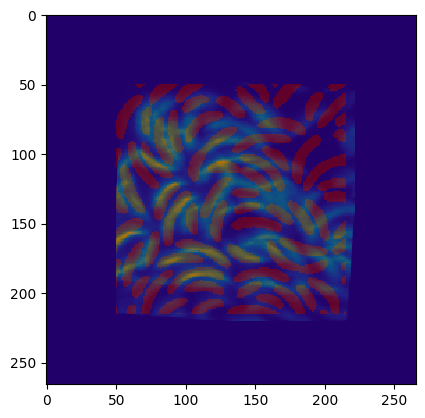

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -4
Scaling                                                   1.04
CrossCorr                                     803640100.961538
y                                                           49
x                                                           50
Name: 95, dtype: object
183 349 196 362
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


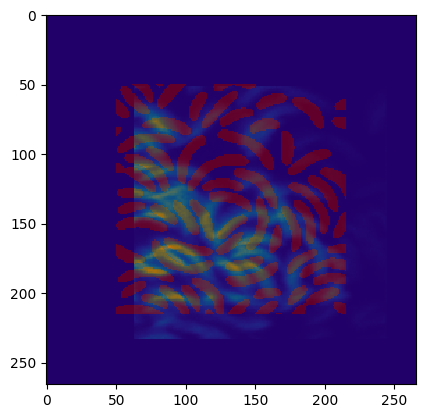

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     427717527.272727
y                                                           52
x                                                           63
Name: 142, dtype: object
279 445 199 365
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


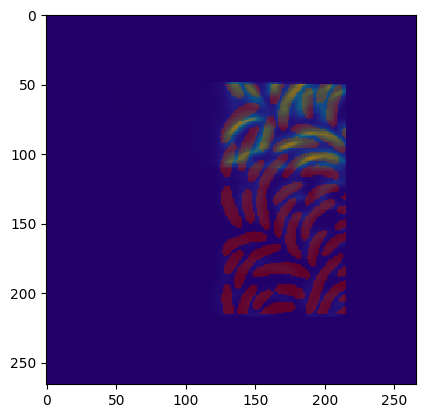

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                   1.02
CrossCorr                                          329149500.0
y                                                           49
x                                                           47
Name: 127, dtype: object
97 263 279 445
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


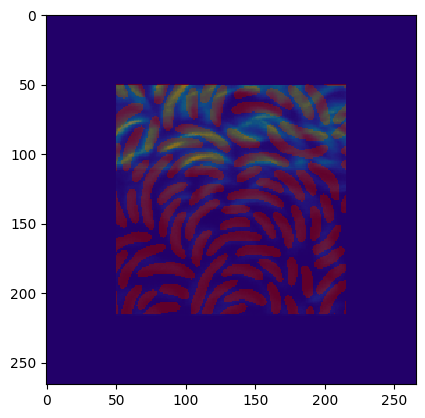

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          527974695.0
y                                                           51
x                                                           50
Name: 137, dtype: object
183 349 281 447
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


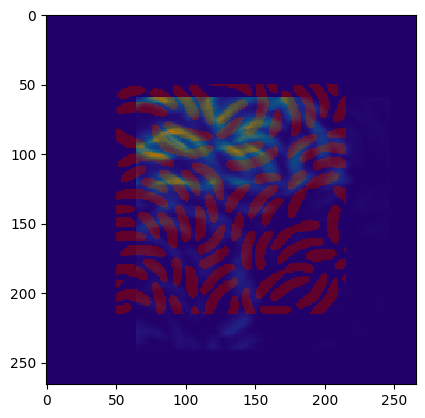

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     318838786.363636
y                                                           60
x                                                           65
Name: 142, dtype: object
281 447 290 456
(899, 1127)
(166, 166)


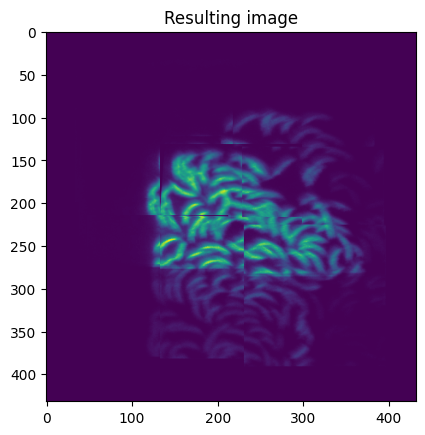

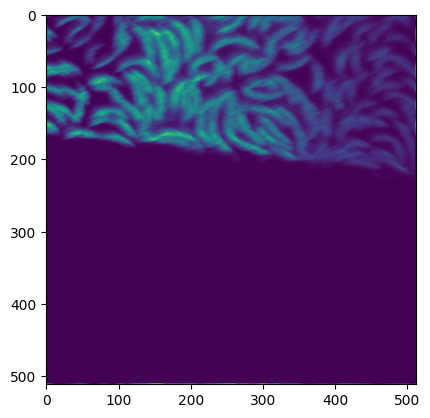

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


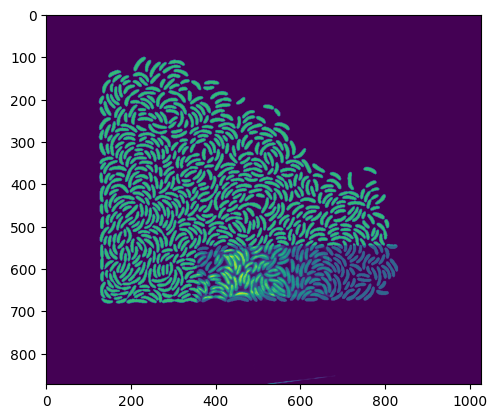

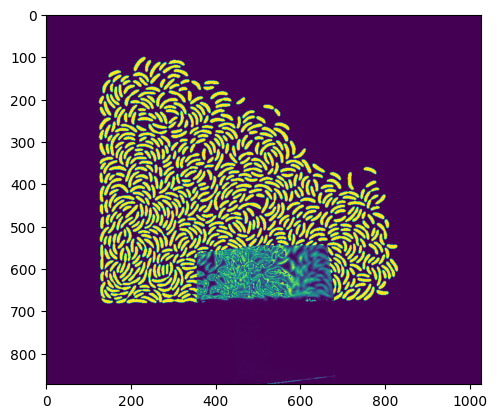

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     7
Scaling                                                   0.64
CrossCorr                                      1707004664.0625
y                                                          546
x                                                          356
Name: 118, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


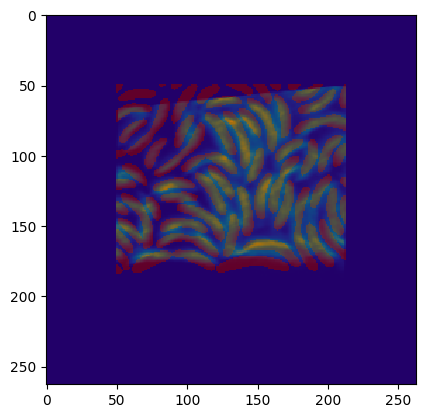

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                    1.0
CrossCorr                                          724978005.0
y                                                           50
x                                                           50
Name: 126, dtype: object
406 569 596 759
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


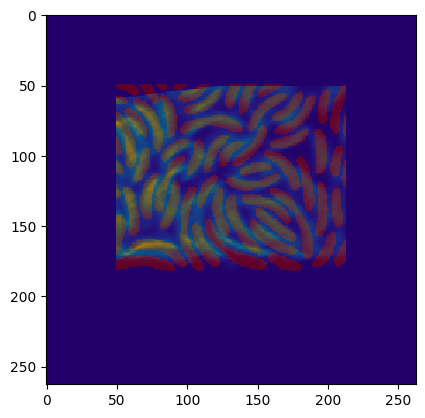

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          683594820.0
y                                                           51
x                                                           50
Name: 137, dtype: object
487 650 597 760
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


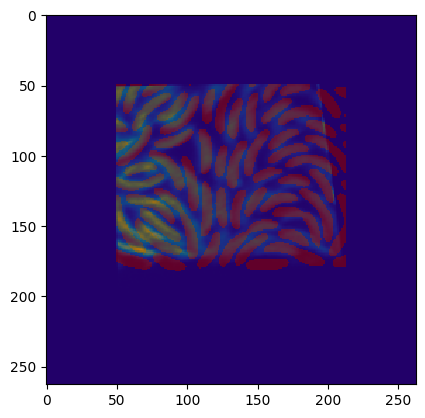

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          369039825.0
y                                                           50
x                                                           50
Name: 148, dtype: object
569 732 596 759
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


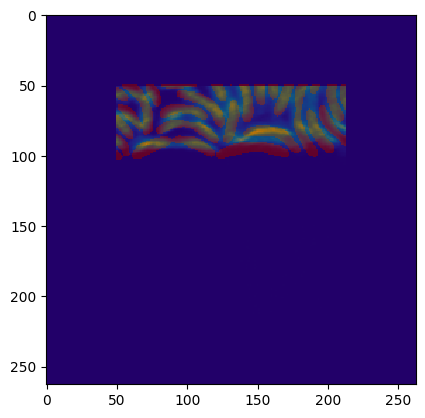

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          304309350.0
y                                                           51
x                                                           50
Name: 137, dtype: object
406 569 678 841
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


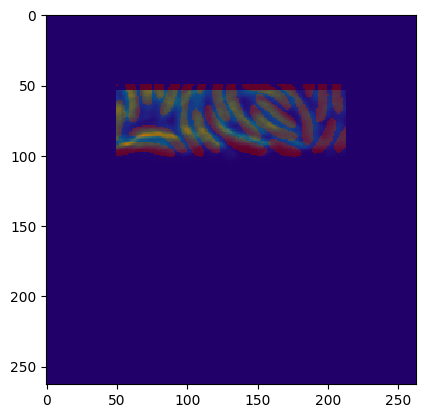

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          269238180.0
y                                                           54
x                                                           50
Name: 137, dtype: object
487 650 681 844
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


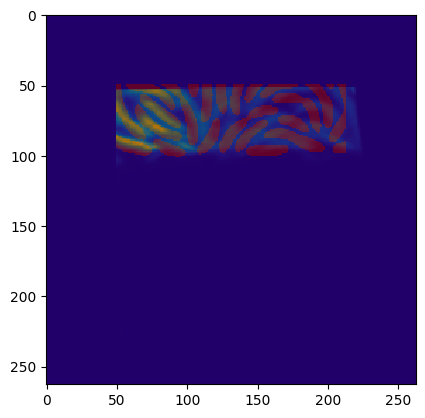

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.1
CrossCorr                                     154673495.454545
y                                                           52
x                                                           50
Name: 153, dtype: object
569 732 679 842
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


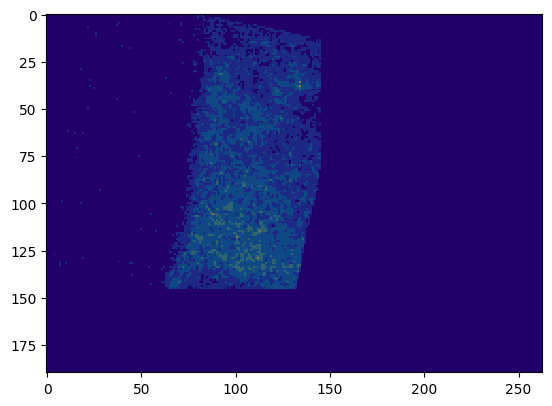

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
356 519 709 872
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


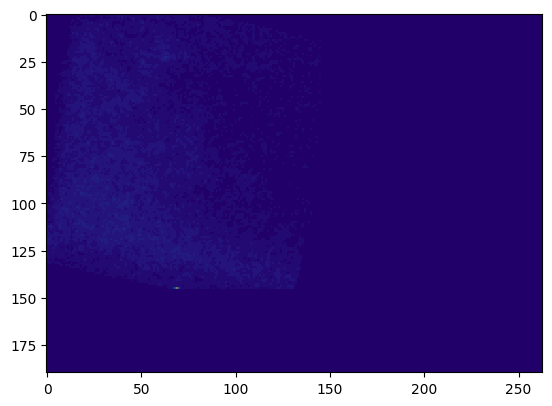

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
437 600 709 872
(899, 1127)
(163, 163)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


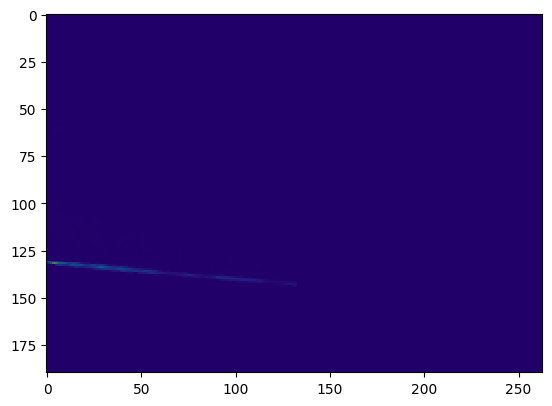

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
519 682 709 872
(899, 1127)
(163, 163)


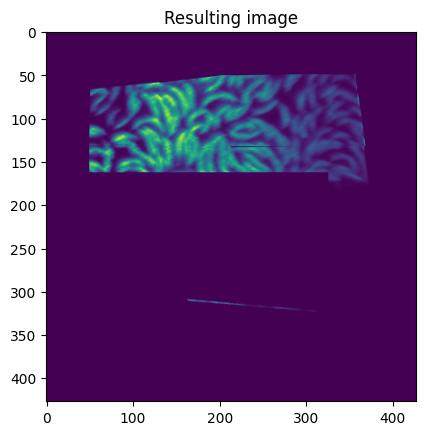

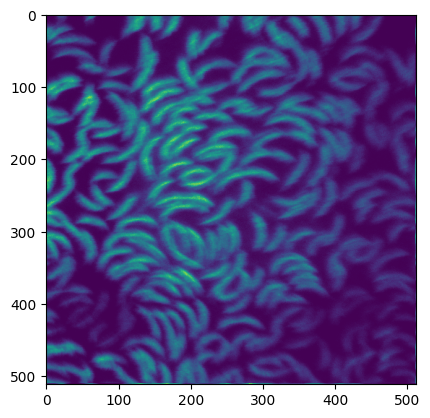

100


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


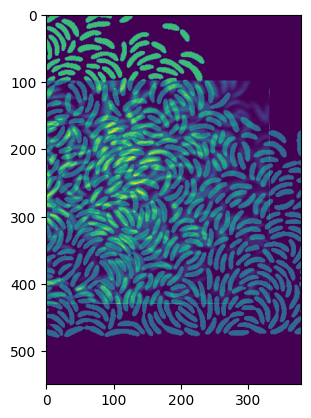

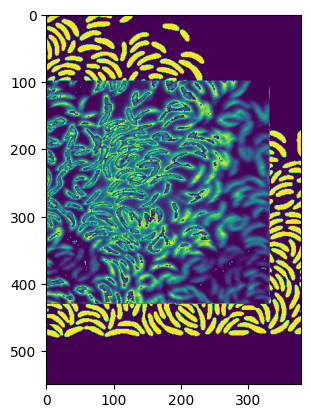

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                    2595266423.076923
y                                                           99
x                                                            0
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


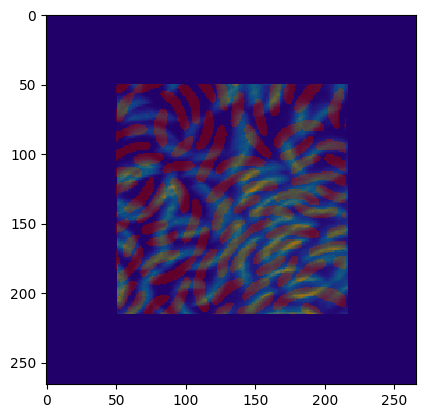

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          587021730.0
y                                                           50
x                                                           51
Name: 137, dtype: object
51 217 149 315
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


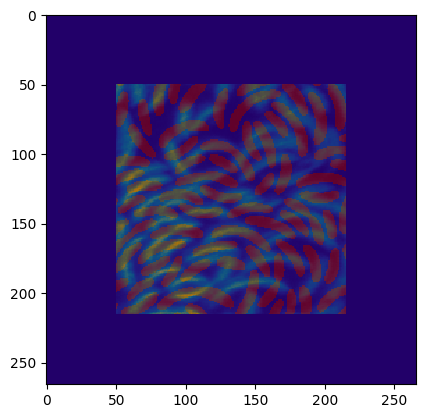

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          603526605.0
y                                                           50
x                                                           50
Name: 137, dtype: object
133 299 149 315
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


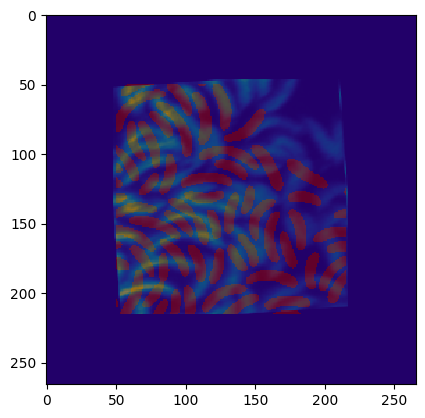

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     4
Scaling                                                   1.02
CrossCorr                                          331971500.0
y                                                           47
x                                                           48
Name: 182, dtype: object
214 380 146 312
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


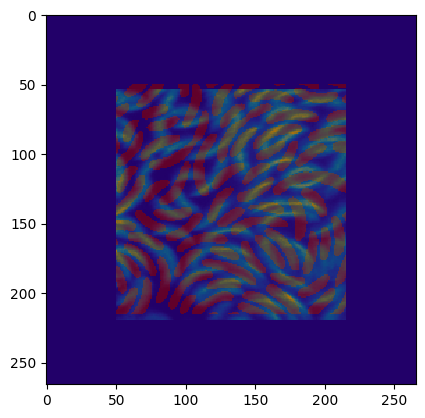

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          692427765.0
y                                                           54
x                                                           50
Name: 137, dtype: object
50 216 236 402
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


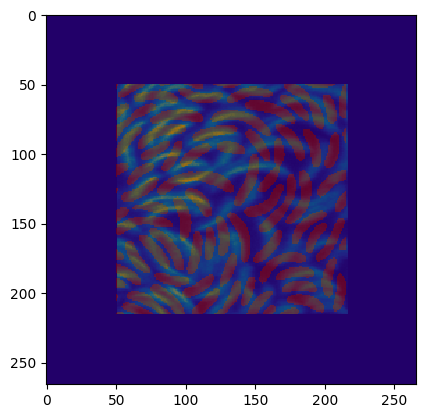

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          650328540.0
y                                                           50
x                                                           51
Name: 137, dtype: object
134 300 232 398
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


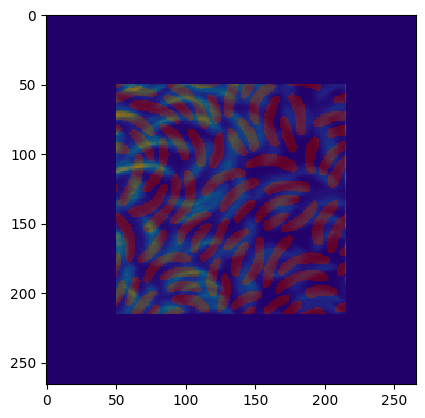

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          358148265.0
y                                                           50
x                                                           50
Name: 137, dtype: object
216 382 232 398
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


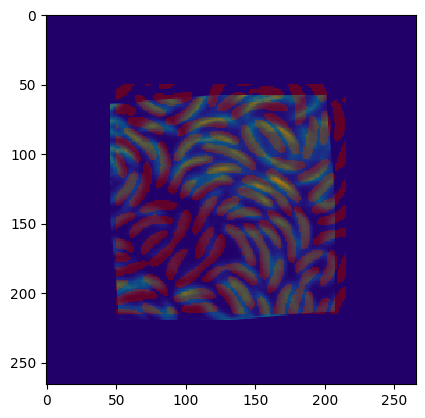

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     5
Scaling                                                   0.98
CrossCorr                                     549966045.918367
y                                                           58
x                                                           46
Name: 191, dtype: object
46 212 323 489
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


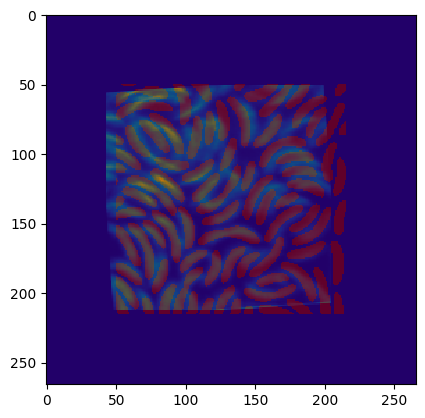

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     4
Scaling                                                   0.98
CrossCorr                                     522543918.367347
y                                                           51
x                                                           43
Name: 180, dtype: object
126 292 316 482
(699, 787)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


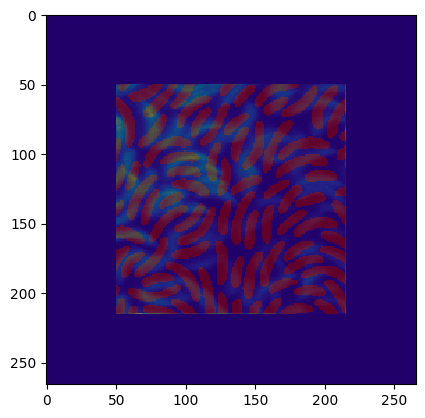

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          262626540.0
y                                                           50
x                                                           50
Name: 137, dtype: object
216 382 315 481
(699, 787)
(166, 166)


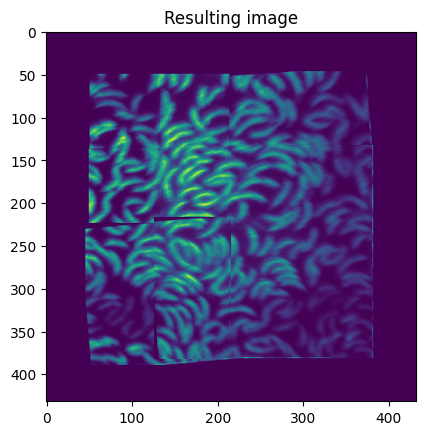

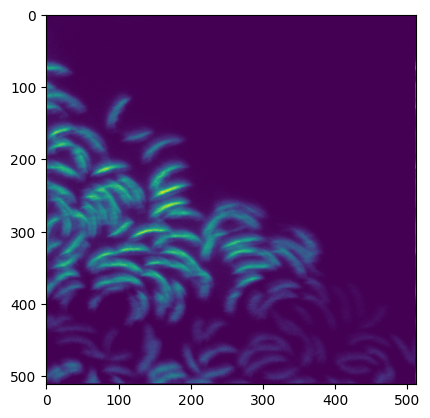

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


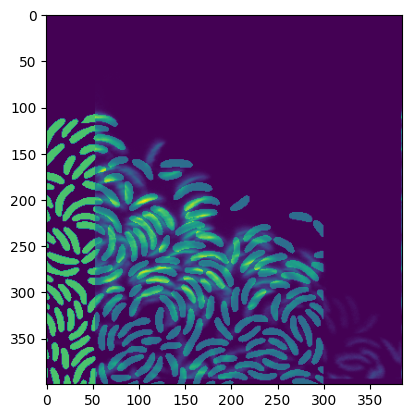

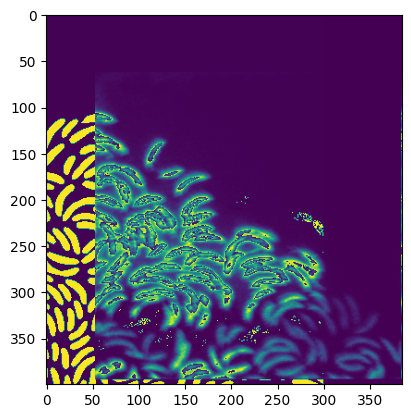

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                    1390284676.923077
y                                                           63
x                                                           53
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


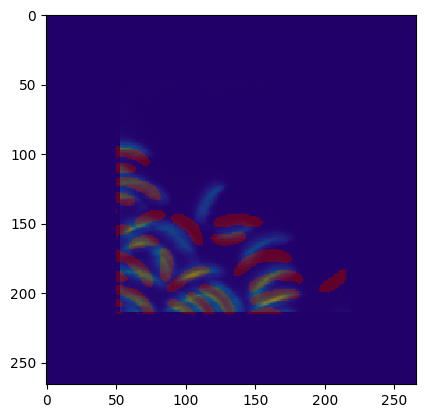

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          242132079.0
y                                                           48
x                                                           53
Name: 137, dtype: object
106 272 111 277
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


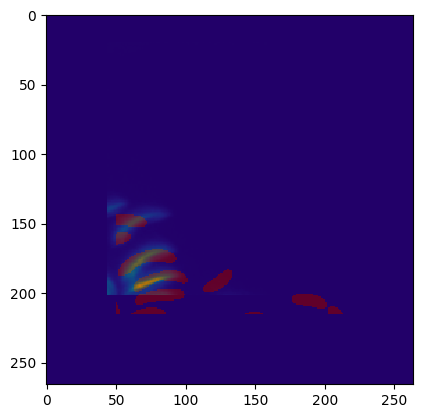

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                           62553400.0
y                                                           20
x                                                           44
Name: 142, dtype: object
180 346 83 249
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


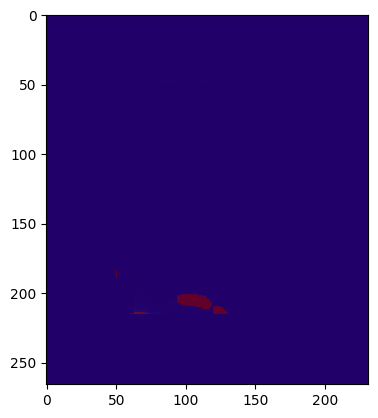

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.02
CrossCorr                                        578882.352941
y                                                           47
x                                                           63
Name: 138, dtype: object
282 448 110 276
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


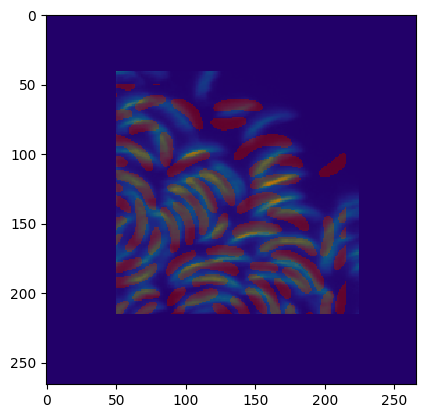

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.06
CrossCorr                                     601993469.811321
y                                                           41
x                                                           50
Name: 140, dtype: object
103 269 187 353
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


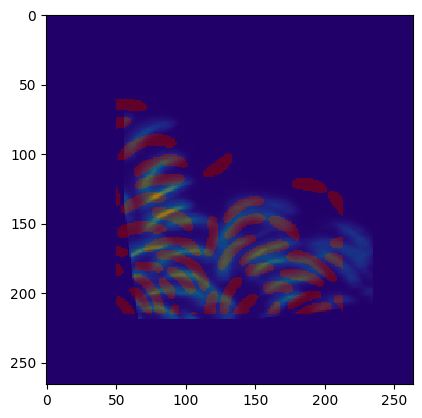

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     7
Scaling                                                   1.08
CrossCorr                                     359328752.777778
y                                                           40
x                                                           56
Name: 218, dtype: object
192 358 186 352
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


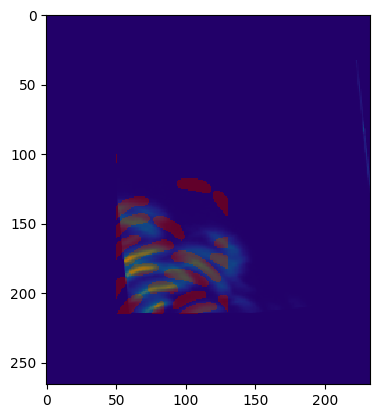

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     6
Scaling                                                    1.1
CrossCorr                                     110635240.909091
y                                                           33
x                                                           51
Name: 208, dtype: object
270 436 179 345
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


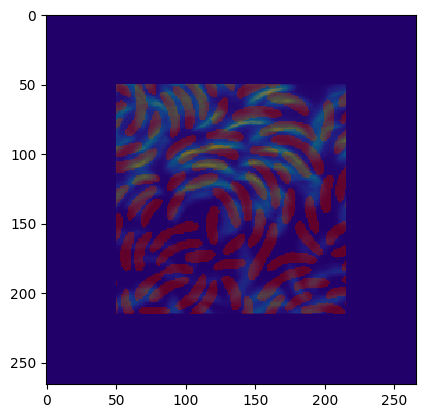

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          512153718.0
y                                                           50
x                                                           50
Name: 137, dtype: object
103 269 279 445
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


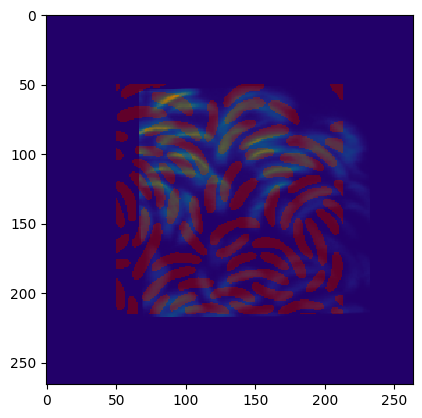

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                          410469451.0
y                                                           52
x                                                           67
Name: 159, dtype: object
203 369 281 447
(899, 877)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


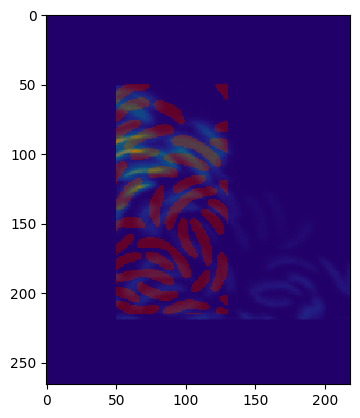

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.02
CrossCorr                                     142000616.666667
y                                                           51
x                                                           50
Name: 138, dtype: object
269 435 280 446
(899, 877)
(166, 166)


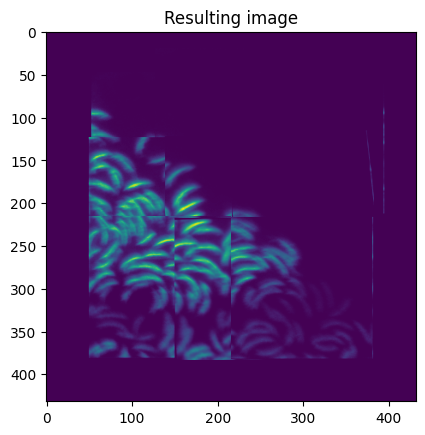

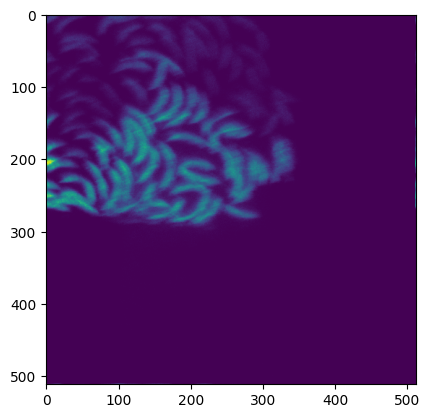

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


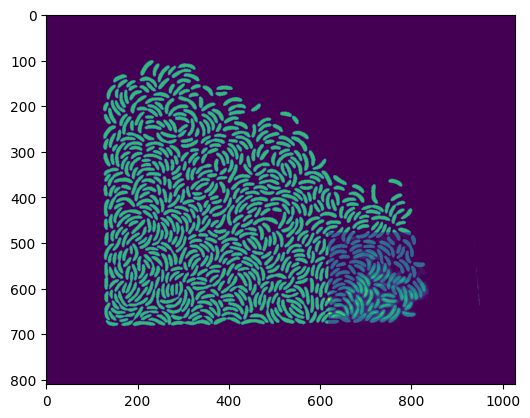

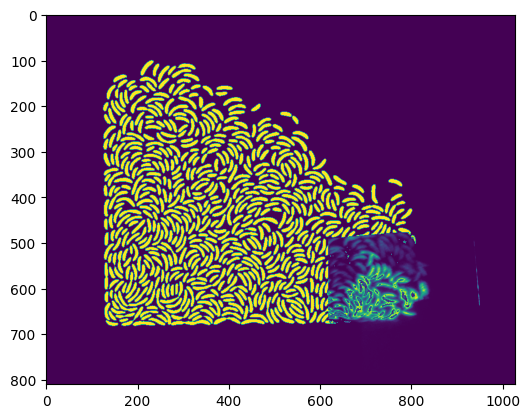

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     5
Scaling                                                   0.65
CrossCorr                                     752353176.923077
y                                                          478
x                                                          618
Name: 107, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


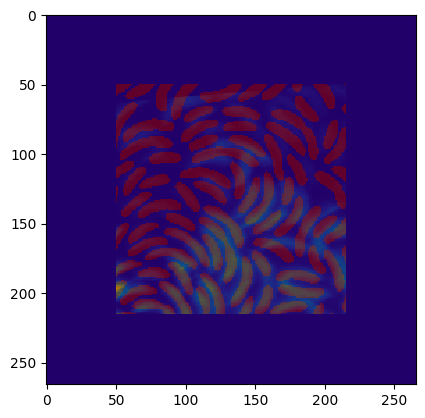

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          311491680.0
y                                                           50
x                                                           50
Name: 137, dtype: object
668 834 528 694
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


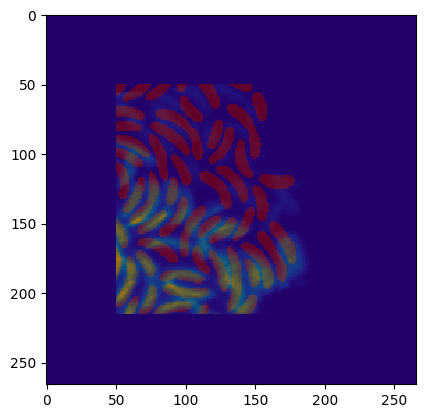

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          228386670.0
y                                                           50
x                                                           50
Name: 137, dtype: object
751 917 528 694
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


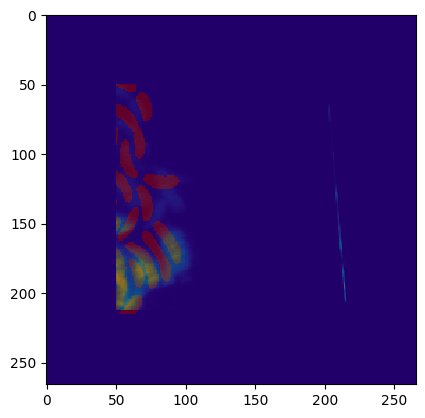

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           57299265.0
y                                                           47
x                                                           50
Name: 137, dtype: object
834 1000 525 691
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


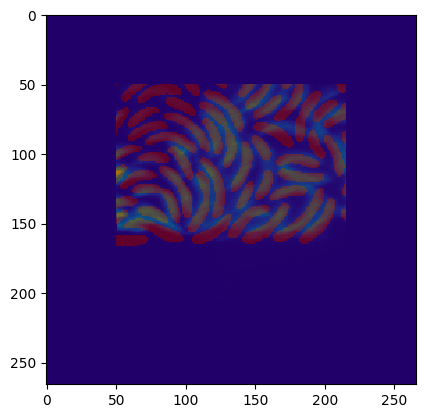

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          370195740.0
y                                                           50
x                                                           50
Name: 137, dtype: object
668 834 611 777
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


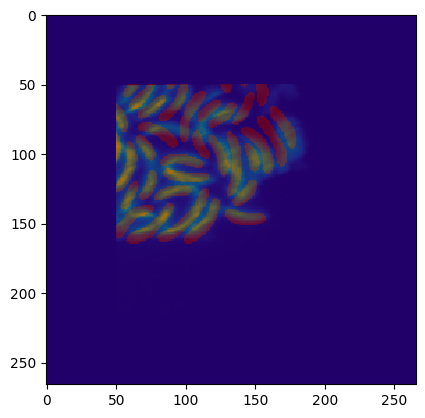

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          256492515.0
y                                                           50
x                                                           50
Name: 148, dtype: object
751 917 611 777
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


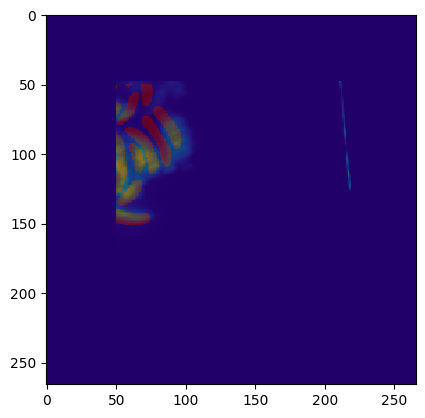

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.02
CrossCorr                                           60184250.0
y                                                           48
x                                                           50
Name: 138, dtype: object
834 1000 609 775
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


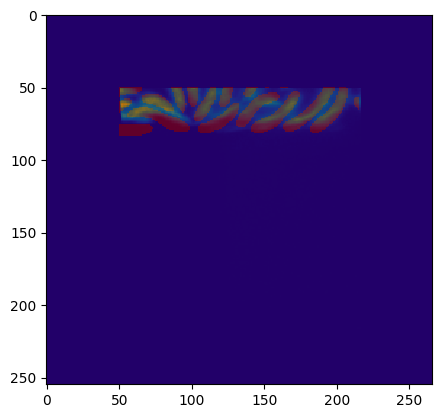

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          114792330.0
y                                                           51
x                                                           51
Name: 137, dtype: object
669 835 695 861
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


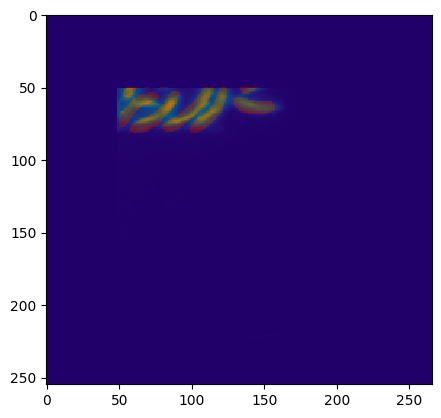

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                           64932562.5
y                                                           51
x                                                           49
Name: 139, dtype: object
750 916 695 861
(899, 1127)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


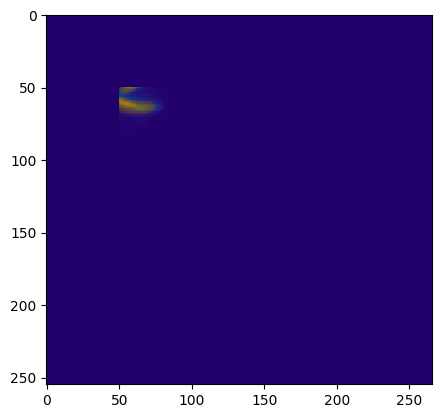

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       8912713.636364
y                                                           50
x                                                           50
Name: 142, dtype: object
834 1000 694 860
(899, 1127)
(166, 166)


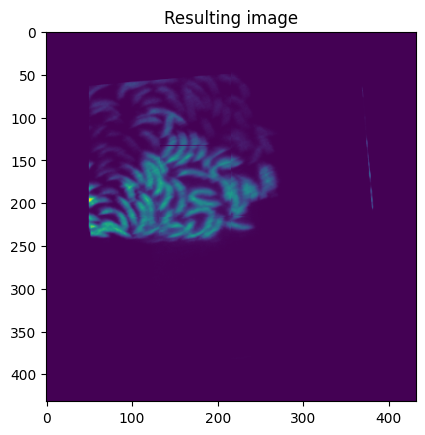

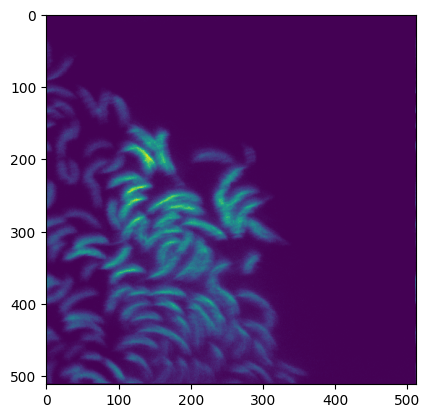

100


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


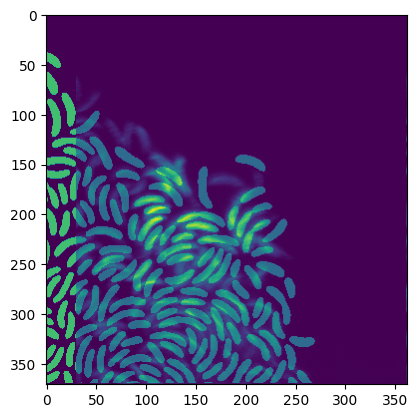

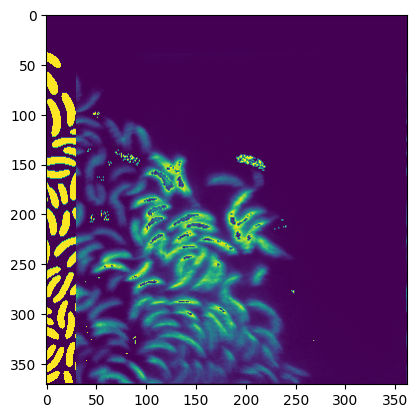

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                          619497000.0
y                                                           39
x                                                           30
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


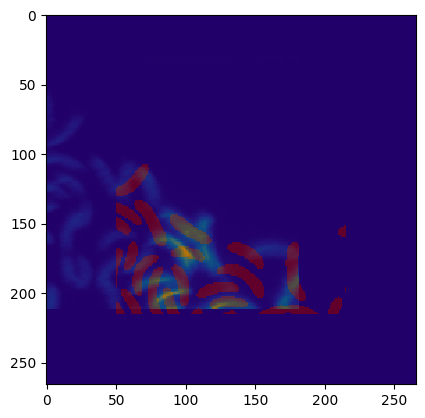

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      73201227.272727
y                                                           30
x                                                            0
Name: 142, dtype: object
30 196 69 235
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


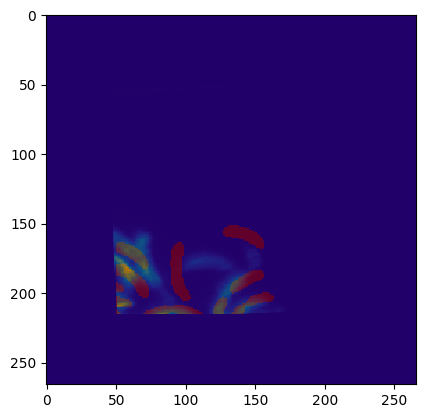

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                    1.0
CrossCorr                                           46387305.0
y                                                           50
x                                                           47
Name: 170, dtype: object
160 326 89 255
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


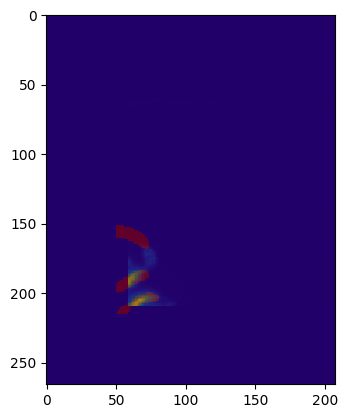

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    0.9
CrossCorr                                            8545050.0
y                                                           61
x                                                           59
Name: 132, dtype: object
255 421 100 266
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


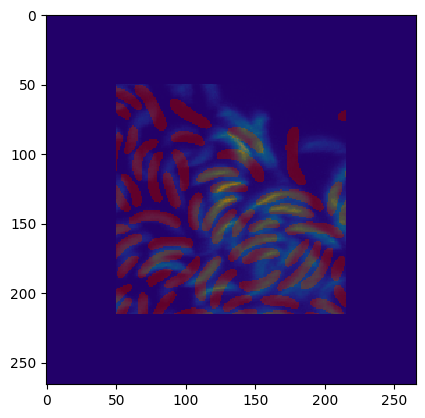

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          236364090.0
y                                                           50
x                                                           50
Name: 137, dtype: object
80 246 172 338
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


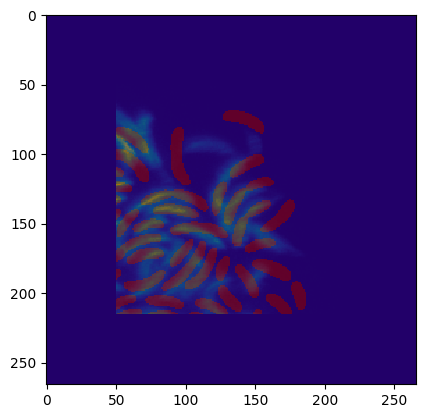

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          174787710.0
y                                                           50
x                                                           50
Name: 137, dtype: object
163 329 172 338
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


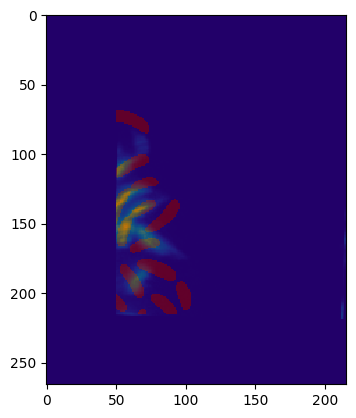

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    1.0
CrossCorr                                           31866840.0
y                                                           53
x                                                           50
Name: 115, dtype: object
246 412 175 341
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


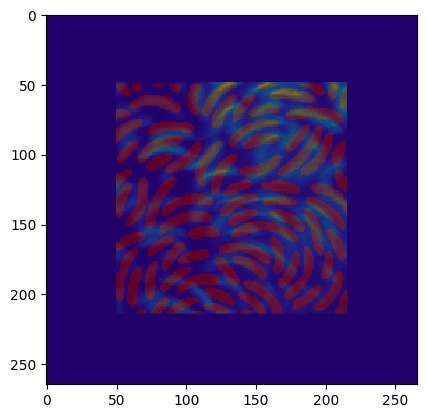

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          274872405.0
y                                                           49
x                                                           50
Name: 137, dtype: object
80 246 254 420
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


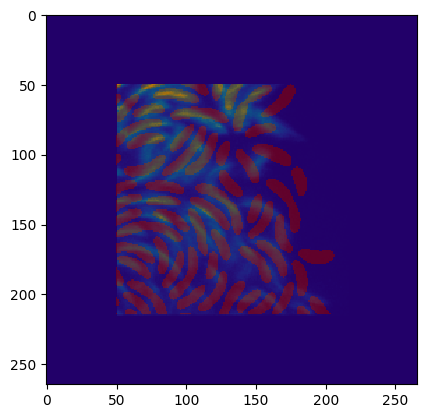

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          229087155.0
y                                                           50
x                                                           51
Name: 137, dtype: object
164 330 255 421
(679, 567)
(166, 166)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


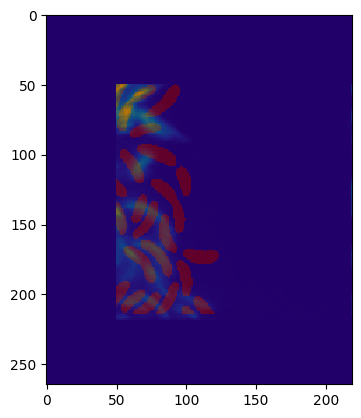

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.02
CrossCorr                                           53058250.0
y                                                           50
x                                                           50
Name: 138, dtype: object
246 412 255 421
(679, 567)
(166, 166)


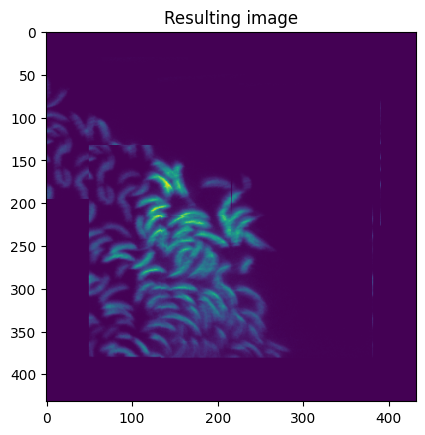

TypeError: Image data of dtype object cannot be converted to float

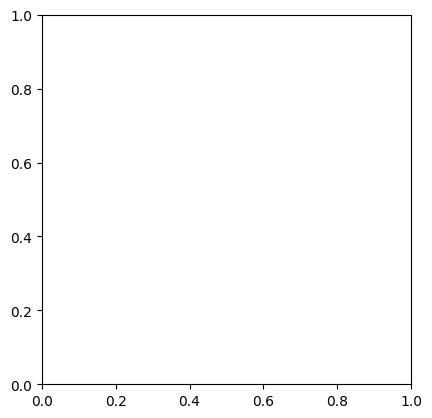

In [7]:
NanoSIMS_channel_8_1 = Image_stitching()


    
NanoSIMS_path_14N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\14N\FW_1108_pos8_chn1_", "-14N12C.tif"]
NanoSIMS_path_15N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\15N\FW_1108_pos8_chn1_", "-15N12C.tif"]
NanoSIMS_path_12C = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\12C\FW_1108_pos8_chn1_", "-12C2.tif"]
MF_mask_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\seg_im_bin\Timelapse_pos8_TxRed_frame049_seg_bin.png"
Results_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Combined"
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\track_output\tracking_strack.h5"
arrangement = [[1, 2, 3], [6, 5, 4], [7, 8, 9]]
arrangement = [[3, 2, 1], [4, 5, 6], [8, 7, "Empty"]]
mode = "overlay" # Choose "onoff" ; "overlay" ; "twochanneloverlay"

res_list_channel_8_1 = NanoSIMS_channel_8_1.create_combined_image(NanoSIMS_path_14N = NanoSIMS_path_14N, NanoSIMS_path_15N = NanoSIMS_path_15N, NanoSIMS_path_12C = NanoSIMS_path_12C, MF_mask_path = MF_mask_path, Results_path = Results_path, h5_path = h5_path, arrangement = arrangement, mode = mode)

In [8]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]

print(len(np.unique(labels)) -1 )

714


In [28]:
## Everything based on 14N 
intensity_map_14N_8_1 = np.array(NanoSIMS_channel_8_1.intensity_map_14N)
intensity_map_14N_8_1_unique = np.array([np.unique(intensity_map_14N_8_1[:,0]),np.array([float(max(intensity_map_14N_8_1[:,1][np.argwhere(intensity_map_14N_8_1[:,0] == index)])) for index in np.unique(intensity_map_14N_8_1[:,0])])]).T
intensity_map_unique_df_8_1 = pd.DataFrame(intensity_map_14N_8_1_unique, columns=("trackID", "14N"))
"""for i in np.unique(intensity_map_14N[:,0]):
    print(intensity_map_14N[np.where(intensity_map_14N[:,0] == i)])"""


intensity_map_15N_8_1 = np.array(NanoSIMS_channel_8_1.intensity_map_15N)
intensity_map_unique_df_8_1["15N"] = np.array([float(max(intensity_map_15N_8_1[:,1][np.argwhere(intensity_map_14N_8_1[:,0] == index)])) for index in np.unique(intensity_map_14N_8_1[:,0])])
"""for i in np.unique(intensity_map_15N[:,0]):
    print(intensity_map_15N[np.where(intensity_map_15N[:,0] == i)])"""


intensity_map_12C_8_1 = np.array(NanoSIMS_channel_8_1.intensity_map_12C)
intensity_map_unique_df_8_1["12C"] = np.array([float(max(intensity_map_12C_8_1[:,1][np.argwhere(intensity_map_14N_8_1[:,0] == index)])) for index in np.unique(intensity_map_14N_8_1[:,0])])
"""for i in np.unique(intensity_map_12C[:,0]):
    print(intensity_map_12C[np.where(intensity_map_12C[:,0] == i)])"""

intensity_map_unique_df_8_1["total_N"] =  (intensity_map_unique_df_8_1["15N"] + intensity_map_unique_df_8_1["14N"])
intensity_map_unique_df_8_1["15N_to_total_N"] = intensity_map_unique_df_8_1["15N"] / intensity_map_unique_df_8_1["total_N"]
intensity_map_unique_df_8_1["15N_to_14N"] = intensity_map_unique_df_8_1["15N"] / intensity_map_unique_df_8_1["14N"]
intensity_map_unique_df_8_1["total_N_to_12C"] = intensity_map_unique_df_8_1["total_N"] /intensity_map_unique_df_8_1["12C"] 


growth_df_8_1 = pd.read_csv(r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\track_output\analyzed\Chamber8_1-growth_rates_lineage_biomass_benny.csv") #Chamber_8_1-growth_rates_lineage
growth_df_8_1 = growth_df_8_1[["trackID", "cell_area", "biomass_gain", "division_events"]]#, "growth_rate_lineage"]]

data_df_8_1 = pd.merge(intensity_map_unique_df_8_1, growth_df_8_1, on="trackID")
#data_df = data_df[["15N_to_total","growth_rate_lineage"]]

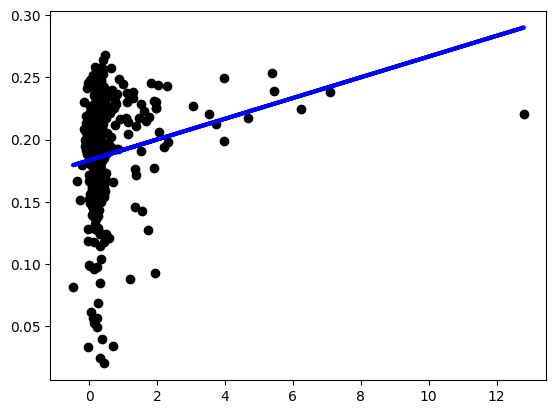

In [10]:
y = data_df_8_1["15N_to_total_N"]
x = data_df_8_1["biomass_gain"]
#x = (np.exp(data_df_8_1["growth_rate_lineage"] * 10/12) - 1) * 100
y = y[np.isfinite(x)]
x = x[np.isfinite(x)]
z = np.polyfit(x, y, deg=1)
#print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)

In [34]:
np.linspace(0,10,100)

array([ 0.        ,  0.1010101 ,  0.2020202 ,  0.3030303 ,  0.4040404 ,
        0.50505051,  0.60606061,  0.70707071,  0.80808081,  0.90909091,
        1.01010101,  1.11111111,  1.21212121,  1.31313131,  1.41414141,
        1.51515152,  1.61616162,  1.71717172,  1.81818182,  1.91919192,
        2.02020202,  2.12121212,  2.22222222,  2.32323232,  2.42424242,
        2.52525253,  2.62626263,  2.72727273,  2.82828283,  2.92929293,
        3.03030303,  3.13131313,  3.23232323,  3.33333333,  3.43434343,
        3.53535354,  3.63636364,  3.73737374,  3.83838384,  3.93939394,
        4.04040404,  4.14141414,  4.24242424,  4.34343434,  4.44444444,
        4.54545455,  4.64646465,  4.74747475,  4.84848485,  4.94949495,
        5.05050505,  5.15151515,  5.25252525,  5.35353535,  5.45454545,
        5.55555556,  5.65656566,  5.75757576,  5.85858586,  5.95959596,
        6.06060606,  6.16161616,  6.26262626,  6.36363636,  6.46464646,
        6.56565657,  6.66666667,  6.76767677,  6.86868687,  6.96

In [44]:
data_df_8_1

,trackID,14N,15N,12C,total_N,15N_to_total_N,15N_to_14N,total_N_to_12C,cell_area,biomass_gain,division_events
0,25.0,1.073059,0.109589,0.726027,1.182648,0.092664,0.102128,1.628931,17.485,1.952000,1.0
1,34.0,1.818966,0.301724,0.625000,2.120690,0.142276,0.165877,3.393103,16.315,1.550459,1.0
2,59.0,56.111888,13.776224,21.185315,69.888112,0.197118,0.245513,3.298894,9.555,0.541096,1.0
3,76.0,223.810256,70.671795,55.902564,294.482051,0.239987,0.315767,5.267774,16.315,0.278146,0.0
4,77.0,94.582143,28.932143,25.578571,123.514286,0.234241,0.305894,4.828819,15.015,0.168142,0.0
...,...,...,...,...,...,...,...,...,...,...,...
382,2290.0,64.550000,18.375000,22.205000,82.925000,0.221586,0.284663,3.734519,10.010,0.108504,1.0
383,2318.0,285.314815,89.777778,35.717593,375.092593,0.239348,0.314662,10.501620,10.595,0.444015,1.0
384,2376.0,85.488789,27.017937,22.686099,112.506726,0.240145,0.316041,4.959280,14.755,0.661654,1.0
385,2439.0,1.045161,0.070968,0.361290,1.116129,0.063584,0.067901,3.089286,11.115,NaN,NaN


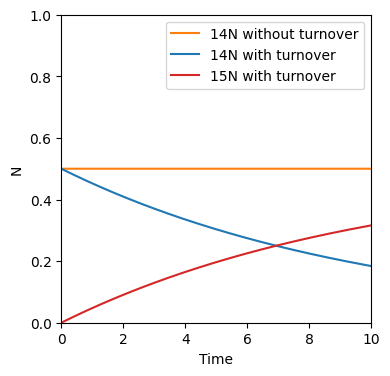

In [29]:
### Comparing theoretical models
turnover = 0.2
turnover_noise = np.random.normal(0.2, 0.01, 2000)

y_theo = np.linspace(0, 1, 2000)
y_theo_turnover = np.linspace(0.2, -0.5, 2000)
x_theo = y_theo 

#Basics
x_time = np.linspace(0, 10, 2000)

def N14_turnover(t, N14_0, tau):
    return N14_0 * np.exp(-tau * t)

def N15_turnover(t, N14_0, tau):
    return N14_0 * (1 - np.exp(-tau * t))

def N15_cto_N14_growth_and_turnover(t, N14_0, tau, mu):
    return N14_0 * (1 - np.exp(-tau * t))

def Biomass(t, B0, mu):
    return B0 * np.exp(mu * t)

plt.figure(figsize=(4,4))
if 0:
    
    plt.plot(x_theo, y_theo, color = "tab:orange", label = "Growth Model")
    plt.plot(x_theo, y_theo + turnover_noise, color = "tab:red", label = "Growth Model with random-Gaussian turnover")
    plt.plot(x_theo, y_theo + turnover, color = "tab:blue", label = "Growth Model with uniform turnover")
    

### Exotic 
if 0: 
    plt.plot(x_theo, y_theo, color = "tab:orange", label = "Growth Model")
    plt.plot(x_theo, y_theo_turnover, color = "tab:blue", label = "Turnover model")
    plt.plot(x_theo, y_theo + y_theo_turnover, color = "tab:red", label = "Anti-correlation; combined")

### Basic growth
if 0: 
    plt.plot(x_theo, [0.5]*2000, color = "tab:orange", label = "14N")
    plt.plot(x_theo, y_theo, color = "tab:blue", label = "15N")
    plt.plot(x_theo, y_theo/0.5, color = "tab:red", label = "15N/14N")

    plt.ylim(0, 1)
    plt.xlim(0, 1)

### Basic turnover


plt.plot(x_time, np.array([0.5]*2000) * np.exp(-0.1*x_time), color = "tab:blue", label = "14N with turnover")
plt.plot(x_time, np.array([0.5]*2000) * (1 - np.exp(-0.1*x_time)), color = "tab:red", label = "15N with turnover")
plt.plot(x_time, [0.5]*2000, color = "tab:orange", label = "15N/14N without turnover")


plt.ylim(0, 1)
plt.xlim(0, 10)



plt.ylabel("N")
plt.xlabel("Time")
plt.legend()
plt.savefig('Growth_Model.png', transparent=True)

Bacteria before the filter: 387
 Bacteria before the filter: 314


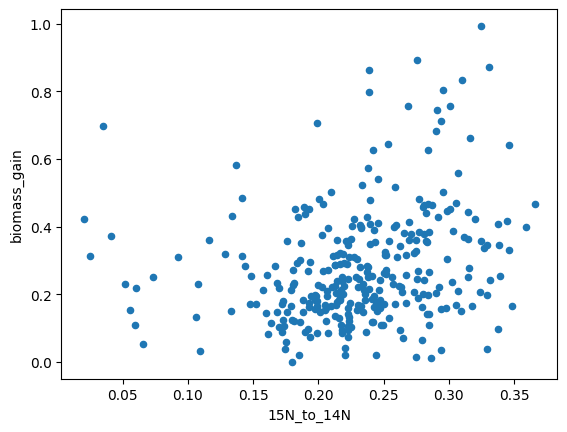

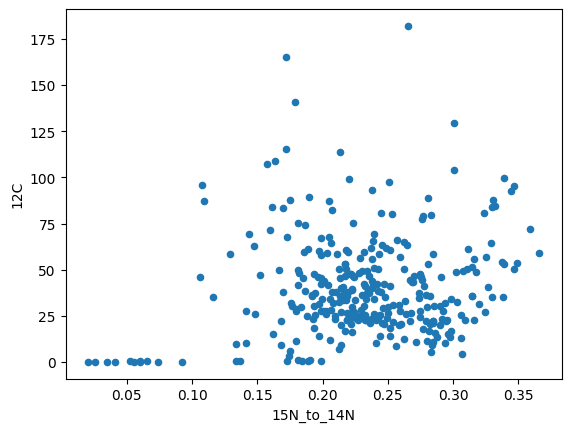

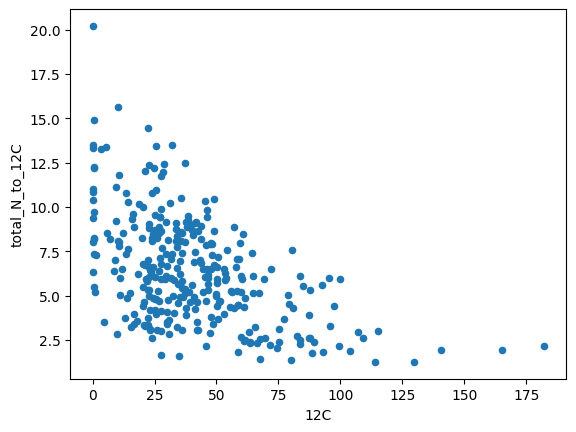

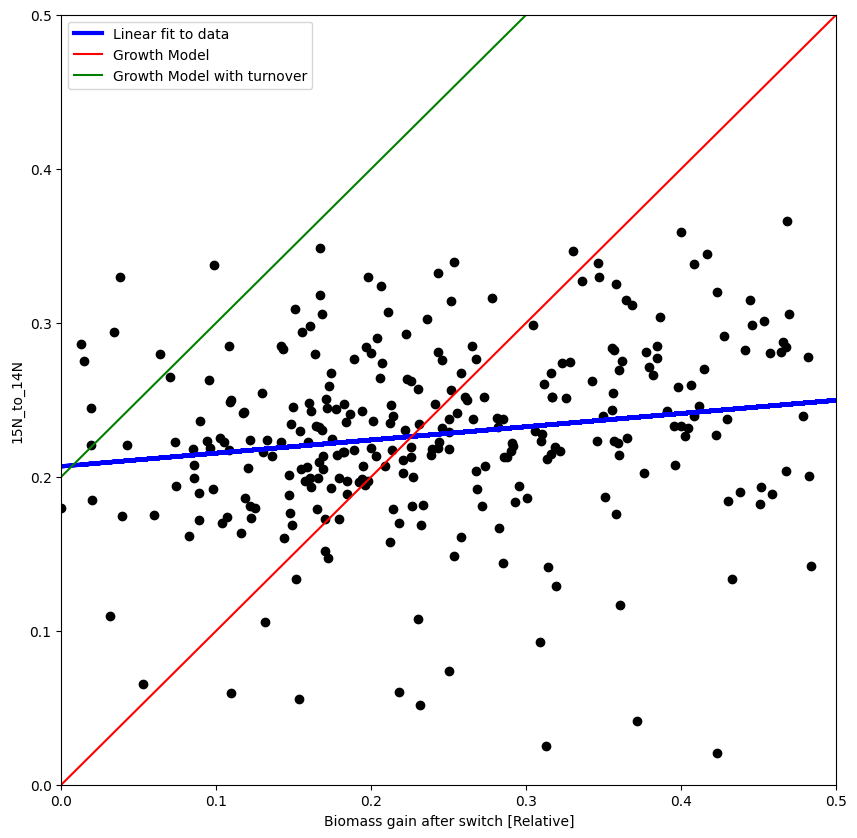

Linear fit values  
0.08583 x + 0.2067
0.0036496041097375874
0.02945049244516625
[[0.00366126 0.00253592]
 [0.00253592 0.02954458]]


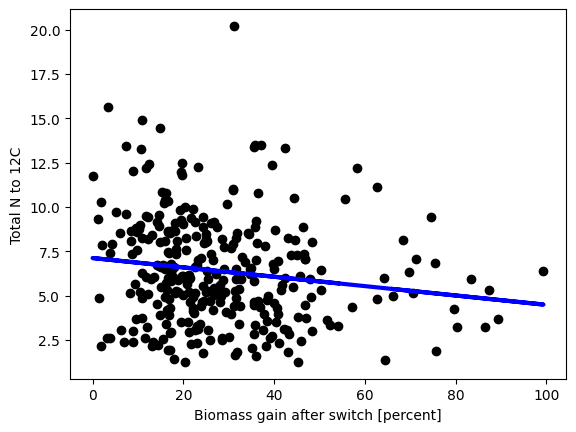

Could be interesting, because protein density is higher in slow growing cells than in fast growing cells


In [50]:
data_df_crop_8_1 = data_df_8_1.     loc[data_df_8_1     ["14N"]                 >= 0] #60
data_df_crop_8_1 = data_df_crop_8_1.loc[data_df_crop_8_1["15N_to_total_N"]      >= 0.0]
data_df_crop_8_1 = data_df_crop_8_1.loc[data_df_crop_8_1["biomass_gain"] <= 1.0]
data_df_crop_8_1 = data_df_crop_8_1.loc[data_df_crop_8_1["biomass_gain"] >= 0.0]

print("Bacteria before the filter: " + str(len(data_df_8_1["14N"])) + "\n", 
      "Bacteria before the filter: " + str(len(data_df_crop_8_1["14N"])))

data_df_crop_8_1.plot.scatter("15N_to_14N", "biomass_gain")
plt.show()

data_df_crop_8_1.plot.scatter("15N_to_14N", "12C")
plt.show()

data_df_crop_8_1.plot.scatter("12C", "total_N_to_12C")
plt.show()
data_df_crop_8_1.corr(method="spearman")


y = data_df_crop_8_1["15N_to_14N"] #(data_df_crop_8_1["14N"] + data_df_crop_8_1["15N"]) / data_df_crop_8_1["14N"] #
x = data_df_crop_8_1["biomass_gain"]  #(np.exp(data_df_crop_8_1["growth_rate_lineage"] * 10/12) - 1) * 100
y_theo = np.linspace(0, 1, 20)
x_theo = y_theo 
z = np.polyfit(x, y, deg=1)
#print(z)
p = np.poly1d(z)

plt.figure(figsize=(10,10))

plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3 , label = "Linear fit to data")
plt.plot(x_theo, y_theo, color = "red", label = "Growth Model")
plt.plot(x_theo, y_theo + 0.2, color = "green", label = "Growth Model with turnover")
plt.ylim(0, 0.5)
plt.xlim(0, 0.5)

plt.ylabel("15N_to_14N")
plt.xlabel("Biomass gain after switch [Relative]")
plt.legend()
plt.show()

print("Linear fit values", p)
print(np.var(y))
print(np.var(x))
print(np.cov(y,x))



y = data_df_crop_8_1["total_N_to_12C"]
x = data_df_crop_8_1["biomass_gain"] * 100 #(np.exp(data_df_crop_8_1["growth_rate_lineage"] * 10/12) - 1) * 100


z = np.polyfit(x, y, deg=1)
#print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3, label = "Linear fit")
plt.ylabel("Total N to 12C")
plt.xlabel("Biomass gain after switch [percent]")
plt.show()

print("Could be interesting, because protein density is higher in slow growing cells than in fast growing cells")


In [36]:
p

poly1d([-0.02208274,  6.84065949])

714


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


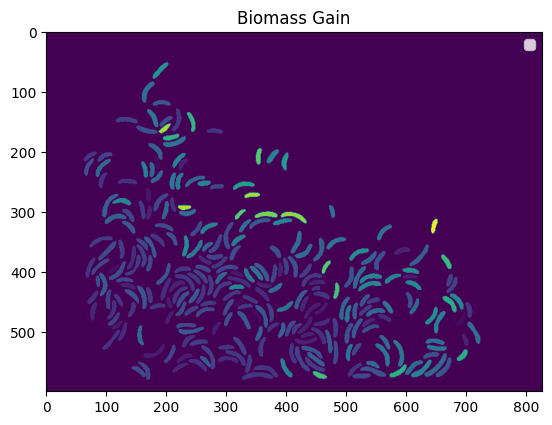

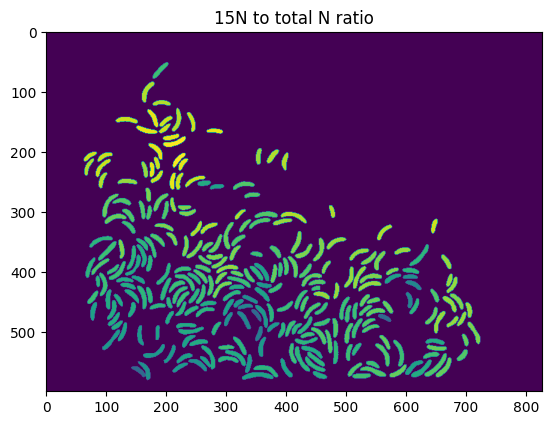

In [12]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber8_1\Growth\pos8\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]
biomass_gain_segmentation = labels.copy()
N15_total_N_ratio = labels.copy()
non_tracked_cells = np.unique(labels)[np.in1d(np.unique(labels), data_df_crop_8_1["trackID"], invert=True)]
print(len(np.unique(labels)) -1 )
for trackID in data_df_crop_8_1["trackID"].values: 
    biomass_gain_segmentation[labels == int(trackID)] = data_df_crop_8_1[data_df_crop_8_1["trackID"] == trackID]["biomass_gain"].values[0] * 100
    N15_total_N_ratio[labels == int(trackID)] = data_df_crop_8_1[data_df_crop_8_1["trackID"] == trackID]["15N_to_total_N"].values[0] * 100


for trackID in non_tracked_cells:
    biomass_gain_segmentation[labels == int(trackID)] = 0
    N15_total_N_ratio[labels == int(trackID)] = 0

plt.imshow(biomass_gain_segmentation)
plt.title("Biomass Gain")
plt.legend()
plt.show()
plt.imshow(N15_total_N_ratio)
plt.title("15N to total N ratio")
plt.show()

################# Channel 11_1 ##################

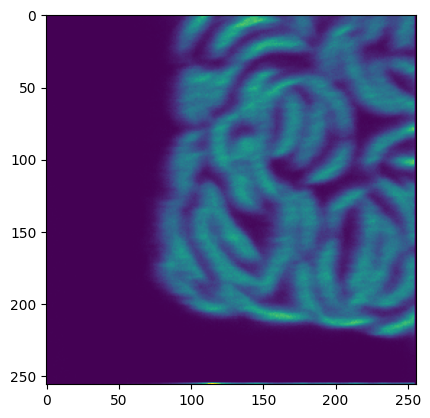

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


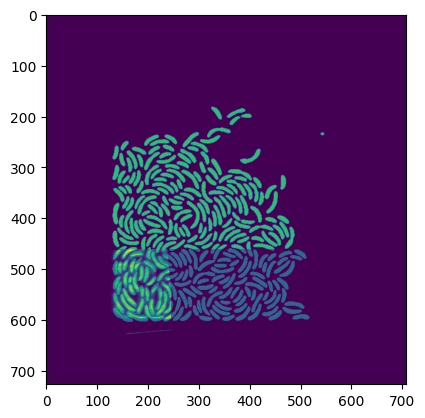

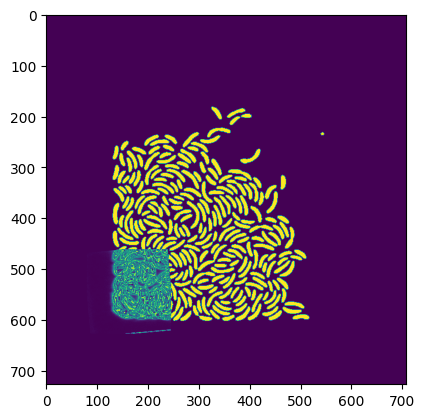

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     5
Scaling                                                   0.65
CrossCorr                                     1553150861.53846
y                                                          462
x                                                           80
Name: 107, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


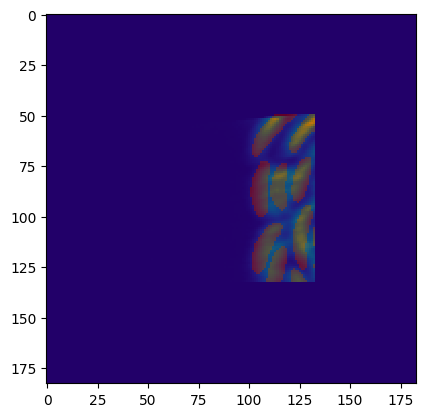

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          161842890.0
y                                                           50
x                                                           50
Name: 175, dtype: object
130 213 512 595
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


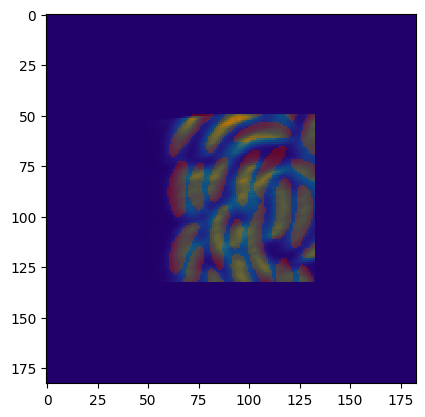

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          401274630.0
y                                                           50
x                                                           50
Name: 175, dtype: object
171 254 512 595
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


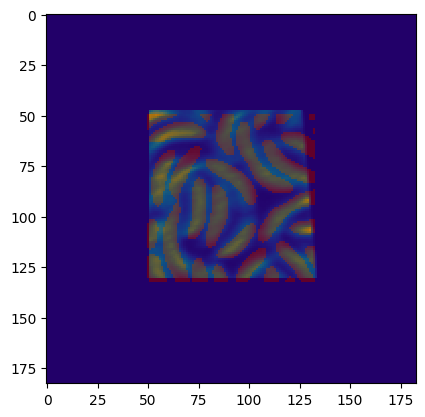

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          418904055.0
y                                                           48
x                                                           51
Name: 175, dtype: object
214 297 510 593
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


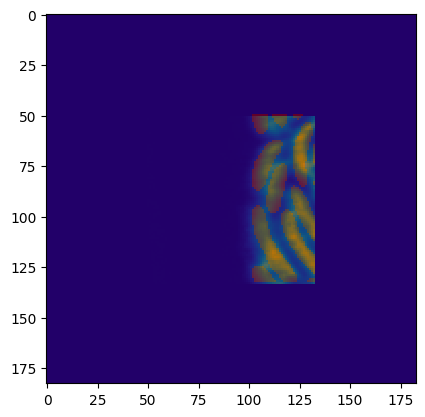

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          177357345.0
y                                                           51
x                                                           50
Name: 175, dtype: object
130 213 554 637
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


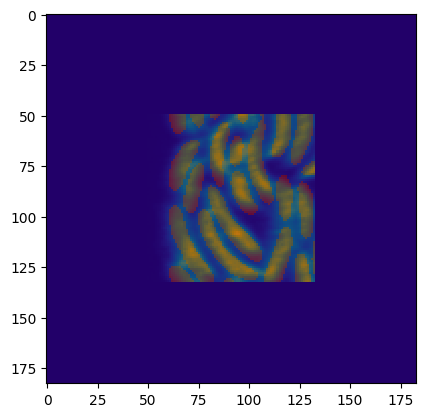

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          424122885.0
y                                                           50
x                                                           50
Name: 175, dtype: object
171 254 553 636
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


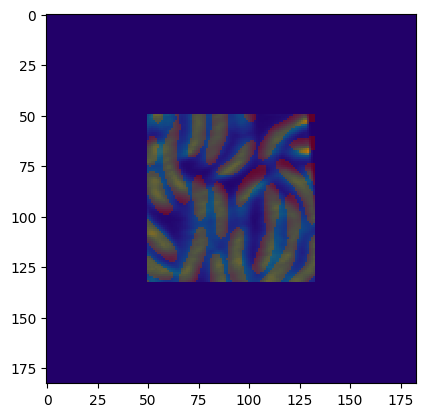

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          455480235.0
y                                                           50
x                                                           50
Name: 175, dtype: object
213 296 553 636
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


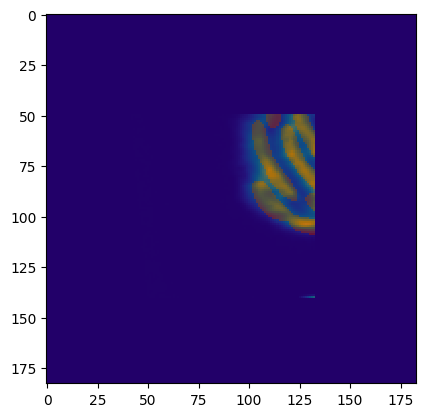

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     125836240.909091
y                                                           50
x                                                           42
Name: 180, dtype: object
122 205 595 678
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


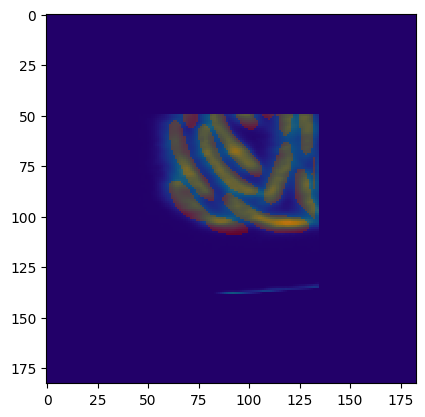

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.08
CrossCorr                                     291696861.111111
y                                                           50
x                                                           46
Name: 179, dtype: object
167 250 595 678
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


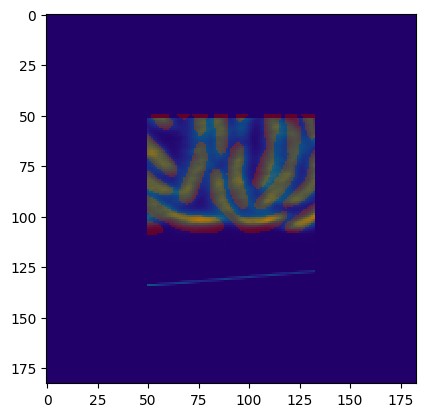

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          341387625.0
y                                                           52
x                                                           50
Name: 175, dtype: object
213 296 597 680
(827, 808)
(83, 83)


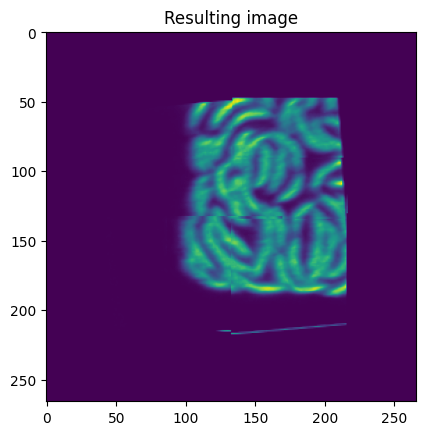

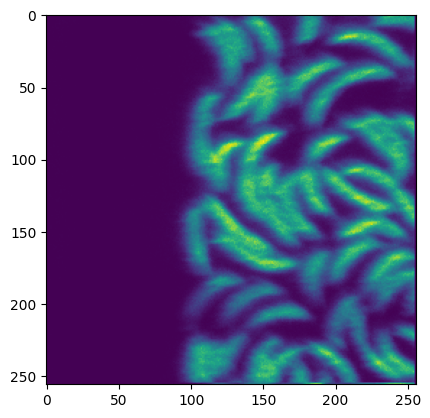

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


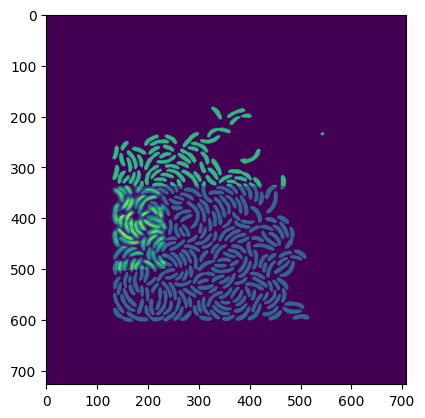

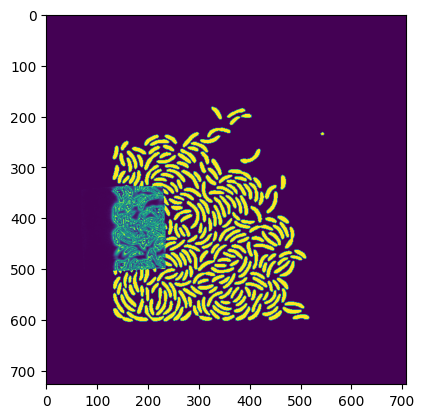

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     4
Scaling                                                   0.65
CrossCorr                                    1224992538.461537
y                                                          338
x                                                           69
Name: 101, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


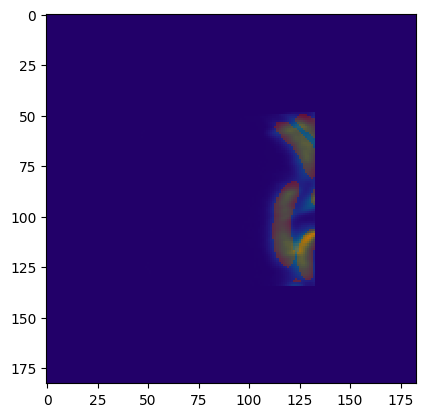

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      85375471.153846
y                                                           49
x                                                           47
Name: 177, dtype: object
116 199 387 470
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


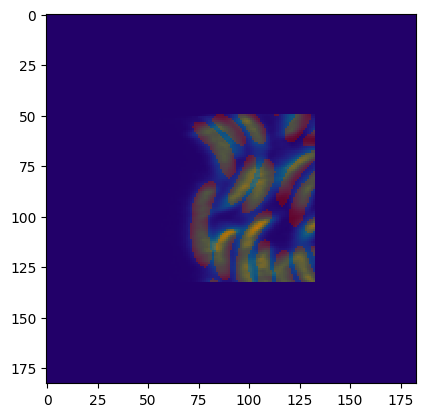

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          273393150.0
y                                                           50
x                                                           50
Name: 175, dtype: object
160 243 388 471
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


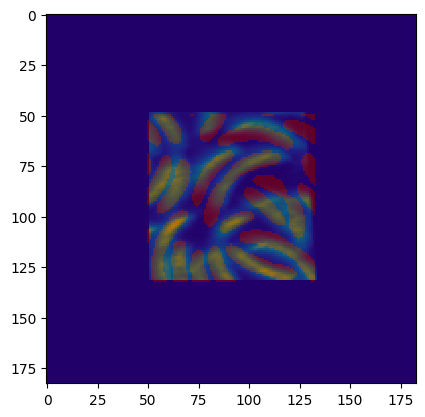

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          327954735.0
y                                                           49
x                                                           51
Name: 175, dtype: object
203 286 387 470
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


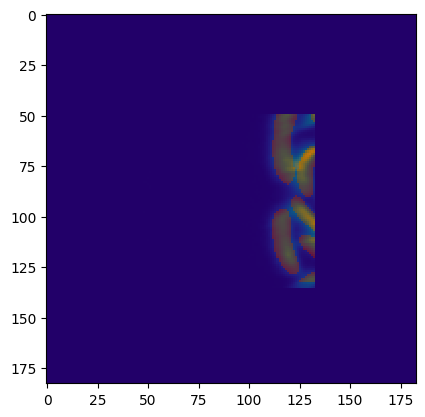

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      91963788.461538
y                                                           50
x                                                           47
Name: 177, dtype: object
116 199 429 512
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


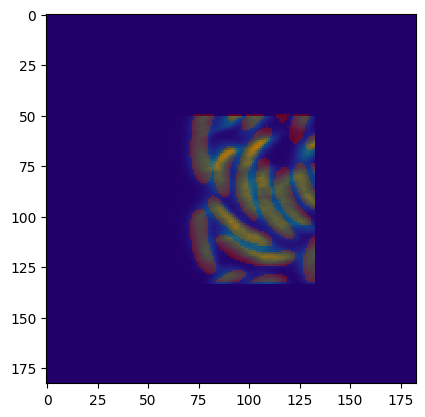

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          293197215.0
y                                                           51
x                                                           50
Name: 175, dtype: object
160 243 430 513
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


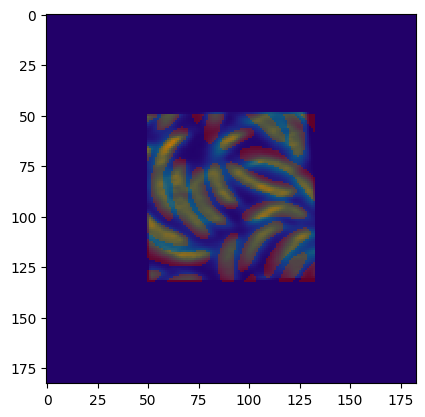

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                          382427070.0
y                                                           49
x                                                           50
Name: 203, dtype: object
202 285 428 511
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


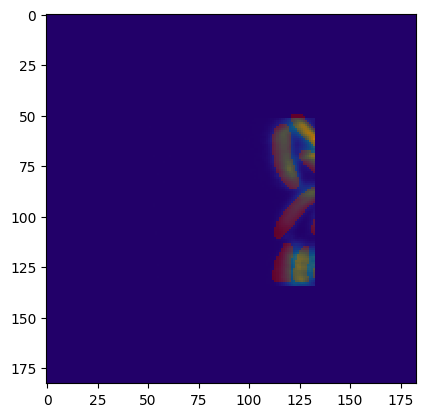

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           69641520.0
y                                                           52
x                                                           50
Name: 175, dtype: object
119 202 473 556
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


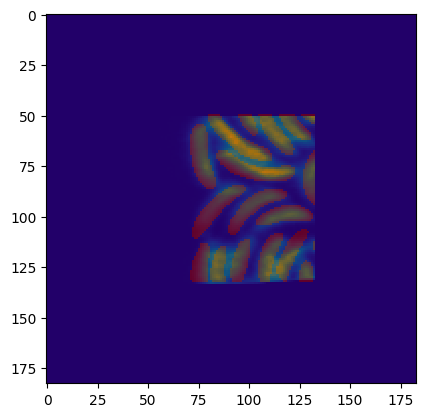

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          244652355.0
y                                                           51
x                                                           50
Name: 175, dtype: object
160 243 472 555
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


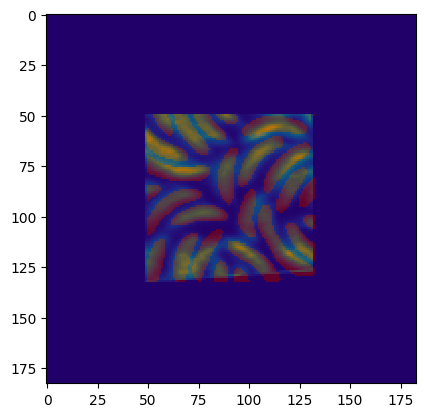

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          318733935.0
y                                                           50
x                                                           49
Name: 175, dtype: object
201 284 471 554
(827, 808)
(83, 83)


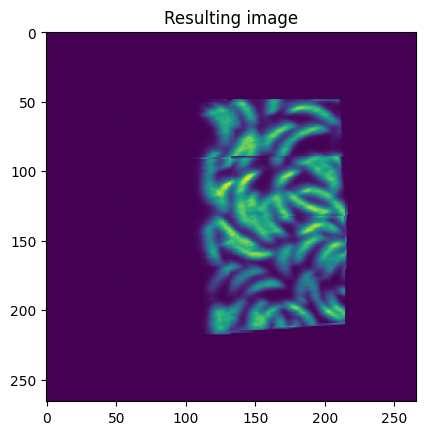

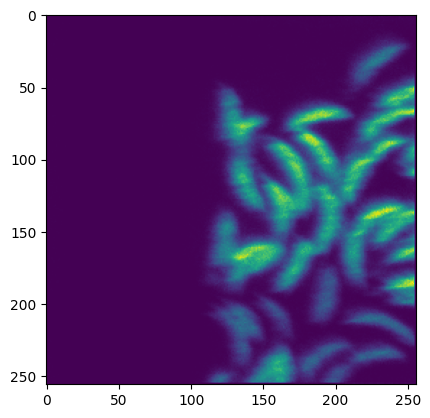

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


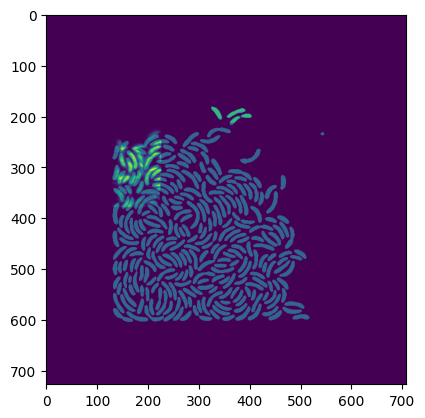

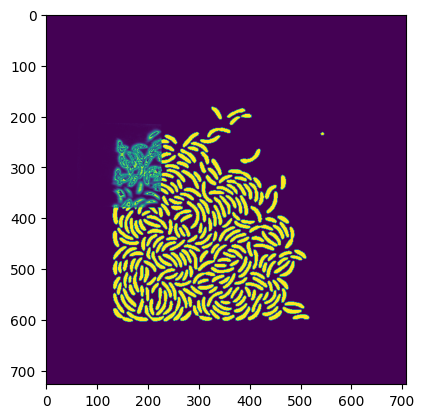

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                   0.65
CrossCorr                                     539369723.076923
y                                                          214
x                                                           61
Name: 65, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


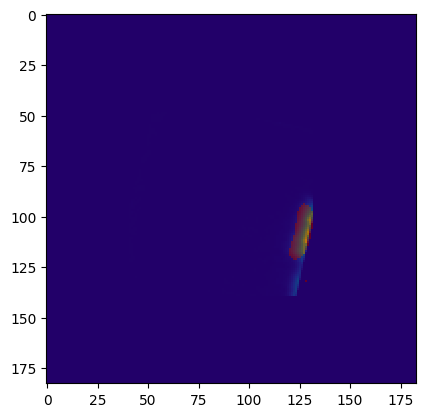

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    1.1
CrossCorr                                       5943122.727273
y                                                           49
x                                                           41
Name: 12, dtype: object
102 185 263 346
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


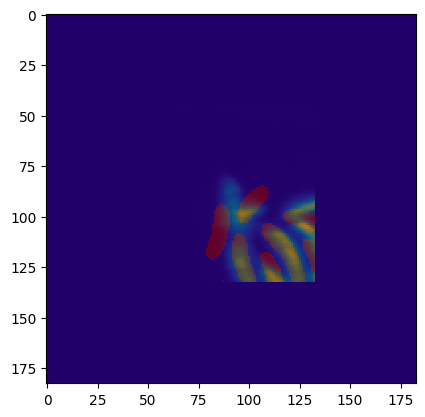

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      77594048.076923
y                                                           47
x                                                           47
Name: 177, dtype: object
149 232 261 344
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


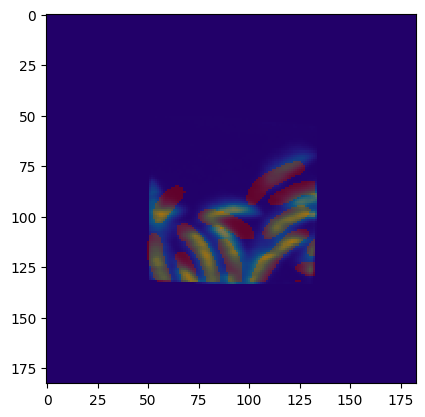

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -3
Scaling                                                    1.0
CrossCorr                                          145908705.0
y                                                           51
x                                                           51
Name: 133, dtype: object
195 278 265 348
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


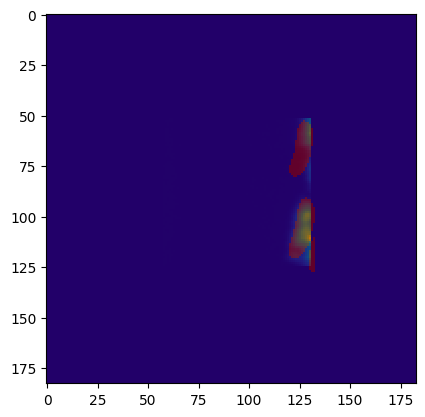

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.88
CrossCorr                                      17504011.363636
y                                                           52
x                                                           58
Name: 169, dtype: object
119 202 307 390
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


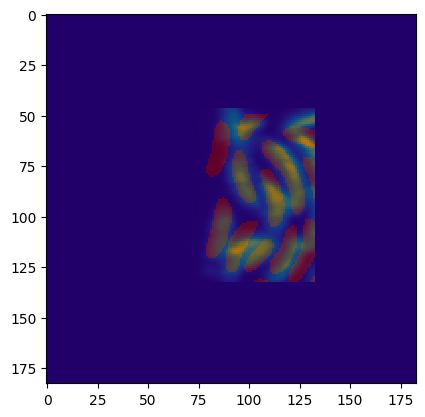

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     156484673.076923
y                                                           47
x                                                           47
Name: 177, dtype: object
149 232 302 385
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


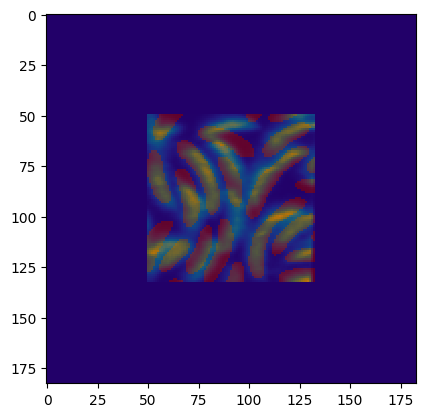

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          264066780.0
y                                                           50
x                                                           50
Name: 175, dtype: object
194 277 305 388
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


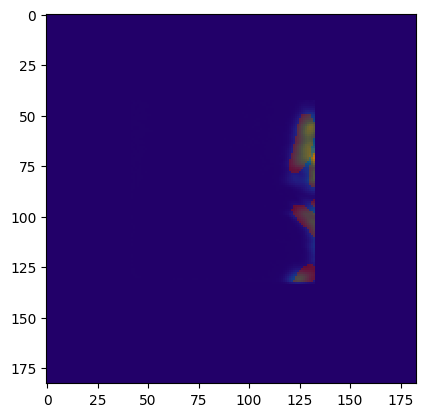

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                           20716200.0
y                                                           43
x                                                           42
Name: 180, dtype: object
103 186 340 423
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


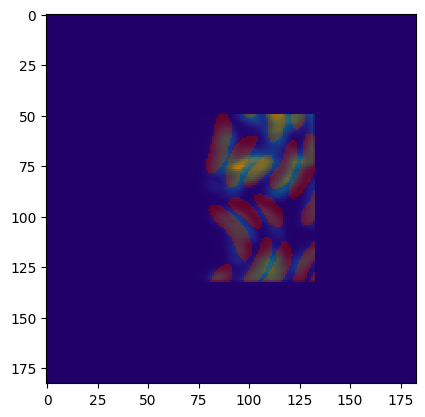

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          117146490.0
y                                                           50
x                                                           50
Name: 189, dtype: object
152 235 347 430
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


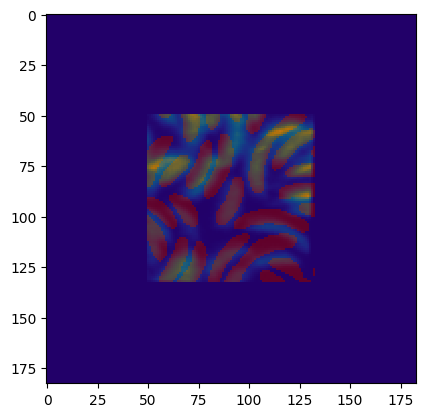

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          184430790.0
y                                                           50
x                                                           50
Name: 175, dtype: object
194 277 347 430
(827, 808)
(83, 83)


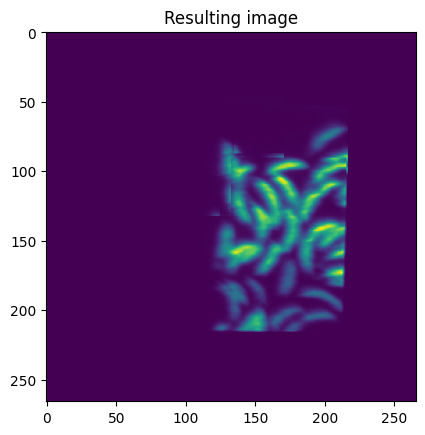

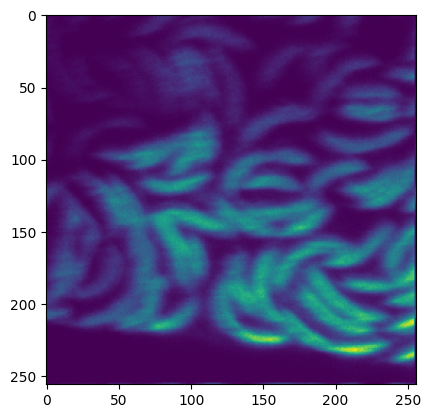

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


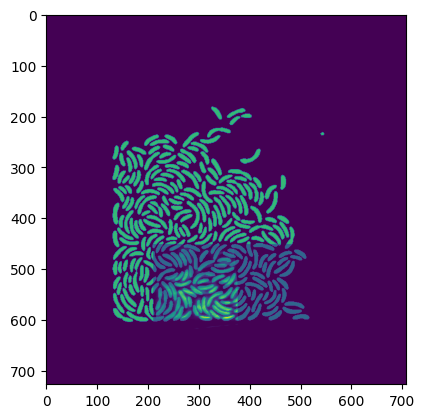

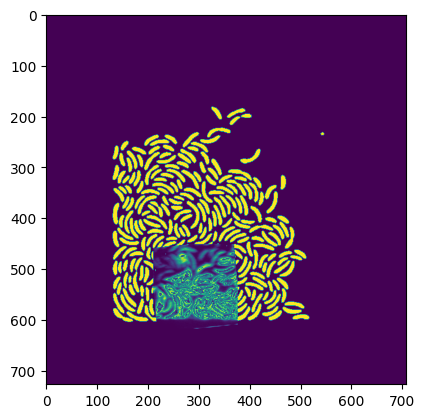

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     6
Scaling                                                   0.65
CrossCorr                                    1250234007.692306
y                                                          452
x                                                          211
Name: 113, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


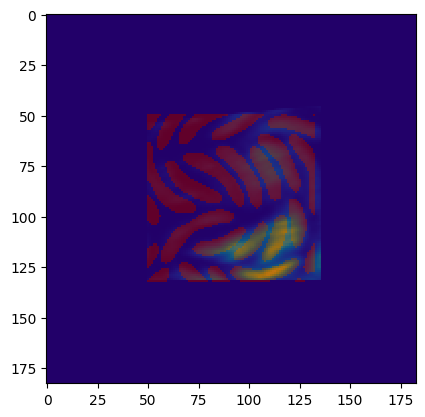

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     114819879.807692
y                                                           46
x                                                           50
Name: 177, dtype: object
261 344 498 581
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


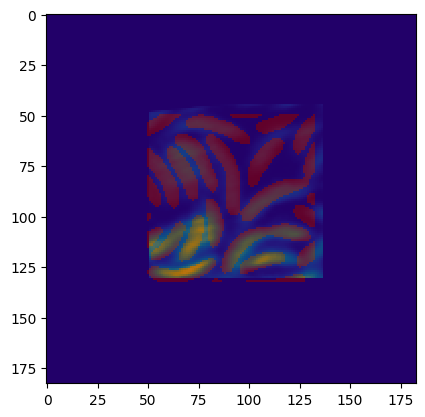

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     150318086.538462
y                                                           45
x                                                           51
Name: 177, dtype: object
303 386 497 580
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


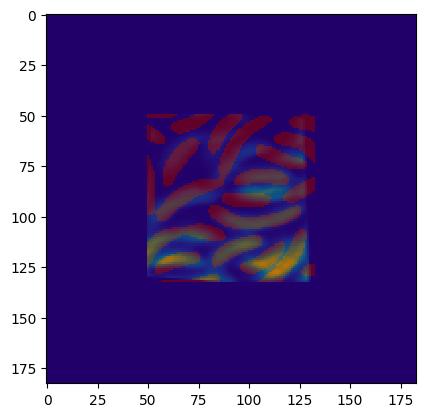

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -4
Scaling                                                    1.0
CrossCorr                                          140015655.0
y                                                           50
x                                                           50
Name: 119, dtype: object
344 427 502 585
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


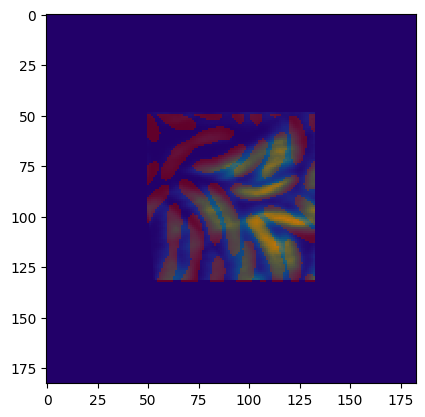

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          224587935.0
y                                                           49
x                                                           50
Name: 175, dtype: object
261 344 542 625
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


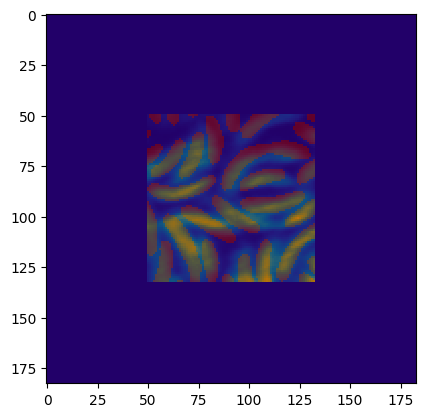

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          319290600.0
y                                                           50
x                                                           50
Name: 175, dtype: object
302 385 543 626
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


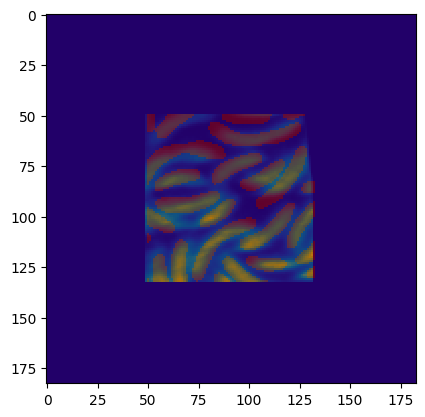

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          303375030.0
y                                                           50
x                                                           49
Name: 175, dtype: object
343 426 543 626
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


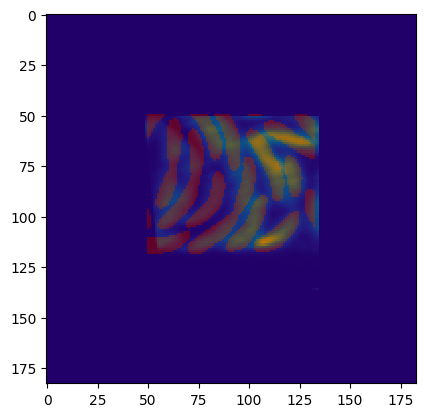

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     220313134.615385
y                                                           51
x                                                           49
Name: 177, dtype: object
260 343 586 669
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


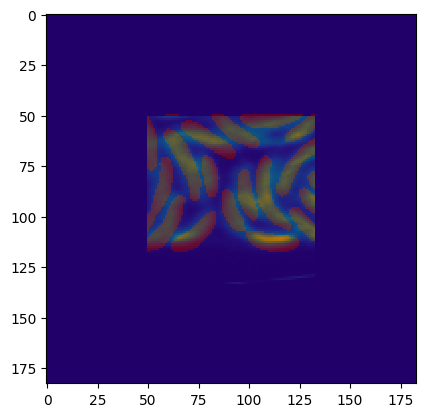

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          332201505.0
y                                                           51
x                                                           50
Name: 175, dtype: object
302 385 586 669
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


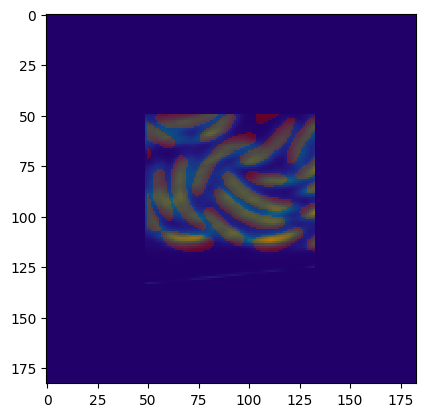

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.02
CrossCorr                                          357416000.0
y                                                           50
x                                                           49
Name: 176, dtype: object
343 426 585 668
(827, 808)
(83, 83)


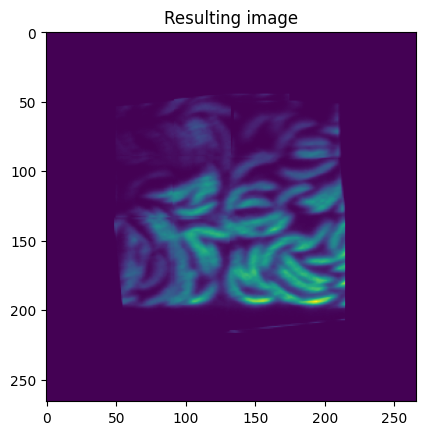

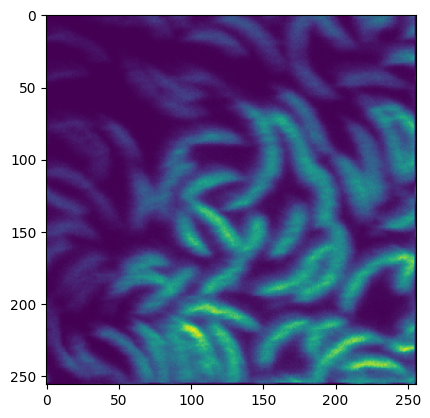

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


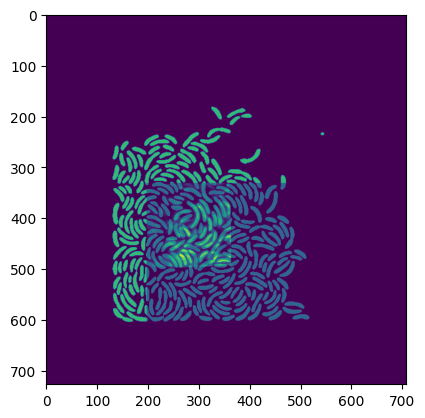

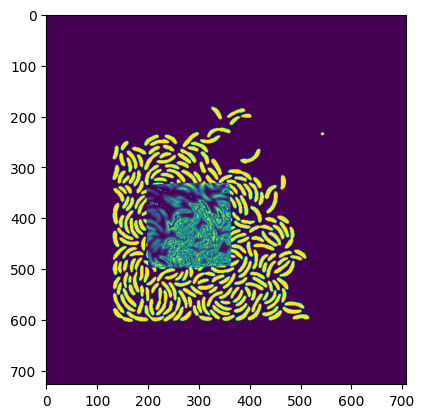

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                   0.65
CrossCorr                                    1034929269.230768
y                                                          332
x                                                          198
Name: 95, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


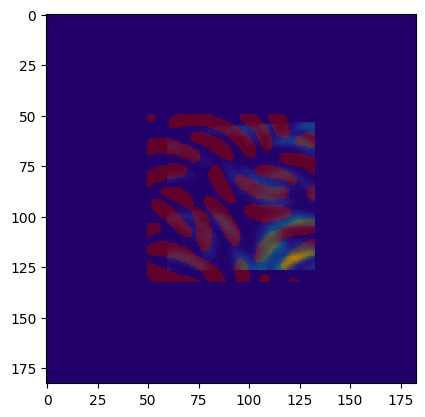

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.88
CrossCorr                                      55321960.227273
y                                                           54
x                                                           60
Name: 169, dtype: object
258 341 386 469
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


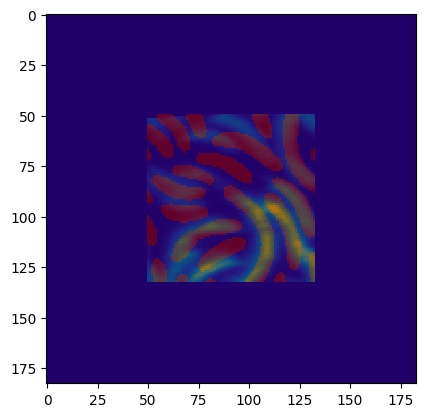

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          128066355.0
y                                                           50
x                                                           50
Name: 175, dtype: object
289 372 382 465
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


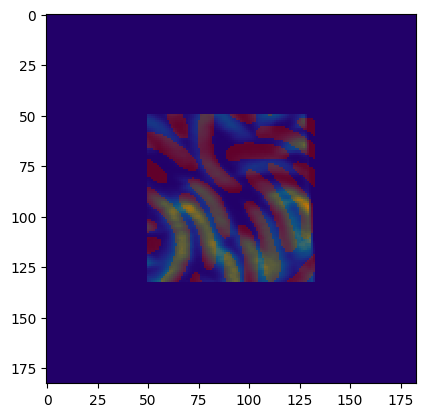

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          170477955.0
y                                                           50
x                                                           50
Name: 175, dtype: object
331 414 382 465
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


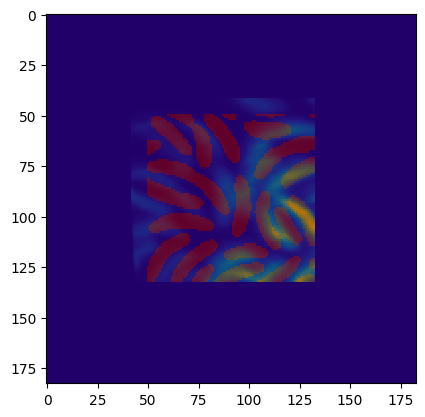

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     116717209.090909
y                                                           42
x                                                           42
Name: 180, dtype: object
240 323 415 498
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


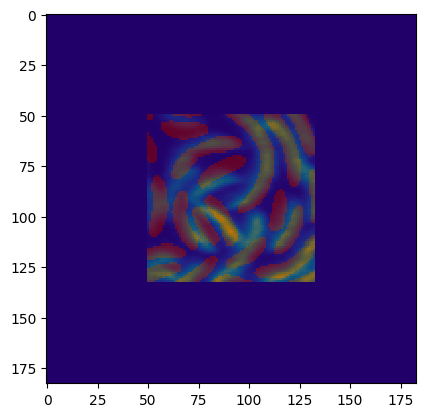

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          224555550.0
y                                                           50
x                                                           50
Name: 175, dtype: object
289 372 423 506
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


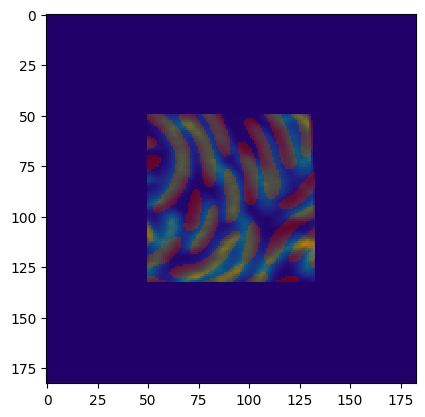

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          253677060.0
y                                                           50
x                                                           50
Name: 175, dtype: object
331 414 423 506
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


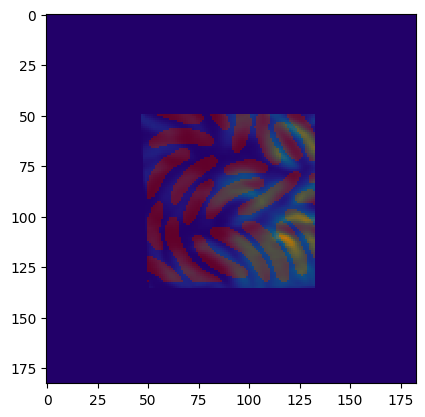

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     201642475.961539
y                                                           50
x                                                           47
Name: 177, dtype: object
245 328 465 548
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


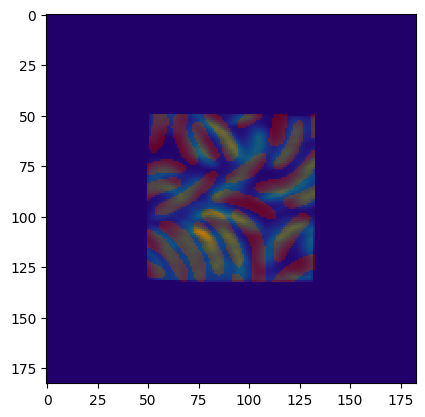

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    1.0
CrossCorr                                          293307375.0
y                                                           50
x                                                           50
Name: 147, dtype: object
289 372 465 548
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


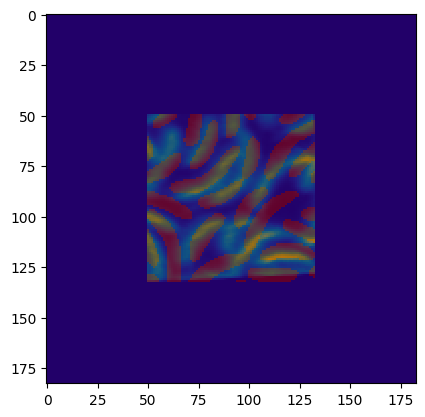

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          249276270.0
y                                                           50
x                                                           50
Name: 175, dtype: object
331 414 465 548
(827, 808)
(83, 83)


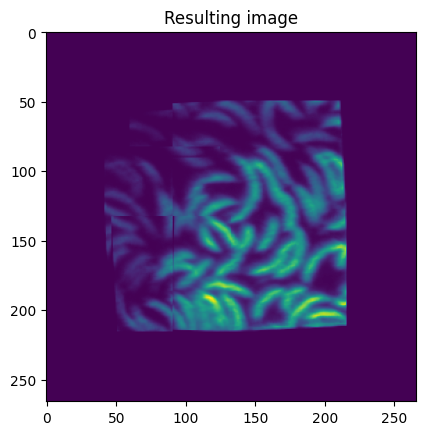

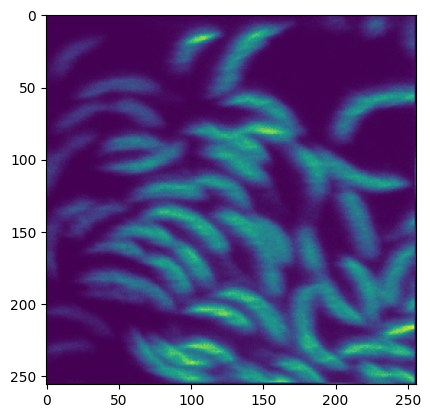

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


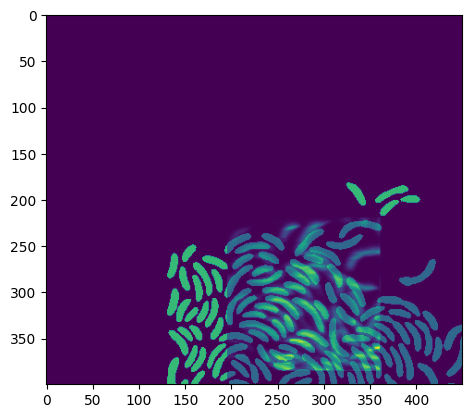

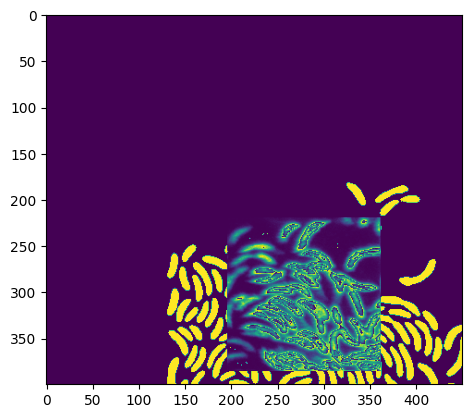

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                     948687484.615385
y                                                          220
x                                                          196
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


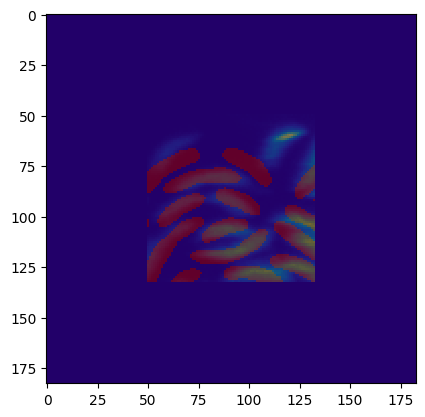

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          102932790.0
y                                                           50
x                                                           50
Name: 175, dtype: object
246 329 270 353
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


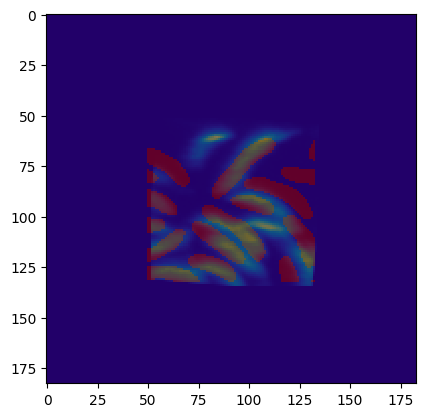

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -5
Scaling                                                    1.0
CrossCorr                                          141958245.0
y                                                           52
x                                                           52
Name: 105, dtype: object
289 372 272 355
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


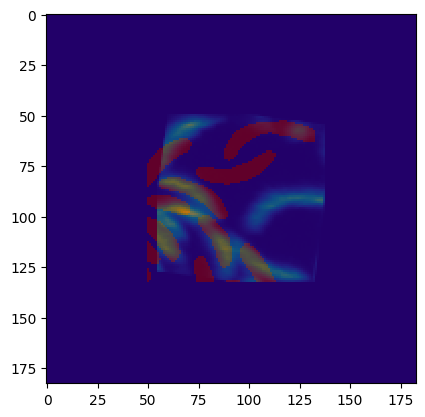

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -8
Scaling                                                    1.0
CrossCorr                                           95496480.0
y                                                           50
x                                                           55
Name: 63, dtype: object
334 417 270 353
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


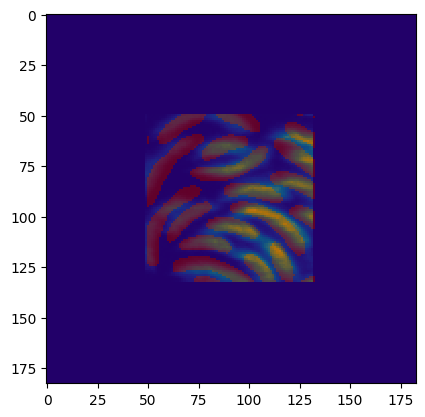

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          193718655.0
y                                                           50
x                                                           49
Name: 175, dtype: object
245 328 311 394
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


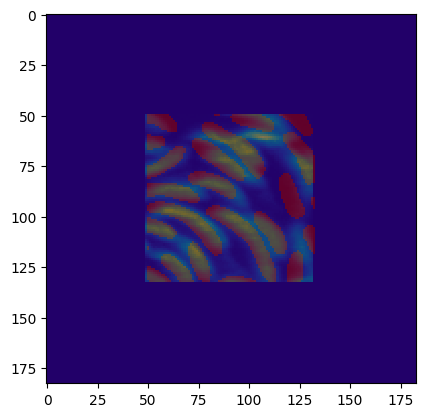

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          245691480.0
y                                                           50
x                                                           49
Name: 175, dtype: object
286 369 311 394
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


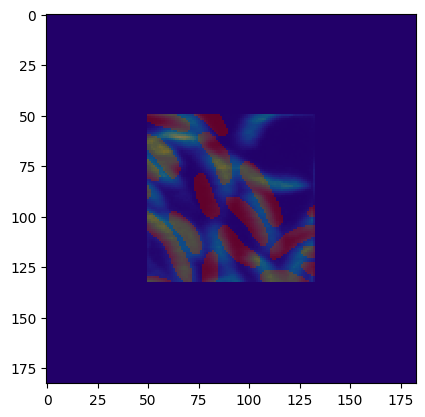

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          158649015.0
y                                                           50
x                                                           50
Name: 175, dtype: object
329 412 311 394
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


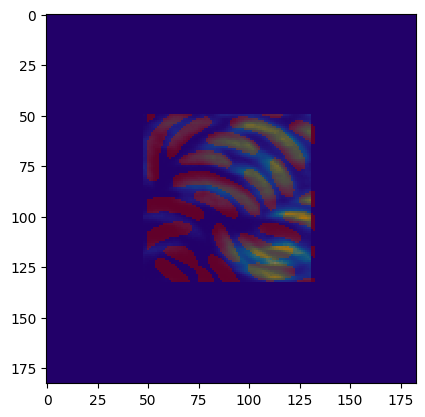

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          184470315.0
y                                                           50
x                                                           48
Name: 175, dtype: object
244 327 353 436
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


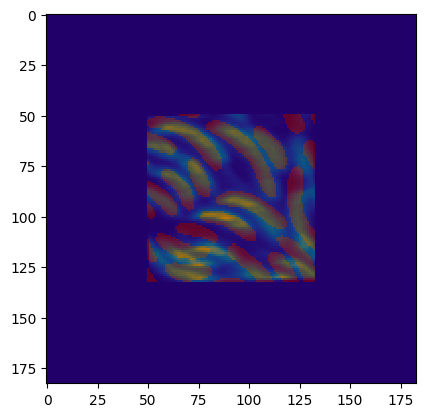

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                          278877180.0
y                                                           50
x                                                           50
Name: 203, dtype: object
287 370 353 436
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


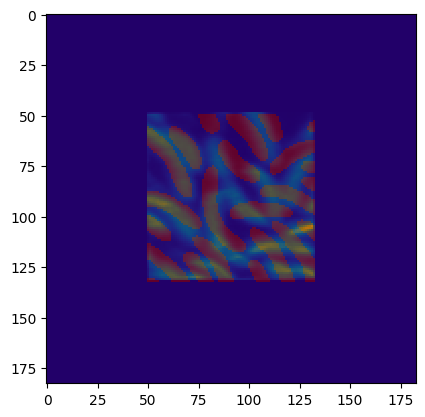

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          245601975.0
y                                                           49
x                                                           50
Name: 189, dtype: object
329 412 352 435
(827, 808)
(83, 83)


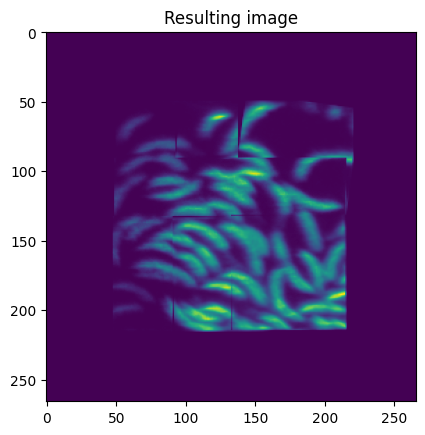

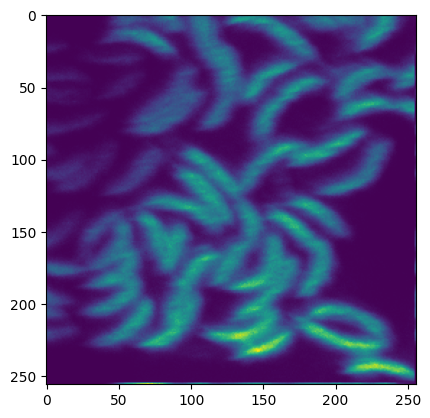

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


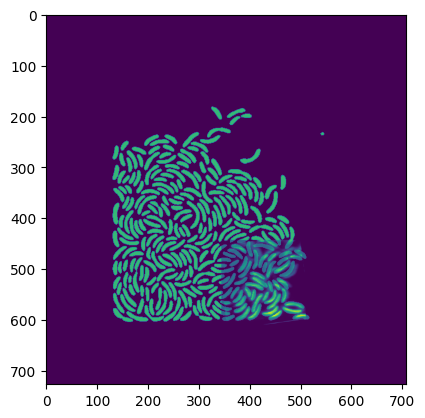

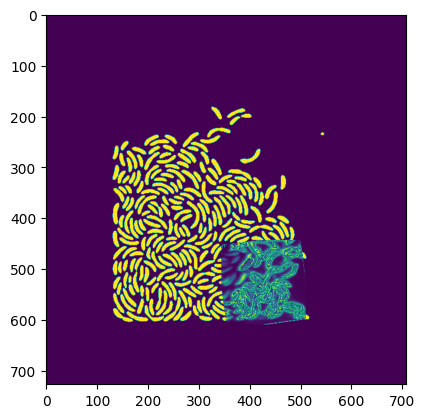

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     8
Scaling                                                   0.65
CrossCorr                                    1254743192.307691
y                                                          444
x                                                          345
Name: 125, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


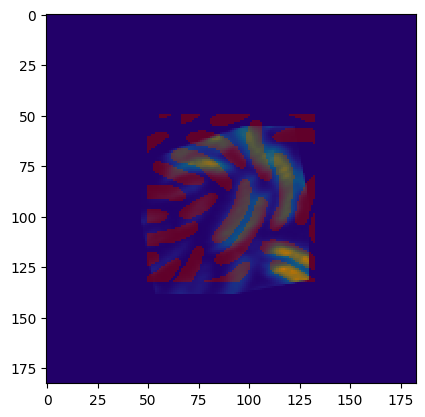

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    11
Scaling                                                    1.0
CrossCorr                                          133640655.0
y                                                           56
x                                                           47
Name: 329, dtype: object
392 475 500 583
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


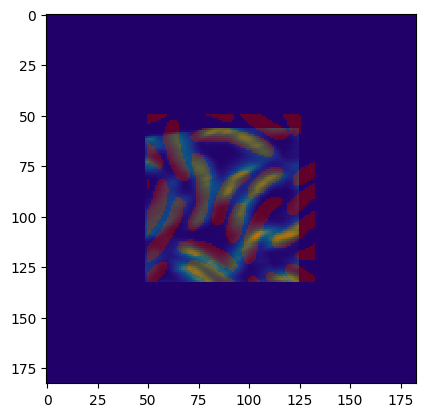

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.92
CrossCorr                                     205945206.521739
y                                                           57
x                                                           49
Name: 171, dtype: object
435 518 501 584
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


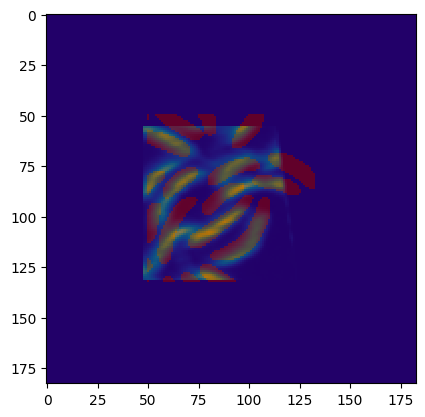

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.92
CrossCorr                                      170987478.26087
y                                                           56
x                                                           48
Name: 171, dtype: object
476 559 500 583
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


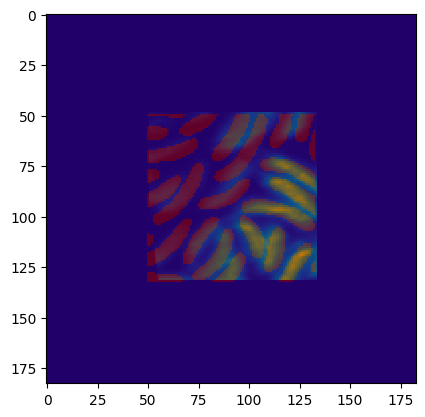

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          209437365.0
y                                                           49
x                                                           51
Name: 175, dtype: object
396 479 534 617
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


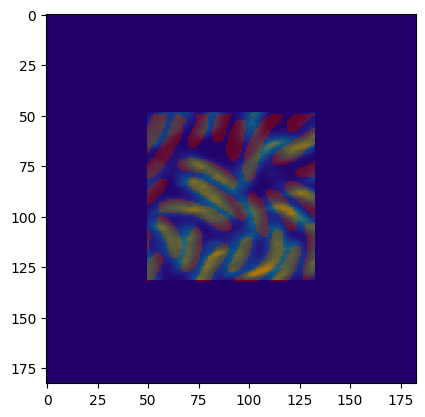

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          310051950.0
y                                                           49
x                                                           50
Name: 175, dtype: object
436 519 534 617
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


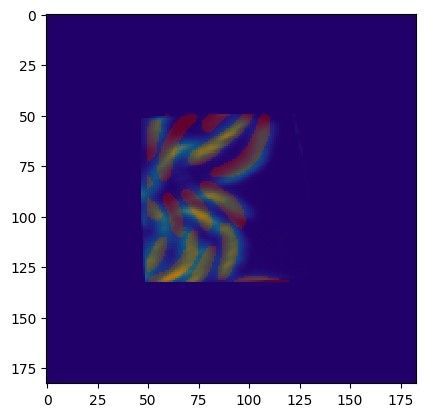

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                    1.0
CrossCorr                                          201955920.0
y                                                           50
x                                                           47
Name: 217, dtype: object
475 558 535 618
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


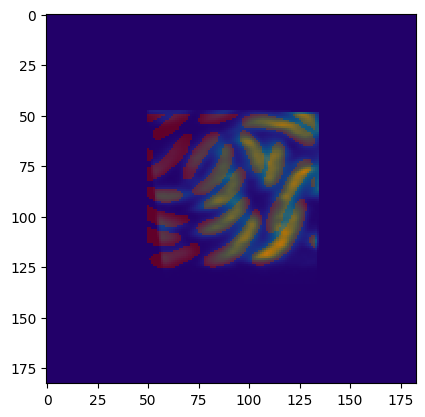

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                   1.04
CrossCorr                                     242243134.615385
y                                                           48
x                                                           49
Name: 149, dtype: object
394 477 575 658
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


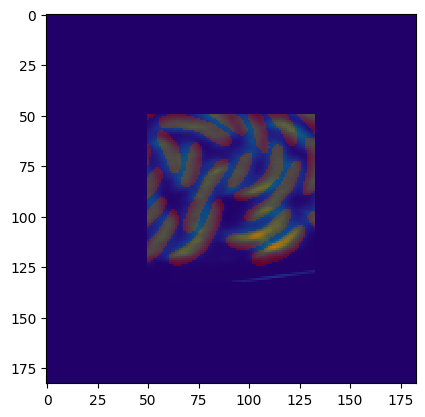

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          353437395.0
y                                                           50
x                                                           50
Name: 175, dtype: object
436 519 577 660
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


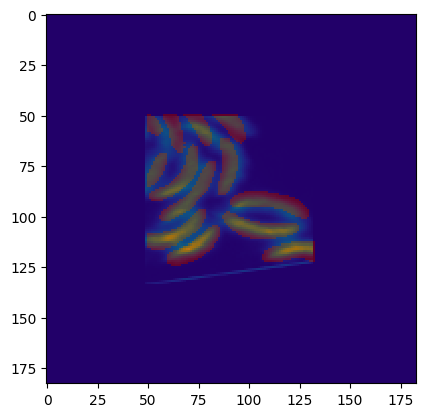

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          291140640.0
y                                                           51
x                                                           49
Name: 175, dtype: object
477 560 578 661
(827, 808)
(83, 83)


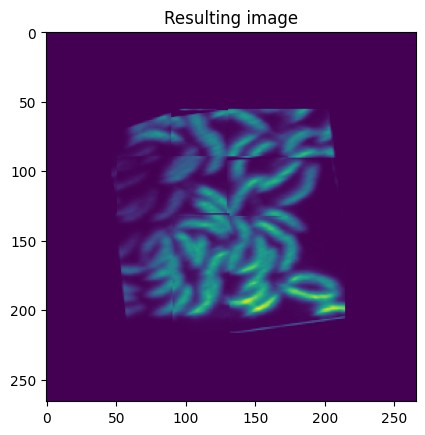

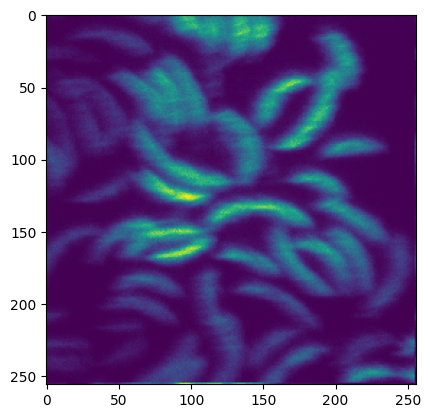

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


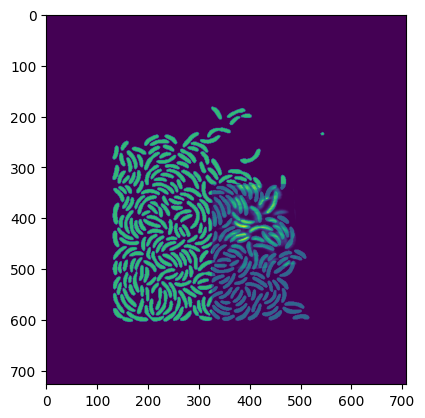

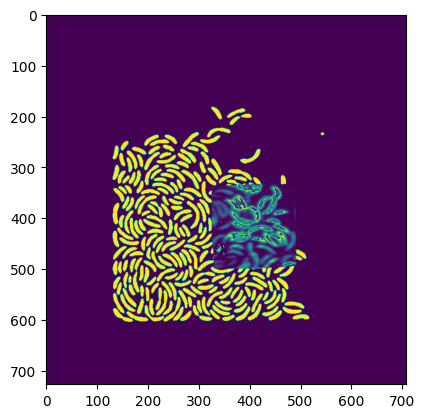

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     4
Scaling                                                   0.65
CrossCorr                                      559677530.76923
y                                                          334
x                                                          326
Name: 101, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


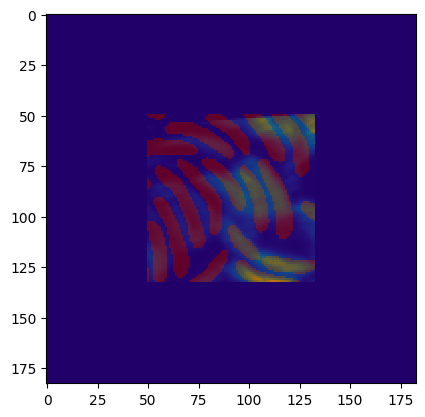

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          114838995.0
y                                                           50
x                                                           50
Name: 175, dtype: object
376 459 384 467
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


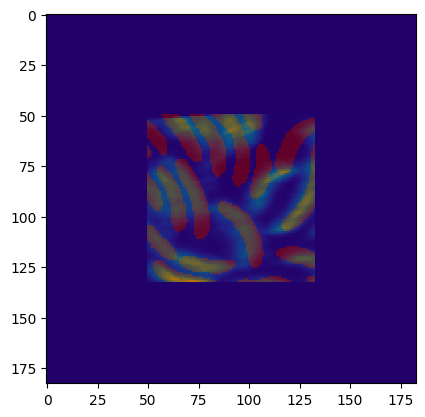

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          158411865.0
y                                                           50
x                                                           50
Name: 175, dtype: object
417 500 384 467
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


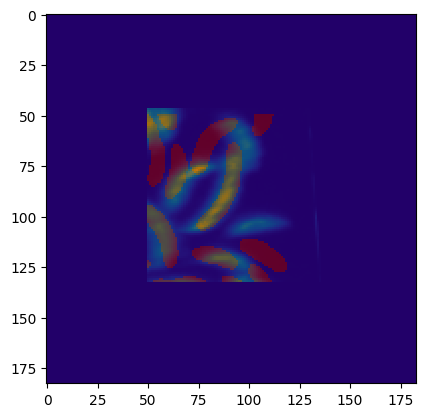

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      77428052.884615
y                                                           47
x                                                           50
Name: 177, dtype: object
459 542 381 464
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


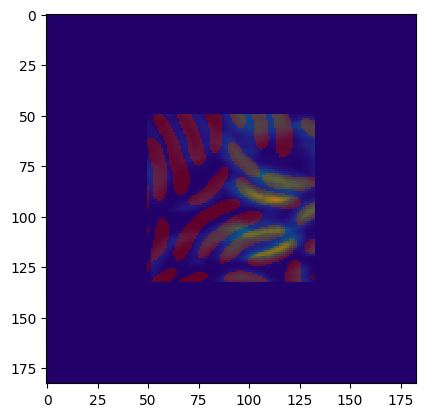

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          120739185.0
y                                                           50
x                                                           50
Name: 175, dtype: object
376 459 425 508
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


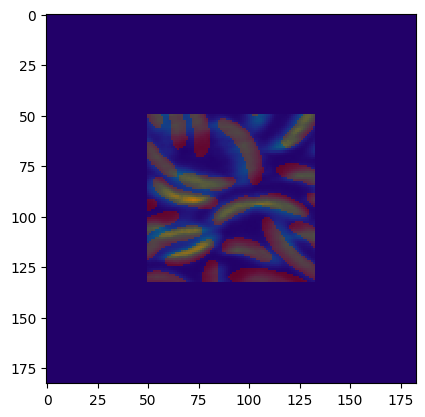

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          176590560.0
y                                                           50
x                                                           50
Name: 175, dtype: object
417 500 425 508
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


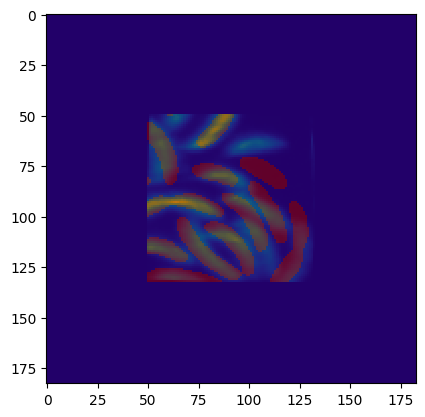

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    1.0
CrossCorr                                          112367280.0
y                                                           50
x                                                           50
Name: 147, dtype: object
459 542 425 508
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


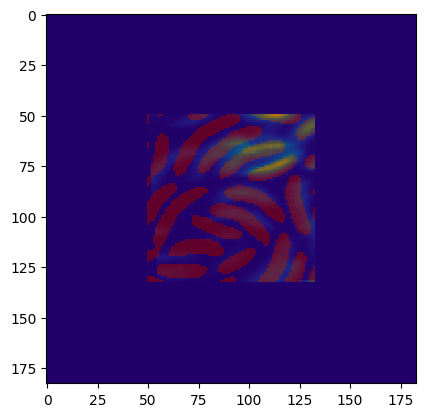

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           76394430.0
y                                                           50
x                                                           50
Name: 175, dtype: object
376 459 467 550
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


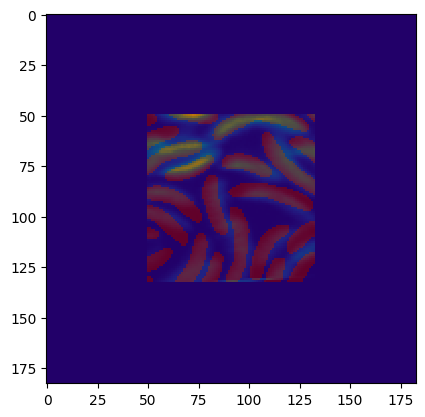

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          119972910.0
y                                                           50
x                                                           50
Name: 175, dtype: object
417 500 467 550
(827, 808)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


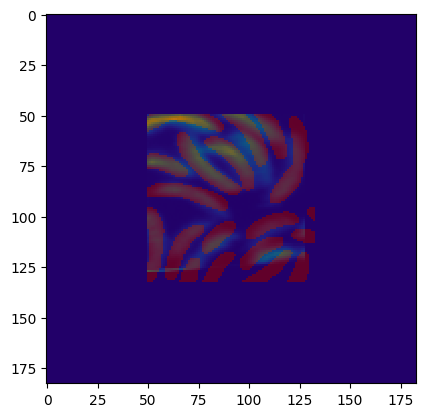

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.94
CrossCorr                                      97428446.808511
y                                                           50
x                                                           50
Name: 172, dtype: object
459 542 467 550
(827, 808)
(83, 83)


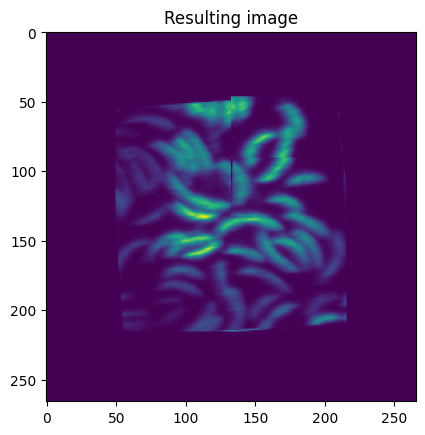

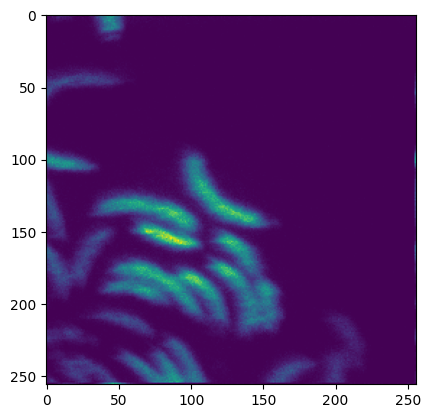

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


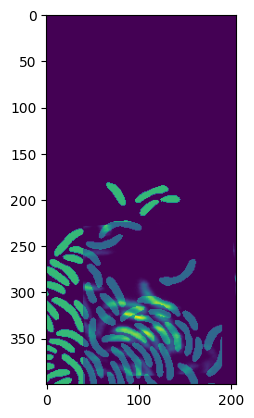

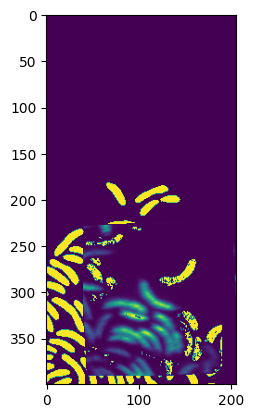

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                   0.65
CrossCorr                                     110152546.153846
y                                                          225
x                                                           40
Name: 95, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


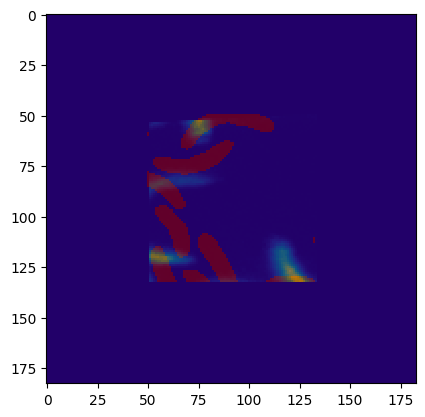

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                            6948750.0
y                                                           50
x                                                           51
Name: 175, dtype: object
91 174 275 358
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


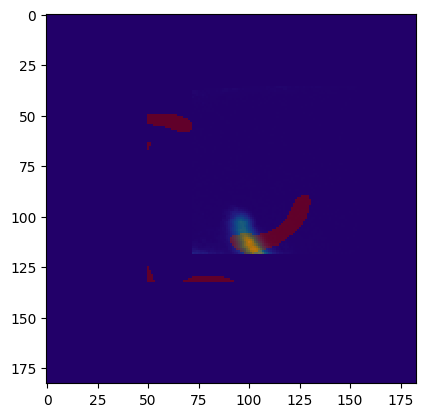

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                            3898185.0
y                                                           36
x                                                           72
Name: 175, dtype: object
153 236 261 344
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


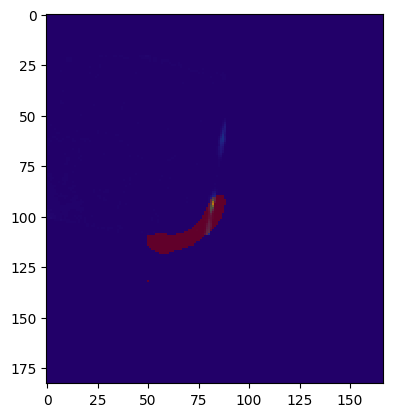

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                   1.08
CrossCorr                                        222416.666667
y                                                           21
x                                                            0
Name: 11, dtype: object
123 206 246 329
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


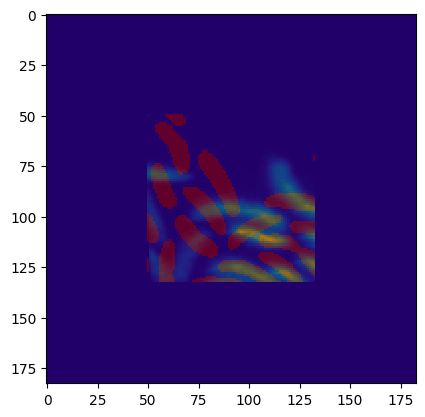

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           36650385.0
y                                                           50
x                                                           50
Name: 175, dtype: object
90 173 316 399
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


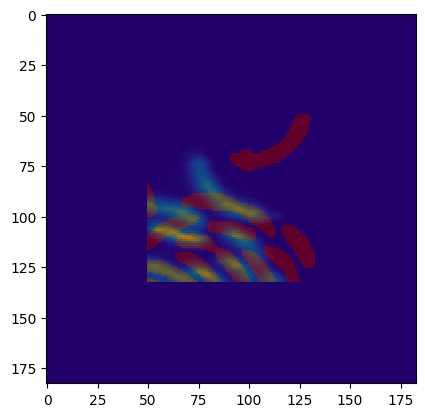

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      37894961.538462
y                                                           47
x                                                           50
Name: 177, dtype: object
131 214 313 396
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


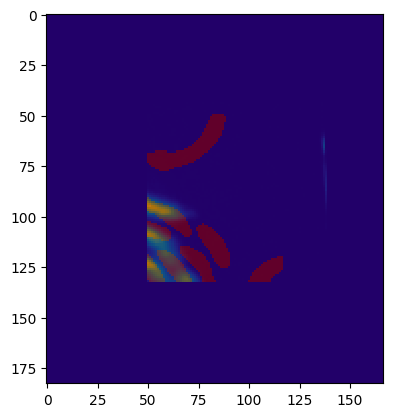

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.08
CrossCorr                                      11023319.444444
y                                                           44
x                                                           50
Name: 179, dtype: object
173 256 310 393
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


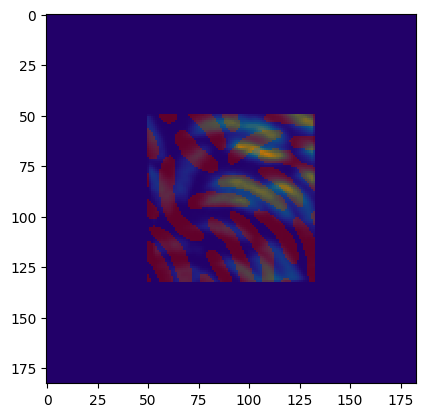

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                           47354520.0
y                                                           50
x                                                           50
Name: 189, dtype: object
90 173 358 441
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


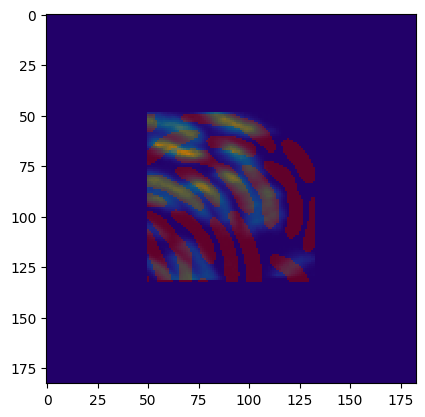

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           51942225.0
y                                                           49
x                                                           50
Name: 175, dtype: object
131 214 357 440
(827, 548)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_20640\1620143863.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


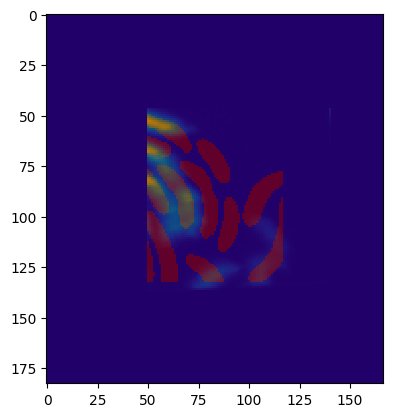

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      18051218.181818
y                                                           47
x                                                           50
Name: 180, dtype: object
173 256 355 438
(827, 548)
(83, 83)


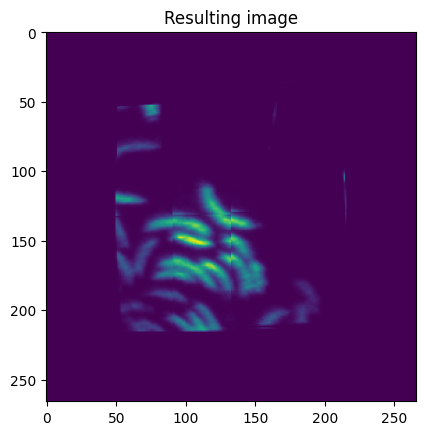

In [30]:
NanoSIMS_channel_11_1 = Image_stitching()

    
NanoSIMS_path_14N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\14N\FW_1108_pos11a_chn1_", "-14N12C.tif"]
NanoSIMS_path_15N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\15N\FW_1108_pos11a_chn1_", "-15N12C.tif"]
NanoSIMS_path_12C = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\12C\FW_1108_pos11a_chn1_", "-12C2.tif"]
MF_mask_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\seg_im_bin\Timelapse_pos11_TxRed_frame049_seg_bin.png"
Results_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Combined"
h5_path = r'C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\track_output\tracking_strack.h5'
arrangement = [[1, 2, 3], [6, 5, 4], [7, 8, 9]]

mode = "overlay" # Choose "onoff" ; "overlay" ; "twochanneloverlay"

res_list_channel_11_1 = NanoSIMS_channel_11_1.create_combined_image(NanoSIMS_path_14N = NanoSIMS_path_14N, NanoSIMS_path_15N = NanoSIMS_path_15N, NanoSIMS_path_12C = NanoSIMS_path_12C, MF_mask_path = MF_mask_path, Results_path = Results_path, h5_path = h5_path, arrangement = arrangement, mode = mode)

In [15]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]

print(len(np.unique(labels)) -1 )

276


In [16]:
## Everything based on 14N 
intensity_map_14N_11_1 = np.array(NanoSIMS_channel_11_1.intensity_map_14N)
intensity_map_14N_11_1_unique = np.array([np.unique(intensity_map_14N_11_1[:,0]),np.array([float(max(intensity_map_14N_11_1[:,1][np.argwhere(intensity_map_14N_11_1[:,0] == index)])) for index in np.unique(intensity_map_14N_11_1[:,0])])]).T
intensity_map_unique_df_11_1 = pd.DataFrame(intensity_map_14N_11_1_unique, columns=("trackID", "14N"))
"""for i in np.unique(intensity_map_14N[:,0]):
    print(intensity_map_14N[np.where(intensity_map_14N[:,0] == i)])"""


intensity_map_15N_11_1 = np.array(NanoSIMS_channel_11_1.intensity_map_15N)
intensity_map_unique_df_11_1["15N"] = np.array([float(max(intensity_map_15N_11_1[:,1][np.argwhere(intensity_map_14N_11_1[:,0] == index)])) for index in np.unique(intensity_map_14N_11_1[:,0])])
"""for i in np.unique(intensity_map_15N[:,0]):
    print(intensity_map_15N[np.where(intensity_map_15N[:,0] == i)])"""


intensity_map_12C_11_1 = np.array(NanoSIMS_channel_11_1.intensity_map_12C)
intensity_map_unique_df_11_1["12C"] = np.array([float(max(intensity_map_12C_11_1[:,1][np.argwhere(intensity_map_14N_11_1[:,0] == index)])) for index in np.unique(intensity_map_14N_11_1[:,0])])
"""for i in np.unique(intensity_map_12C[:,0]):
    print(intensity_map_12C[np.where(intensity_map_12C[:,0] == i)])"""

intensity_map_unique_df_11_1["total_N"] =  (intensity_map_unique_df_11_1["15N"] + intensity_map_unique_df_11_1["14N"])
intensity_map_unique_df_11_1["15N_to_total_N"] = intensity_map_unique_df_11_1["15N"] / intensity_map_unique_df_11_1["total_N"]
intensity_map_unique_df_11_1["total_N_to_12C"] = intensity_map_unique_df_11_1["total_N"] /intensity_map_unique_df_11_1["12C"] 


growth_df_11_1 = pd.read_csv(r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\track_output\analyzed\Chamber11_1-growth_rates_lineage_biomass_benny.csv")
growth_df_11_1 = growth_df_11_1[["trackID", "biomass_gain"]]

data_df_11_1 = pd.merge(intensity_map_unique_df_11_1, growth_df_11_1, on="trackID")
#data_df = data_df[["15N_to_total","growth_rate_lineage"]]

NameError: name 'NanoSIMS_channel_11_1' is not defined

In [17]:
y = data_df_11_1["15N_to_total_N"]
x = data_df_11_1["biomass_gain"] * 100#(np.exp(data_df_11_1["lineages15_growth_rates"] * 10/12) - 1) * 100
y = y[np.isfinite(x)]
x = x[np.isfinite(x)]
z = np.polyfit(x, y, deg=1)
#print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)

NameError: name 'data_df_11_1' is not defined

In [18]:
data_df_crop_11_1 = data_df_11_1.     loc[data_df_11_1     ["14N"]                 >= 60]
data_df_crop_11_1 = data_df_crop_11_1.loc[data_df_crop_11_1["15N_to_total_N"]      >= 0.0]
data_df_crop_11_1 = data_df_crop_11_1.loc[data_df_crop_11_1["biomass_gain"] <= 1.0]
data_df_crop_11_1 = data_df_crop_11_1.loc[data_df_crop_11_1["biomass_gain"] >= 0.0]


print("Bacteria before the filter: " + str(len(data_df_11_1["14N"])) + "\n", 
      "Bacteria after the filter: " + str(len(data_df_crop_11_1["14N"])))

data_df_crop_11_1.plot.scatter("15N_to_total_N", "biomass_gain")
plt.show()

data_df_crop_11_1.plot.scatter("15N_to_total_N", "12C")
plt.show()

data_df_crop_11_1.plot.scatter("12C", "total_N_to_12C")
plt.show()
data_df_crop_11_1.corr(method="spearman")


y = data_df_crop_11_1["15N_to_total_N"]
x = data_df_crop_11_1["biomass_gain"] * 100 #(np.exp(data_df_crop_11_1["lineages15_growth_rates"] * 10/12) - 1) * 100
z = np.polyfit(x, y, deg=1)
print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)
plt.ylabel("15N_to_total_N")
plt.xlabel("Biomass gain after switch [percent]")
plt.show()

NameError: name 'data_df_11_1' is not defined

276


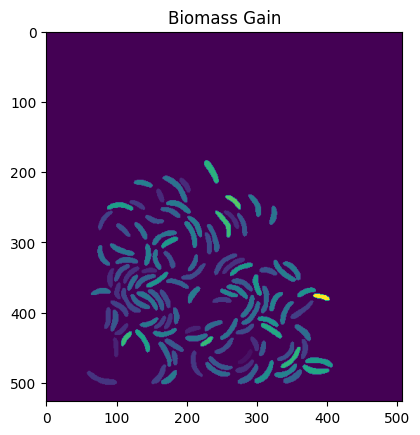

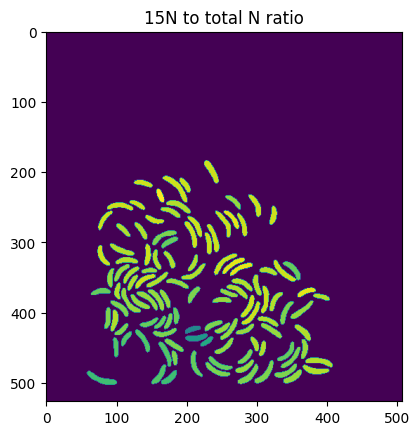

In [37]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_1\Growth\pos11\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]
biomass_gain_segmentation = labels.copy()
N15_total_N_ratio = labels.copy()
non_tracked_cells = np.unique(labels)[np.in1d(np.unique(labels), data_df_crop_11_1["trackID"], invert=True)]
print(len(np.unique(labels)) -1 )
for trackID in data_df_crop_11_1["trackID"].values: 
    biomass_gain_segmentation[labels == int(trackID)] = data_df_crop_11_1[data_df_crop_11_1["trackID"] == trackID]["biomass_gain"].values[0] * 100
    N15_total_N_ratio[labels == int(trackID)] = data_df_crop_11_1[data_df_crop_11_1["trackID"] == trackID]["15N_to_total_N"].values[0] * 100


for trackID in non_tracked_cells:
    biomass_gain_segmentation[labels == int(trackID)] = 0
    N15_total_N_ratio[labels == int(trackID)] = 0

plt.imshow(biomass_gain_segmentation)
plt.title("Biomass Gain")
plt.show()
plt.imshow(N15_total_N_ratio)
plt.title("15N to total N ratio")
plt.show()

In [176]:
data_df_crop_11_1["trackID"].values

array([ 34.,  55.,  69.,  74., 103., 132., 142., 175., 199., 200., 222.,
       264., 270., 289., 290., 312., 322., 333., 334., 336., 337., 342.,
       349., 350., 378., 379., 381., 384., 385., 398., 399., 400., 403.,
       413., 416., 417., 420., 422., 423., 426., 427., 429., 430., 433.,
       436., 438., 439., 441., 442., 457., 466., 470., 472., 473., 477.,
       478., 480., 486., 488., 513., 514., 515., 517., 522., 523., 524.,
       526., 527., 540., 541., 547., 548., 566., 567., 570., 571., 573.,
       574., 582., 583., 587., 589., 596., 598., 611., 612., 615., 633.,
       635., 636., 640., 651., 653., 656., 658., 666., 692., 696., 697.,
       698., 701., 702., 704., 705., 722., 734., 735., 737., 738., 739.])

############# CHANNEL 11 2 ###############

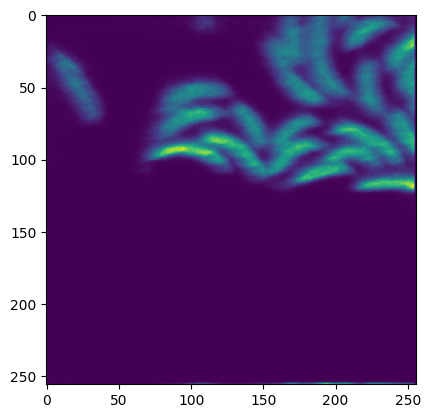

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


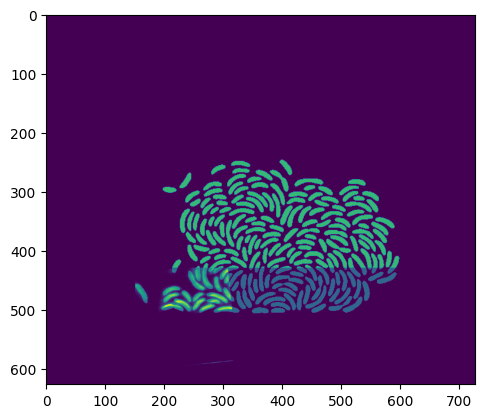

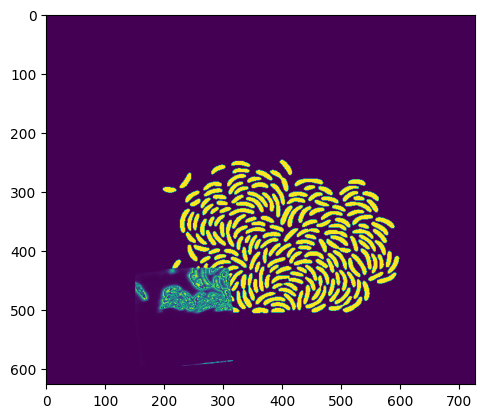

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     6
Scaling                                                   0.65
CrossCorr                                     595996199.999999
y                                                          430
x                                                          151
Name: 113, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


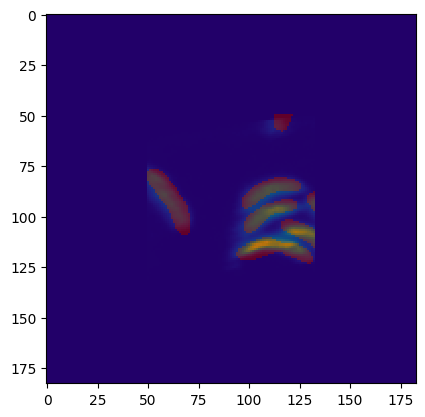

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          104802195.0
y                                                           51
x                                                           50
Name: 137, dtype: object
201 284 481 564
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


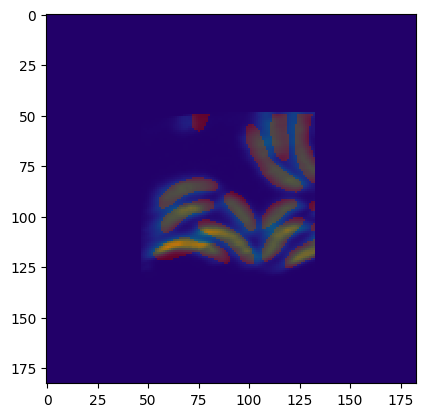

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     221650903.846154
y                                                           49
x                                                           47
Name: 139, dtype: object
239 322 479 562
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


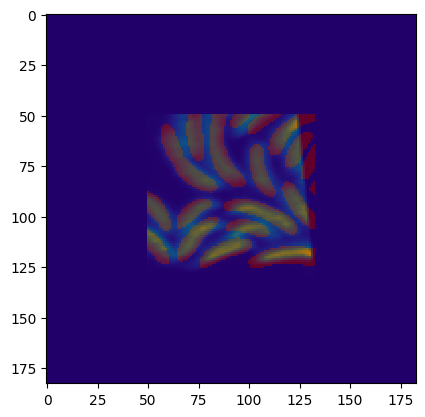

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          283569945.0
y                                                           50
x                                                           50
Name: 137, dtype: object
284 367 480 563
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


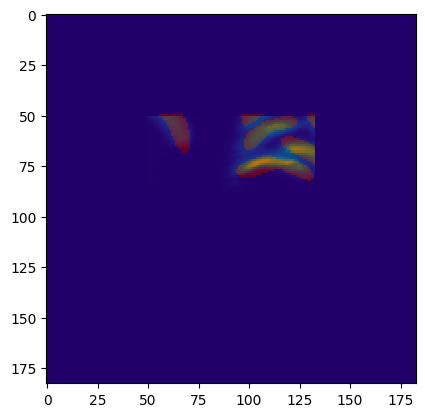

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           77109705.0
y                                                           51
x                                                           50
Name: 137, dtype: object
201 284 522 605
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


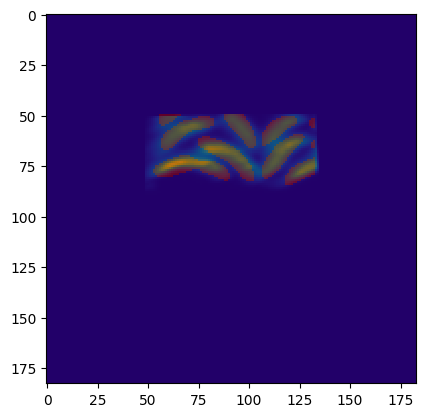

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                   1.04
CrossCorr                                     144246144.230769
y                                                           50
x                                                           49
Name: 161, dtype: object
241 324 521 604
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


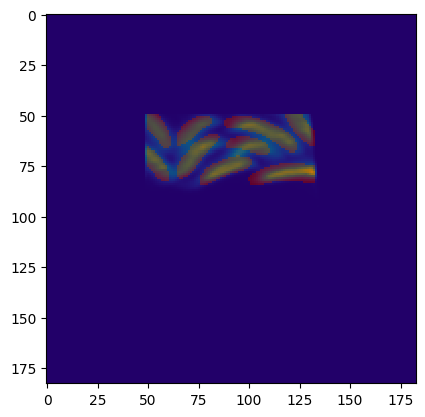

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     165057576.923077
y                                                           50
x                                                           49
Name: 139, dtype: object
283 366 521 604
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


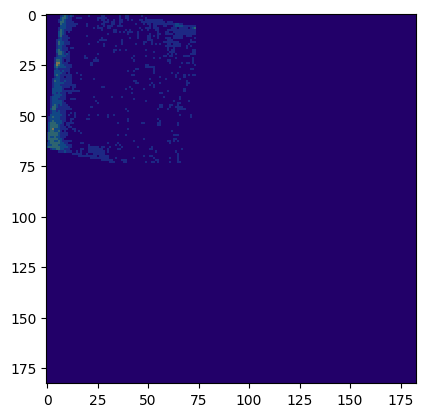

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
151 234 513 596
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


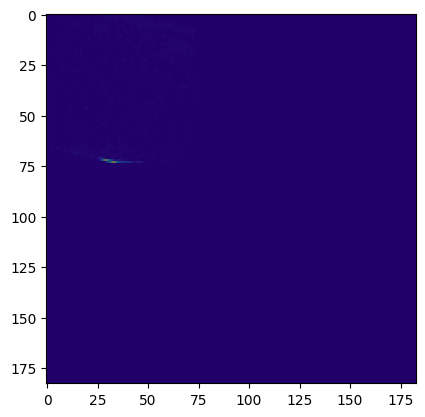

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
192 275 513 596
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


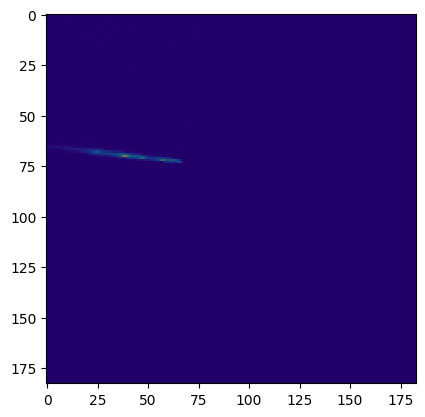

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
234 317 513 596
(727, 827)
(83, 83)


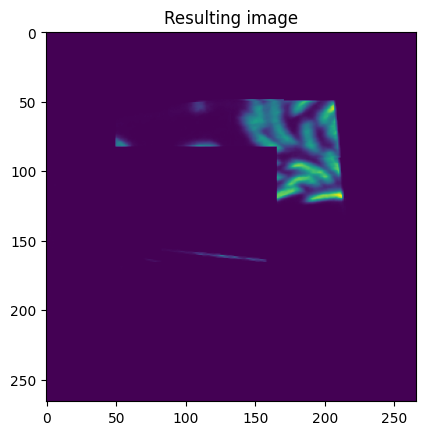

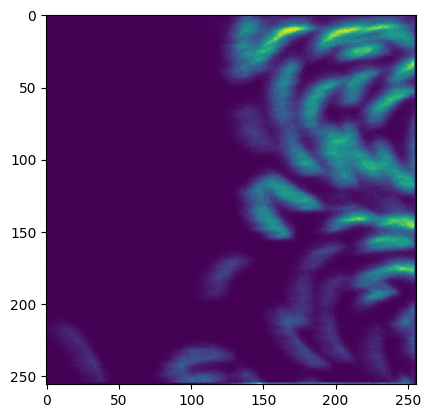

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


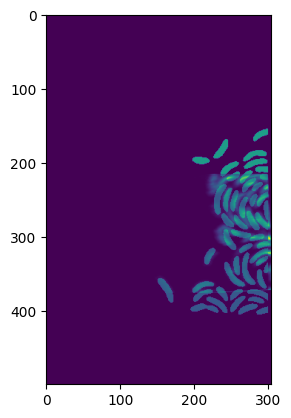

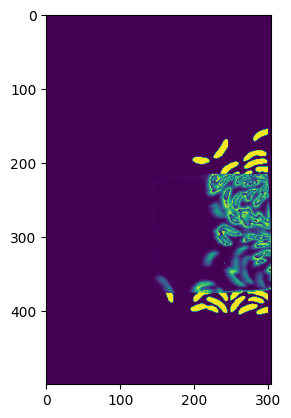

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                   0.63
CrossCorr                                      392962690.47619
y                                                          216
x                                                          143
Name: 93, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


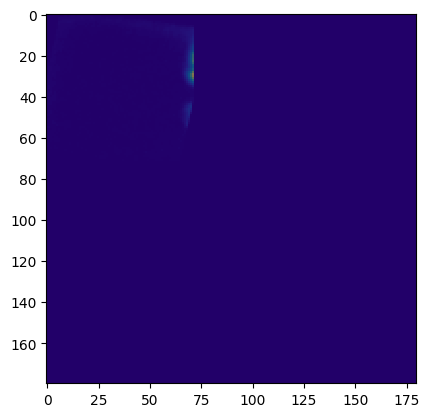

C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
143 223 216 296
(627, 827)
(80, 80)
75


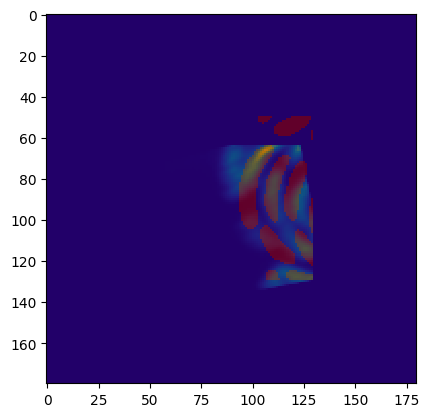

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    11
Scaling                                                    0.9
CrossCorr                                      60754033.333333
y                                                           64
x                                                           58
Name: 253, dtype: object
241 321 280 360
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


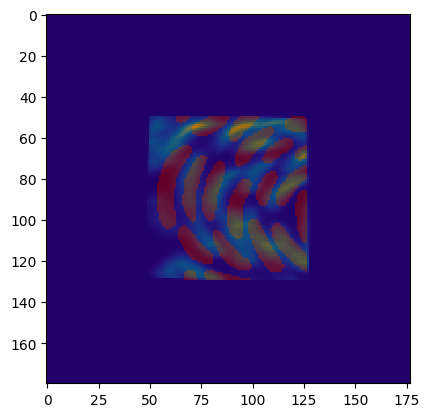

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    1.0
CrossCorr                                          153640560.0
y                                                           50
x                                                           49
Name: 115, dtype: object
272 352 266 346
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


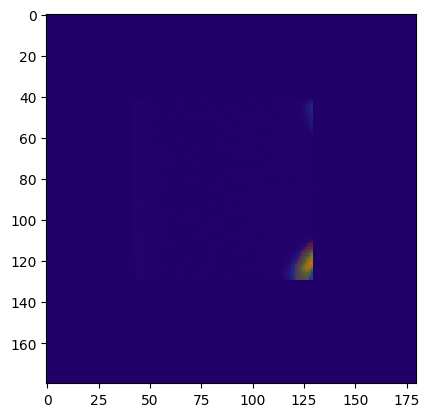

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       2582686.363636
y                                                           42
x                                                           42
Name: 142, dtype: object
185 265 298 378
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


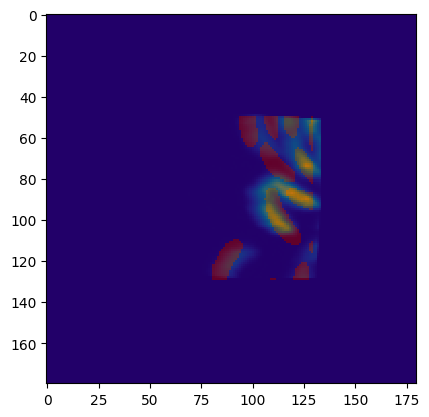

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -4
Scaling                                                    1.0
CrossCorr                                           43310220.0
y                                                           49
x                                                           54
Name: 93, dtype: object
237 317 305 385
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


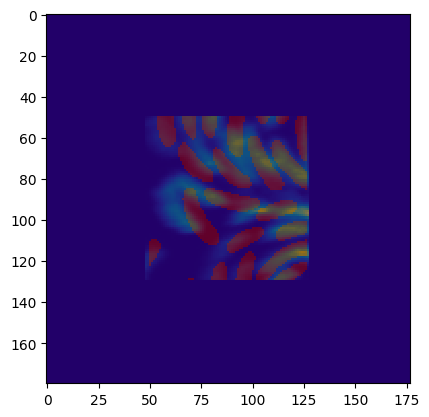

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          126797985.0
y                                                           50
x                                                           48
Name: 137, dtype: object
271 351 306 386
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


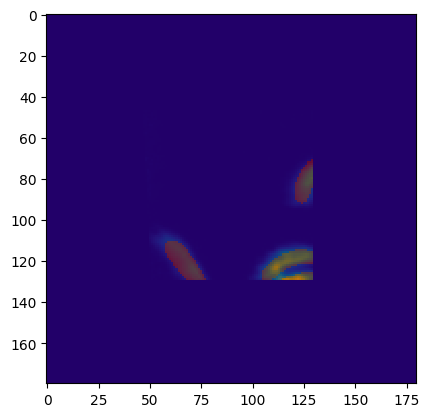

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      15477519.230769
y                                                           47
x                                                           47
Name: 139, dtype: object
190 270 343 423
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


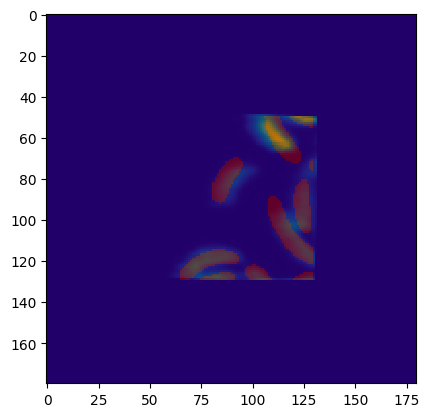

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                   1.02
CrossCorr                                           38963500.0
y                                                           49
x                                                           51
Name: 116, dtype: object
234 314 345 425
(627, 827)
(80, 80)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


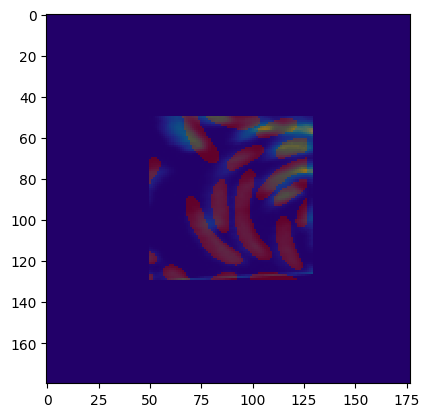

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           78168210.0
y                                                           50
x                                                           50
Name: 137, dtype: object
273 353 346 426
(627, 827)
(80, 80)


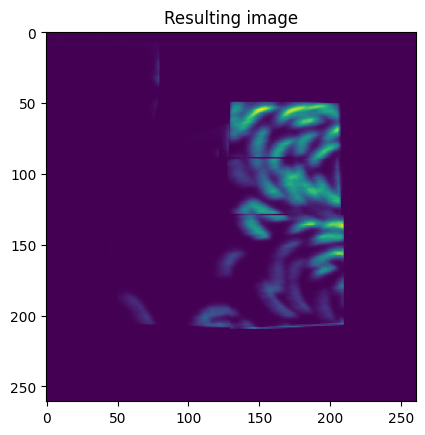

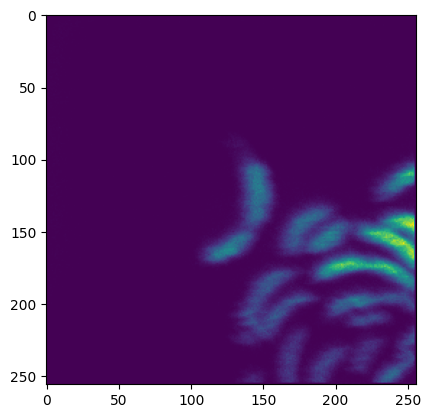

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


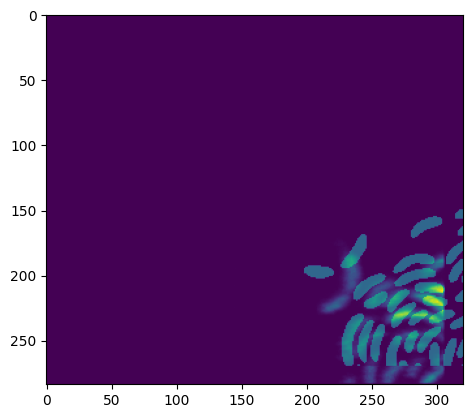

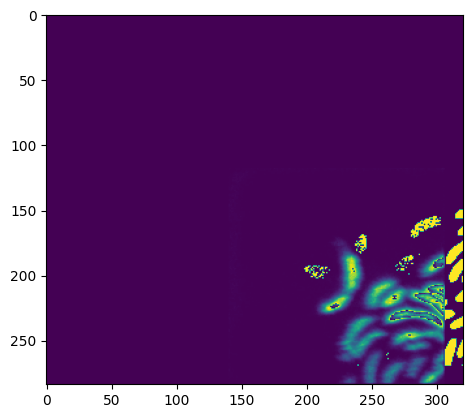

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                     115762546.153846
y                                                          118
x                                                          140
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


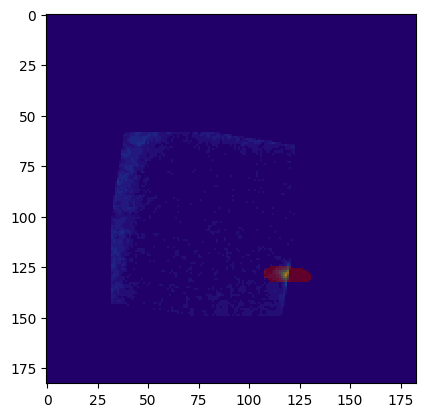

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -9
Scaling                                                    1.1
CrossCorr                                         64677.272727
y                                                           59
x                                                           32
Name: 43, dtype: object
172 255 177 260
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


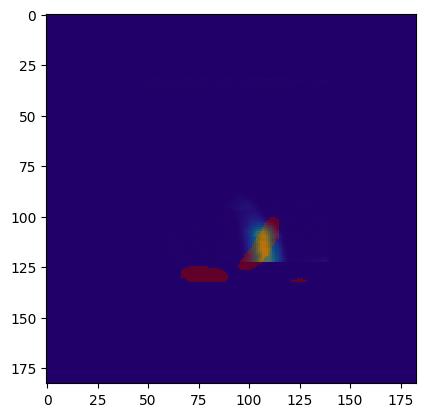

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       6379868.181818
y                                                           32
x                                                           49
Name: 142, dtype: object
230 313 150 233
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


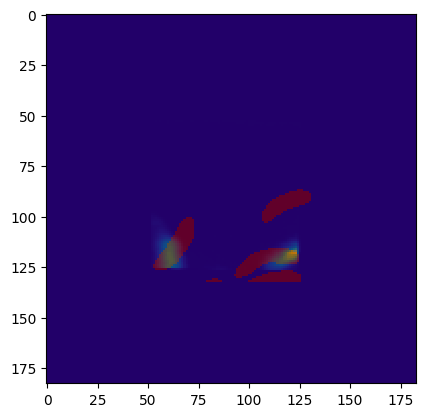

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    0.9
CrossCorr                                           10930150.0
y                                                           53
x                                                           52
Name: 110, dtype: object
275 358 171 254
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


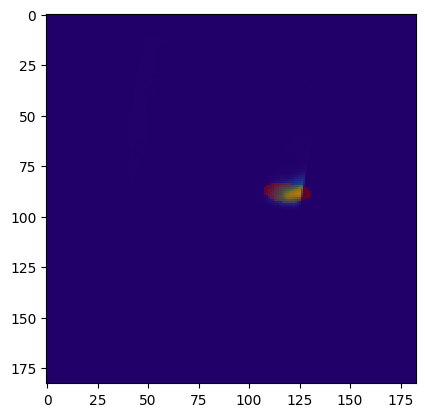

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -11
Scaling                                                    1.1
CrossCorr                                       4746013.636364
y                                                           10
x                                                           41
Name: 21, dtype: object
181 264 169 252
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


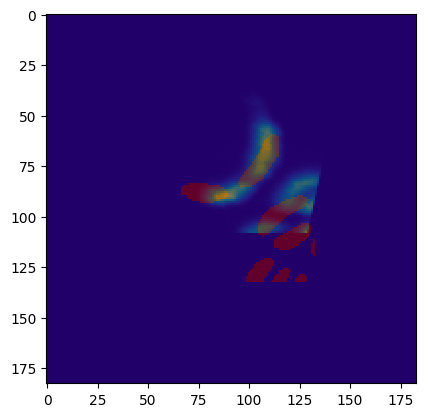

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    1.0
CrossCorr                                           17806395.0
y                                                           26
x                                                           54
Name: 5, dtype: object
235 318 185 268
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


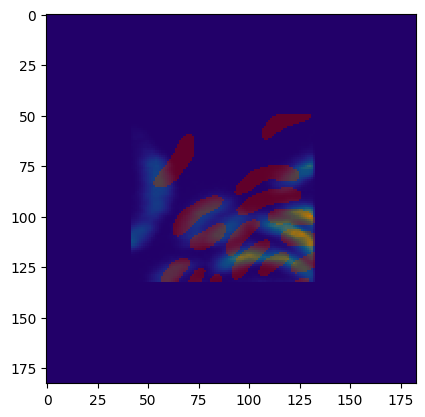

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      57452659.090909
y                                                           42
x                                                           42
Name: 142, dtype: object
265 348 201 284
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


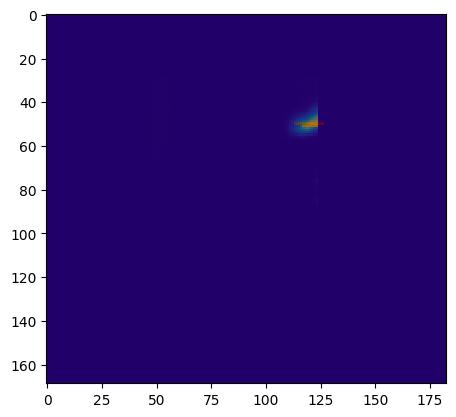

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.92
CrossCorr                                       1100380.434783
y                                                           29
x                                                           48
Name: 133, dtype: object
188 271 230 313
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


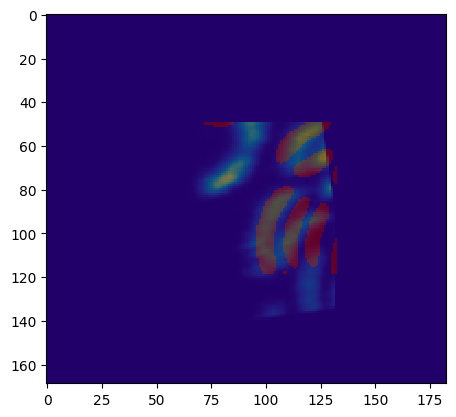

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     8
Scaling                                                    1.1
CrossCorr                                      21932318.181818
y                                                           50
x                                                           41
Name: 230, dtype: object
222 305 251 334
(627, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


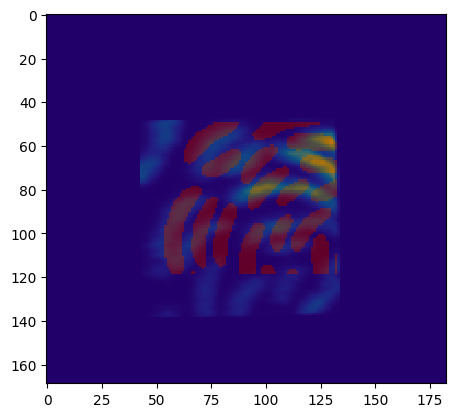

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.1
CrossCorr                                      68780686.363636
y                                                           48
x                                                           43
Name: 164, dtype: object
266 349 249 332
(627, 827)
(83, 83)


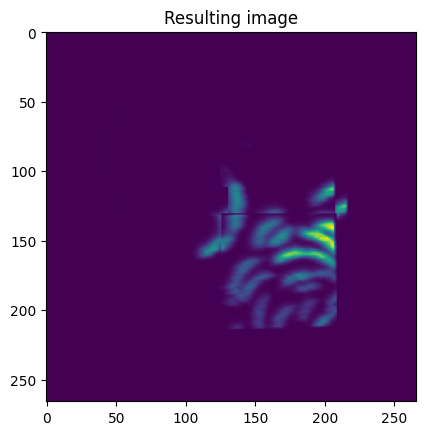

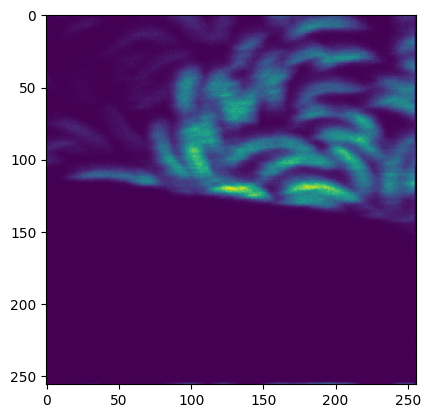

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


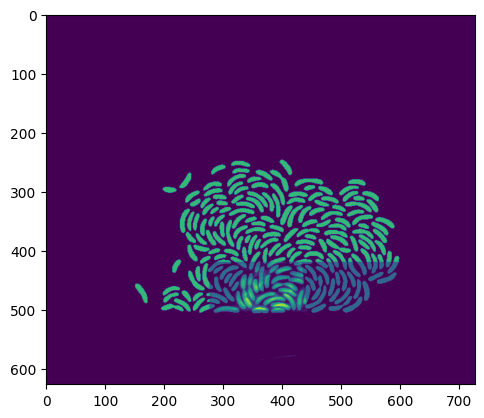

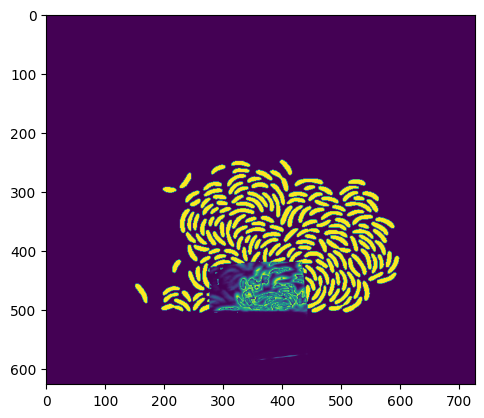

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     7
Scaling                                                   0.65
CrossCorr                                     509778738.461538
y                                                          420
x                                                          277
Name: 119, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


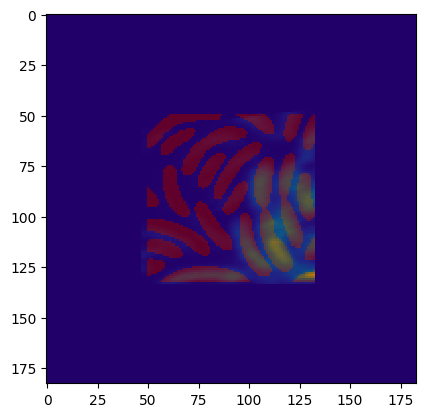

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     117709961.538462
y                                                           48
x                                                           47
Name: 139, dtype: object
324 407 468 551
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


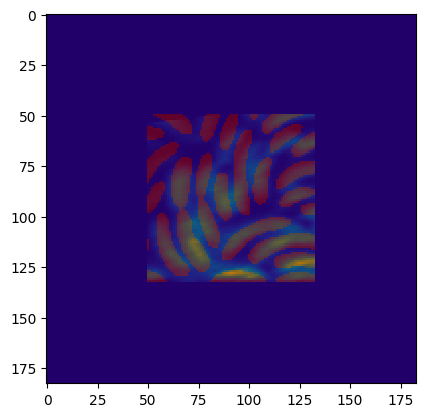

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          214954290.0
y                                                           50
x                                                           50
Name: 137, dtype: object
368 451 470 553
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


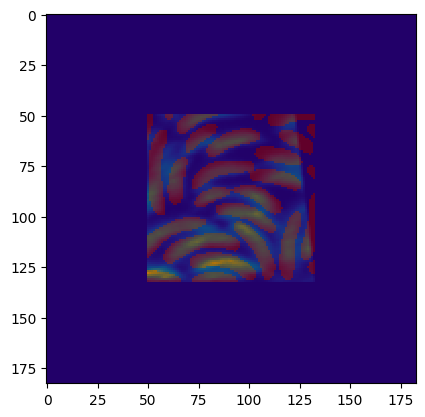

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          214905840.0
y                                                           50
x                                                           50
Name: 137, dtype: object
410 493 470 553
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


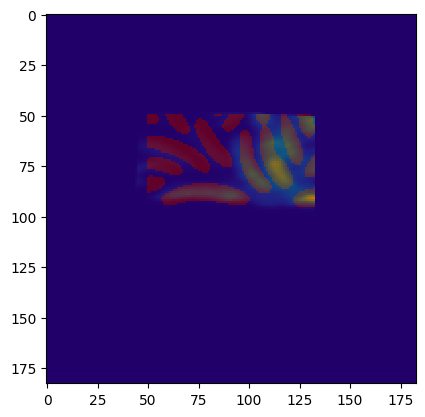

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -3
Scaling                                                   1.08
CrossCorr                                      87929430.555556
y                                                           49
x                                                           44
Name: 108, dtype: object
321 404 510 593
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


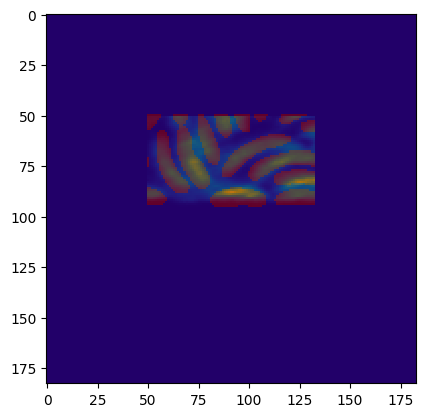

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          146968740.0
y                                                           51
x                                                           50
Name: 137, dtype: object
368 451 512 595
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


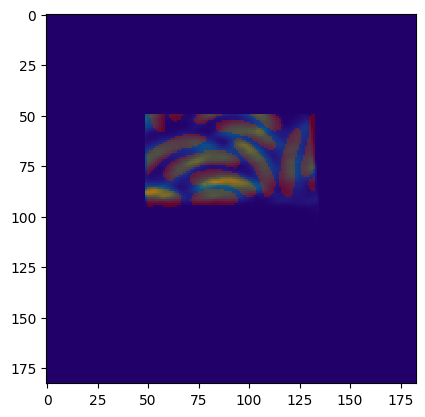

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     144323379.807692
y                                                           50
x                                                           49
Name: 139, dtype: object
409 492 511 594
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


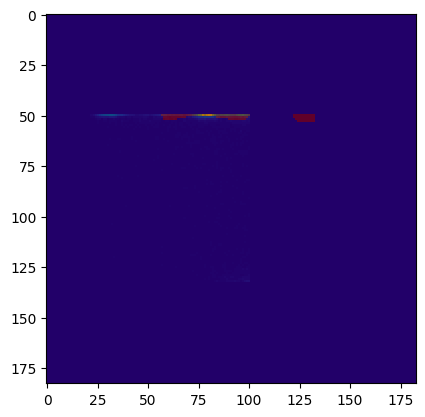

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                             374340.0
y                                                           50
x                                                           18
Name: 137, dtype: object
295 378 553 636
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


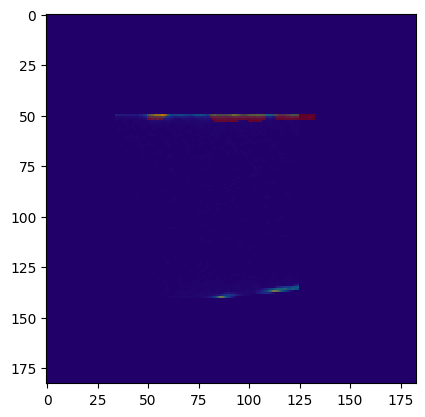

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                             696150.0
y                                                           50
x                                                           34
Name: 142, dtype: object
352 435 553 636
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


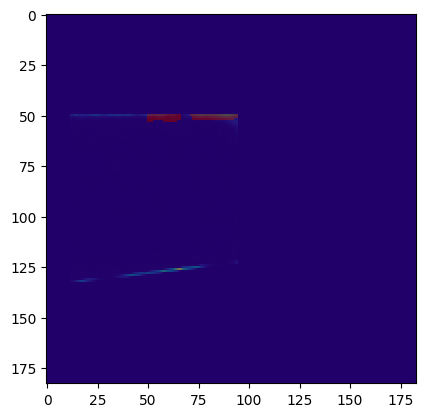

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                             789990.0
y                                                           50
x                                                           12
Name: 137, dtype: object
372 455 553 636
(727, 827)
(83, 83)


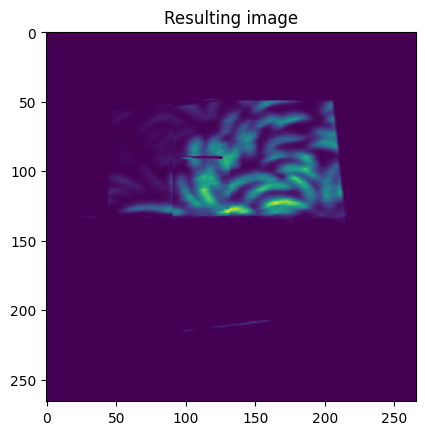

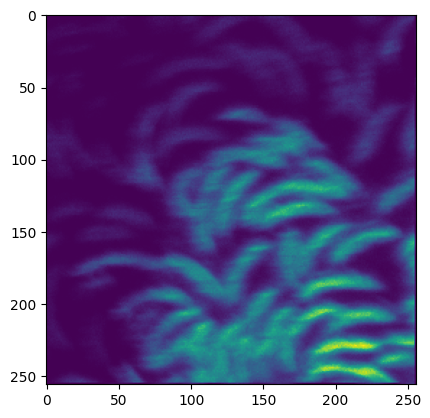

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


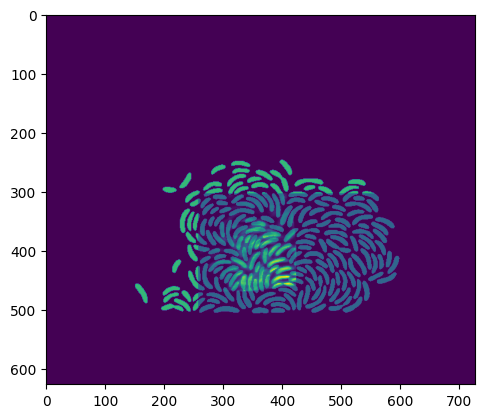

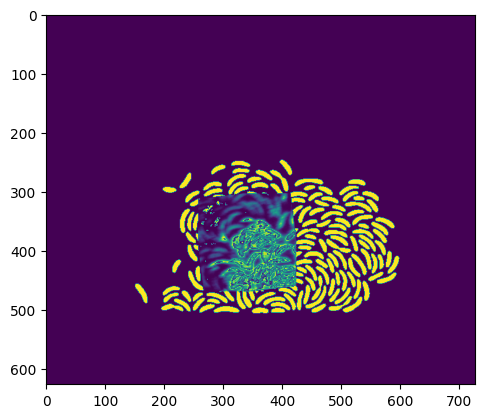

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     7
Scaling                                                   0.65
CrossCorr                                     971573146.153845
y                                                          304
x                                                          258
Name: 119, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


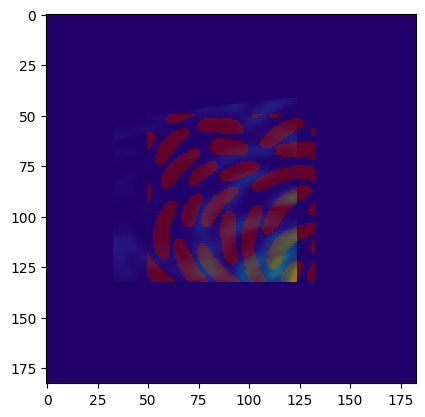

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      47135359.090909
y                                                           42
x                                                           33
Name: 142, dtype: object
291 374 346 429
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


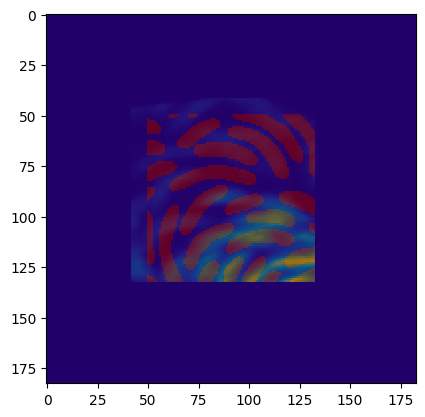

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                     112877836.363636
y                                                           42
x                                                           42
Name: 142, dtype: object
341 424 346 429
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


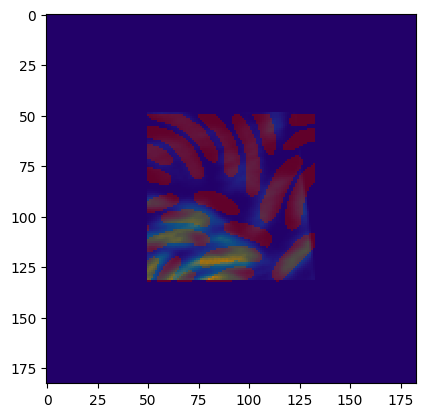

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          127239645.0
y                                                           49
x                                                           50
Name: 137, dtype: object
391 474 353 436
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


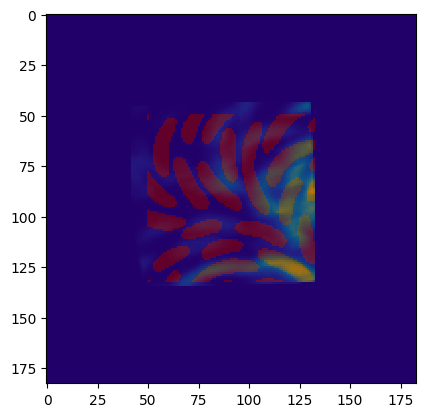

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                    1.1
CrossCorr                                      88646113.636364
y                                                           44
x                                                           42
Name: 175, dtype: object
300 383 389 472
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


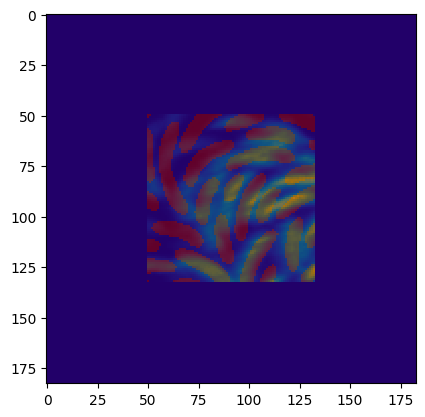

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          207427200.0
y                                                           50
x                                                           50
Name: 137, dtype: object
349 432 395 478
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


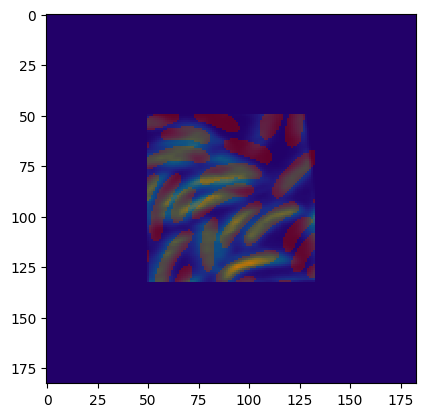

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          240940320.0
y                                                           50
x                                                           50
Name: 148, dtype: object
391 474 395 478
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


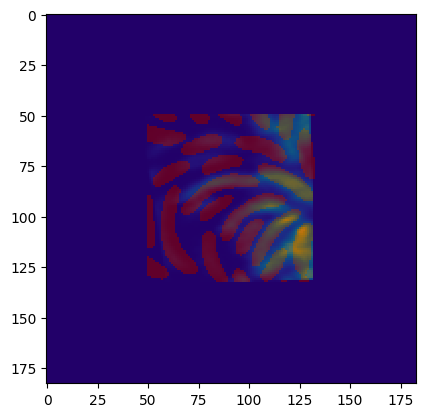

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                          125547465.0
y                                                           50
x                                                           49
Name: 159, dtype: object
307 390 437 520
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


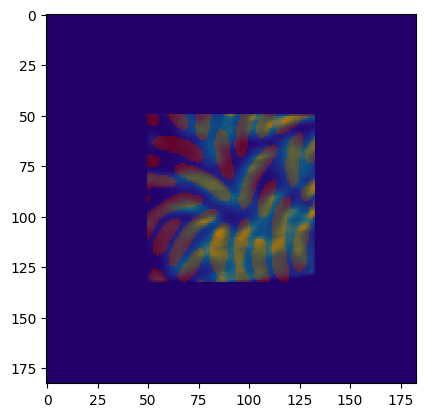

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                    1.0
CrossCorr                                          274217310.0
y                                                           50
x                                                           50
Name: 126, dtype: object
349 432 437 520
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


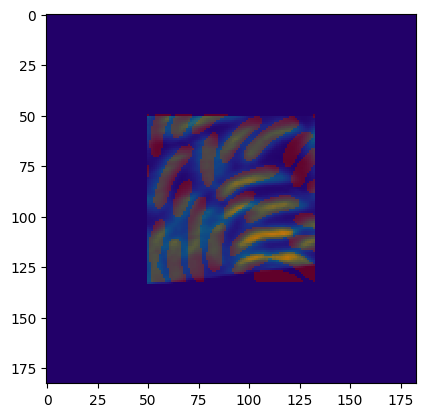

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          340099110.0
y                                                           51
x                                                           50
Name: 137, dtype: object
391 474 438 521
(727, 827)
(83, 83)


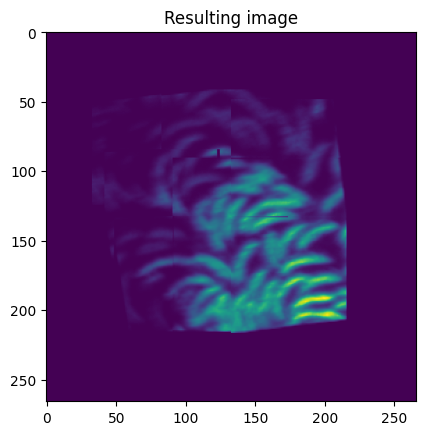

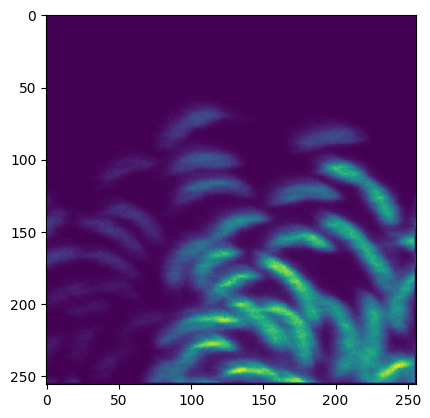

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


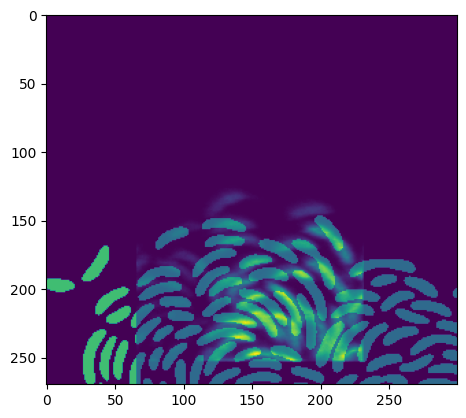

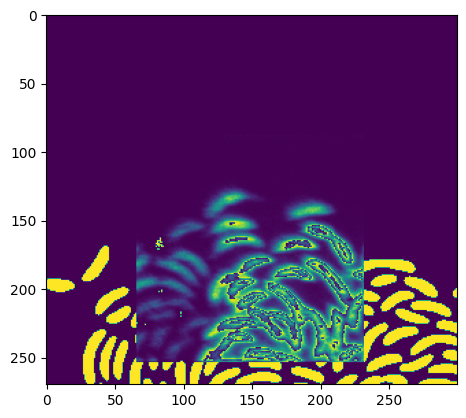

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                     526074807.692308
y                                                           88
x                                                           66
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


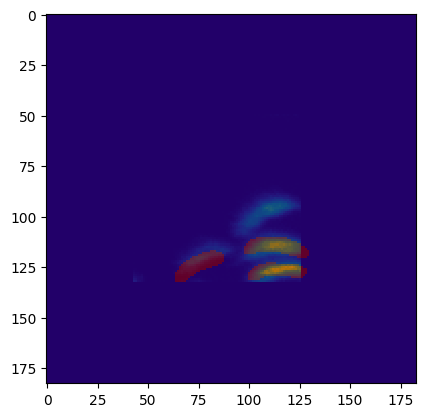

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           16703520.0
y                                                           50
x                                                           43
Name: 137, dtype: object
109 192 138 221
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


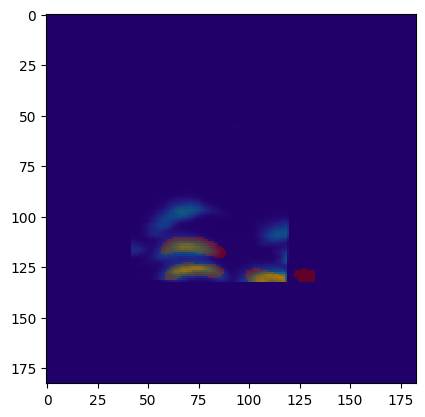

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                   0.94
CrossCorr                                      22001345.744681
y                                                           55
x                                                           42
Name: 112, dtype: object
149 232 143 226
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


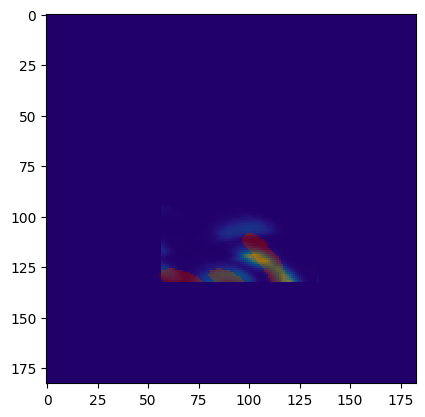

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.94
CrossCorr                                      22514872.340426
y                                                           55
x                                                           57
Name: 134, dtype: object
206 289 143 226
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


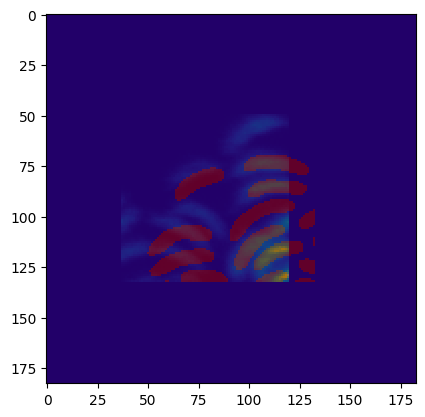

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           50071035.0
y                                                           50
x                                                           37
Name: 137, dtype: object
103 186 179 262
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


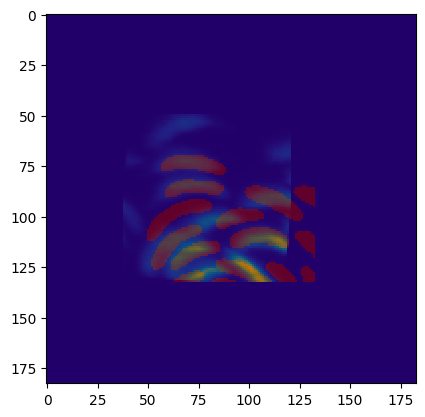

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -5
Scaling                                                    1.0
CrossCorr                                           94132230.0
y                                                           50
x                                                           38
Name: 82, dtype: object
145 228 179 262
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


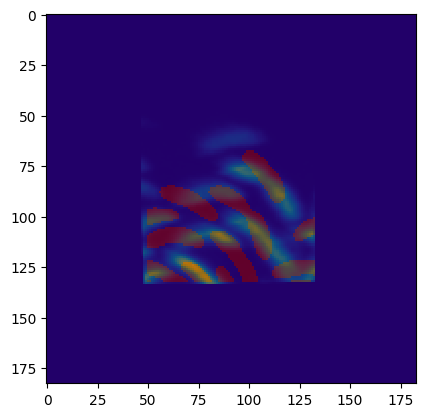

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                   1.04
CrossCorr                                      96032509.615385
y                                                           48
x                                                           47
Name: 161, dtype: object
196 279 177 260
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


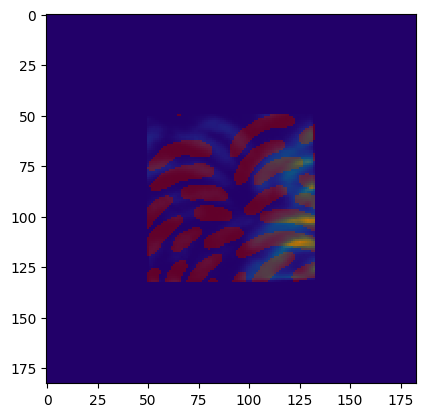

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                           85028730.0
y                                                           50
x                                                           50
Name: 159, dtype: object
116 199 221 304
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


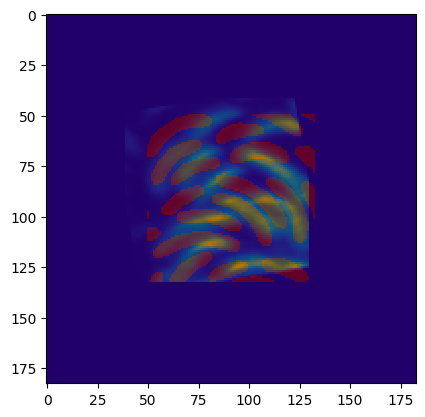

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    10
Scaling                                                    1.1
CrossCorr                                          197306250.0
y                                                           42
x                                                           39
Name: 252, dtype: object
146 229 213 296
(627, 627)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


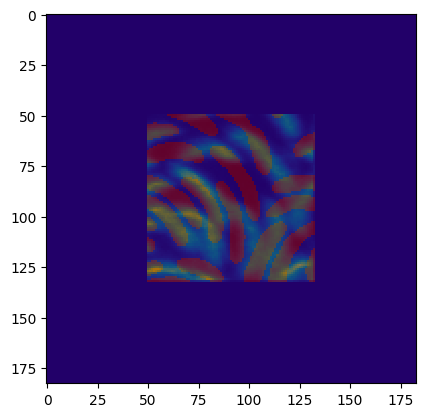

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          223511070.0
y                                                           50
x                                                           50
Name: 137, dtype: object
199 282 221 304
(627, 627)
(83, 83)


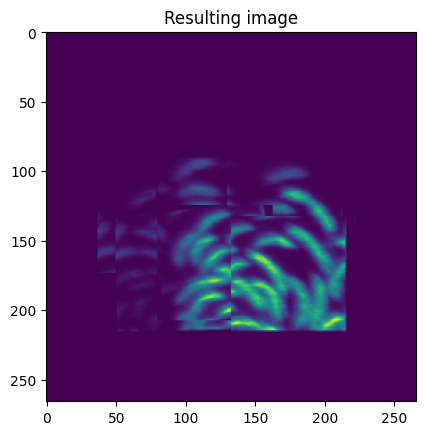

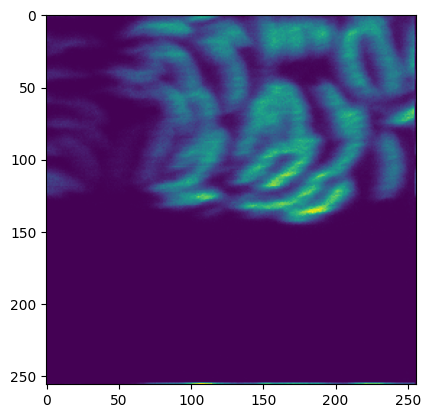

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


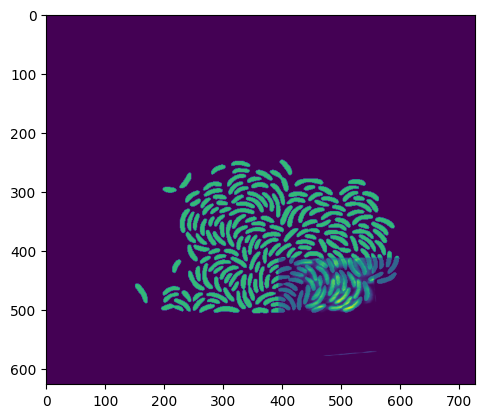

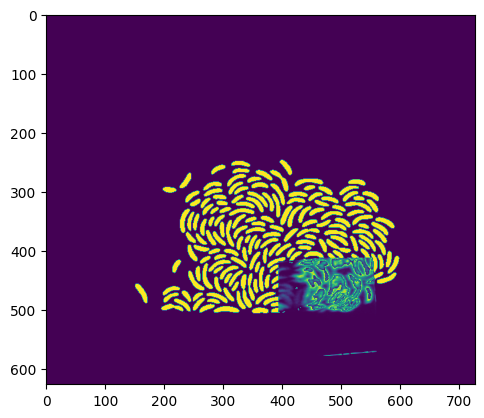

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     5
Scaling                                                   0.65
CrossCorr                                     585569838.461538
y                                                          413
x                                                          394
Name: 107, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


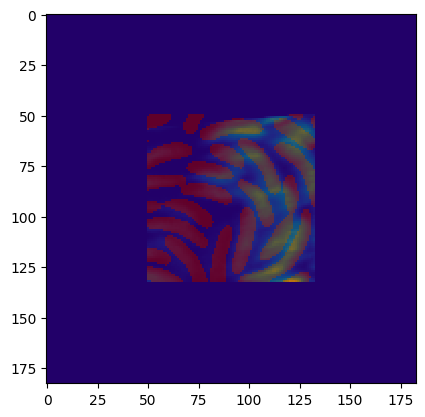

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          128260155.0
y                                                           50
x                                                           50
Name: 137, dtype: object
444 527 463 546
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


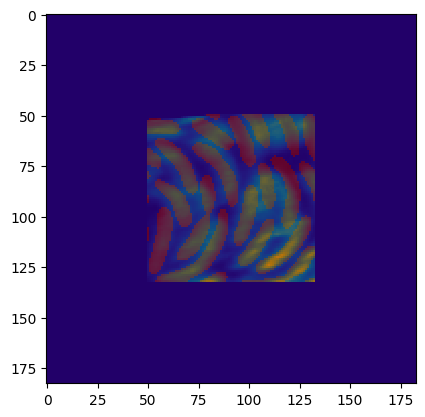

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          245136345.0
y                                                           50
x                                                           50
Name: 137, dtype: object
485 568 463 546
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


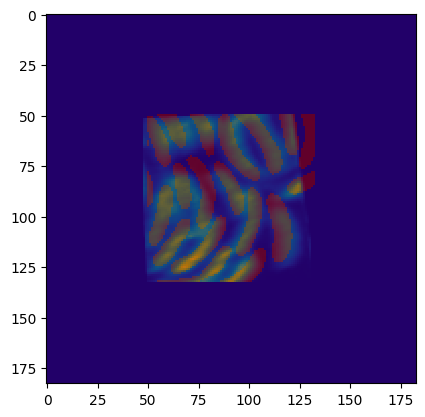

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     3
Scaling                                                    1.0
CrossCorr                                          223599045.0
y                                                           50
x                                                           48
Name: 170, dtype: object
525 608 463 546
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


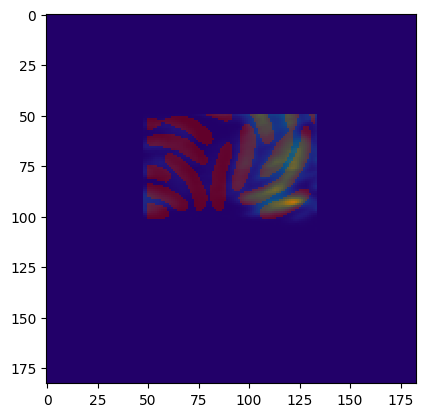

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      71357091.346154
y                                                           50
x                                                           48
Name: 139, dtype: object
442 525 504 587
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


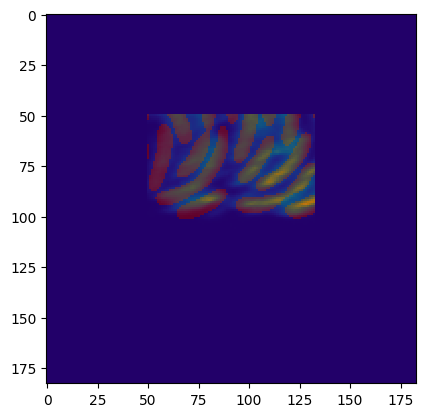

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          166090170.0
y                                                           50
x                                                           50
Name: 137, dtype: object
485 568 504 587
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


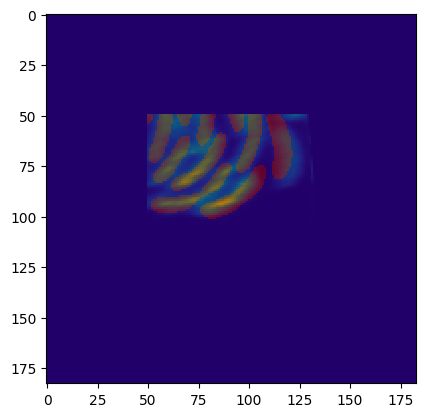

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          148546680.0
y                                                           50
x                                                           50
Name: 137, dtype: object
527 610 504 587
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


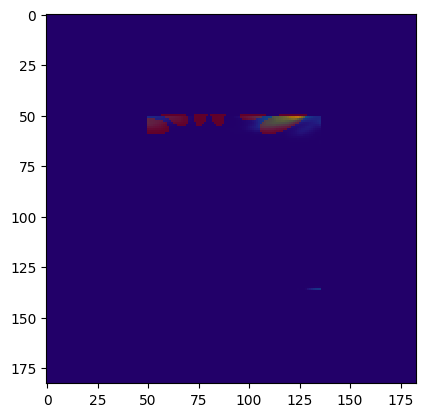

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                       9767971.153846
y                                                           51
x                                                           50
Name: 139, dtype: object
444 527 547 630
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


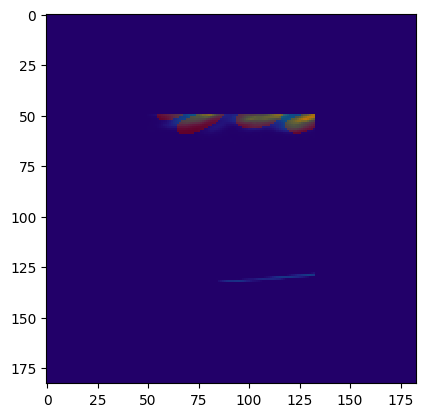

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           29745495.0
y                                                           50
x                                                           50
Name: 137, dtype: object
485 568 546 629
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


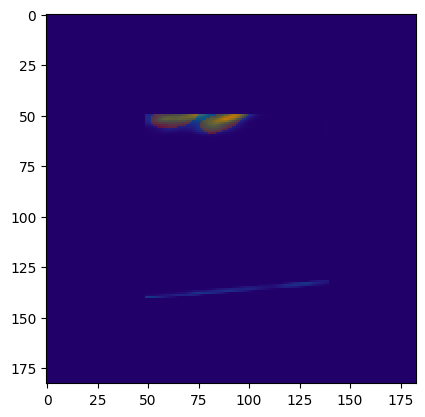

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      25336336.363636
y                                                           50
x                                                           49
Name: 142, dtype: object
526 609 546 629
(727, 827)
(83, 83)


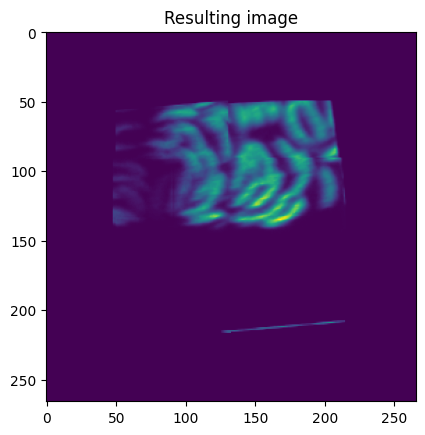

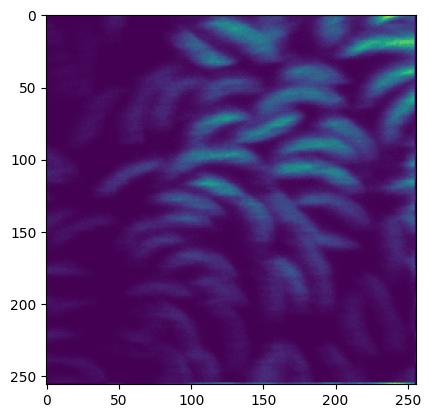

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


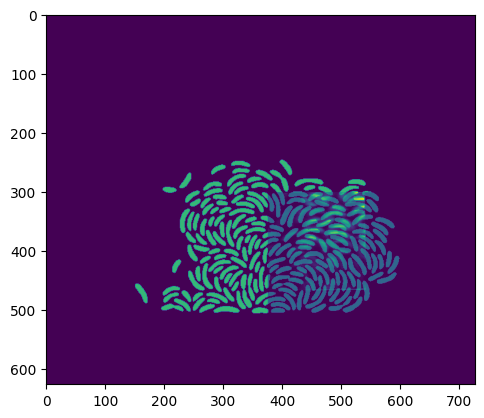

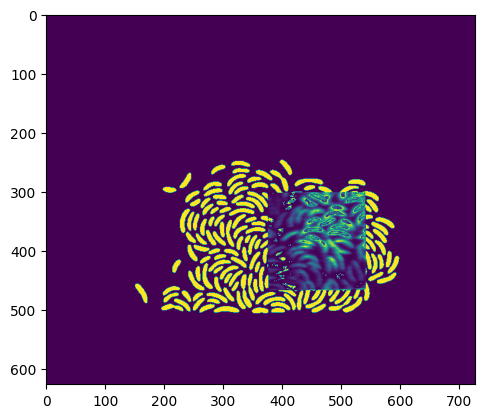

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                   0.65
CrossCorr                                     478759361.538461
y                                                          302
x                                                          376
Name: 83, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


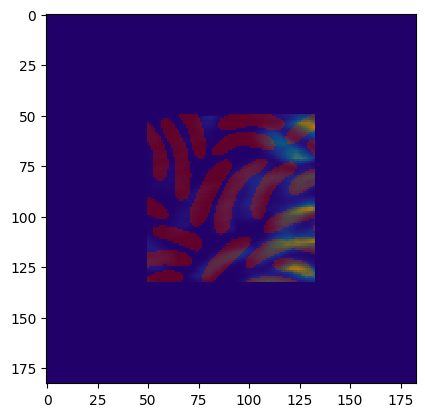

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           66608550.0
y                                                           50
x                                                           50
Name: 137, dtype: object
426 509 352 435
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


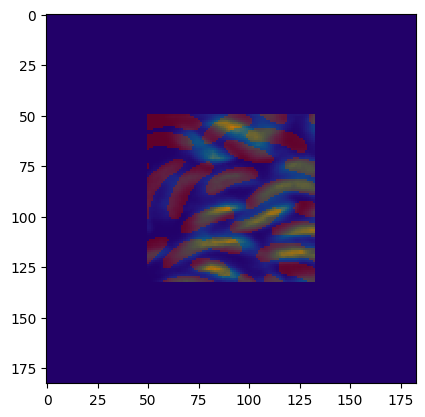

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          137830050.0
y                                                           50
x                                                           50
Name: 137, dtype: object
467 550 352 435
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


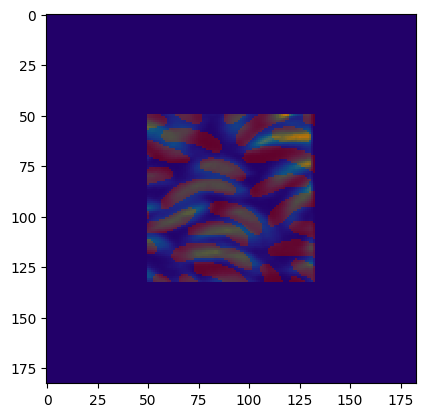

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          162487785.0
y                                                           50
x                                                           50
Name: 137, dtype: object
509 592 352 435
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


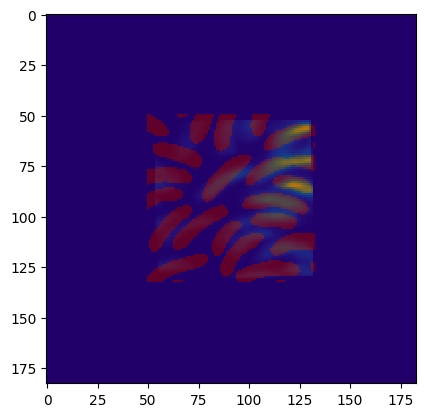

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                   0.94
CrossCorr                                      63765734.042553
y                                                           53
x                                                           54
Name: 156, dtype: object
430 513 396 479
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


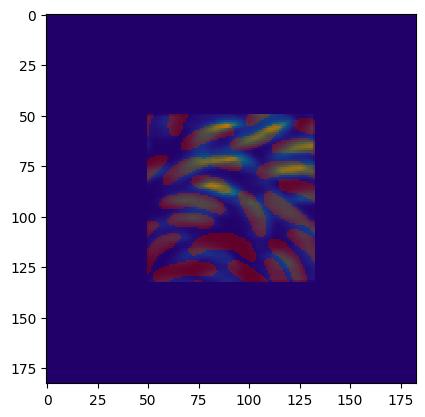

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     1
Scaling                                                    1.0
CrossCorr                                          120679770.0
y                                                           50
x                                                           50
Name: 148, dtype: object
467 550 393 476
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


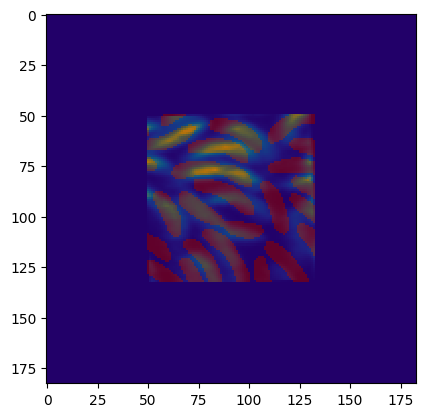

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     2
Scaling                                                    1.0
CrossCorr                                          116594415.0
y                                                           50
x                                                           50
Name: 159, dtype: object
509 592 393 476
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


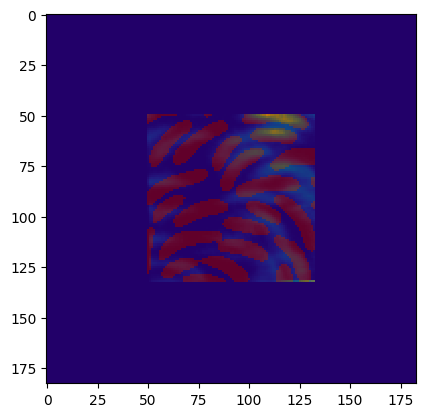

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           29971935.0
y                                                           50
x                                                           50
Name: 137, dtype: object
426 509 435 518
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


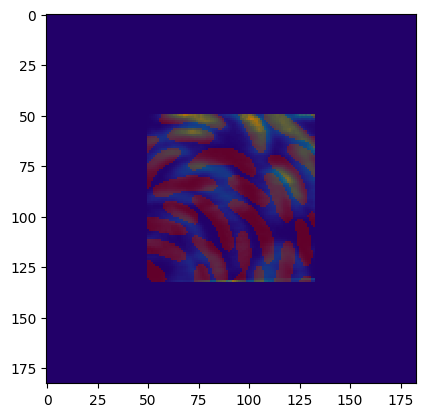

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           58474560.0
y                                                           50
x                                                           50
Name: 137, dtype: object
467 550 435 518
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


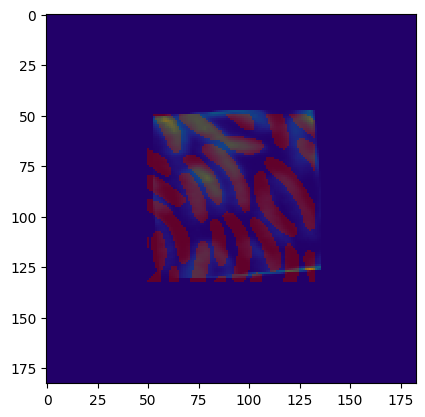

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     5
Scaling                                                    1.0
CrossCorr                                           52383885.0
y                                                           48
x                                                           53
Name: 192, dtype: object
512 595 433 516
(727, 827)
(83, 83)


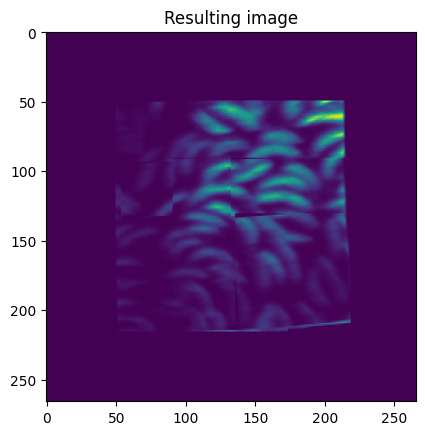

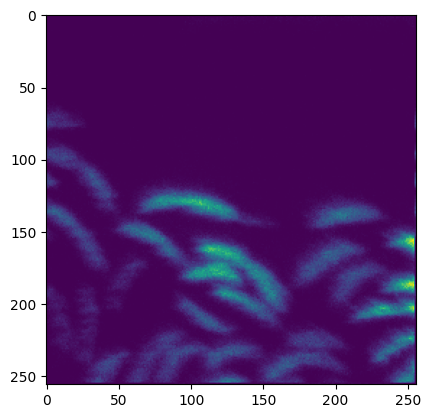

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


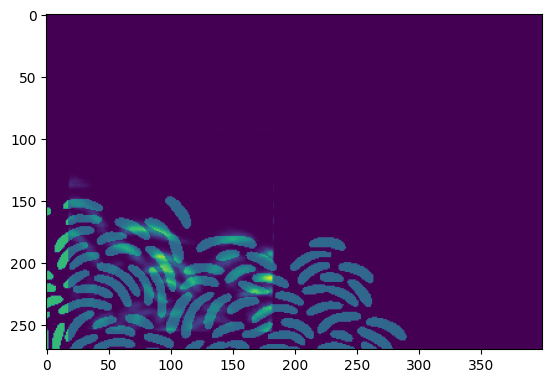

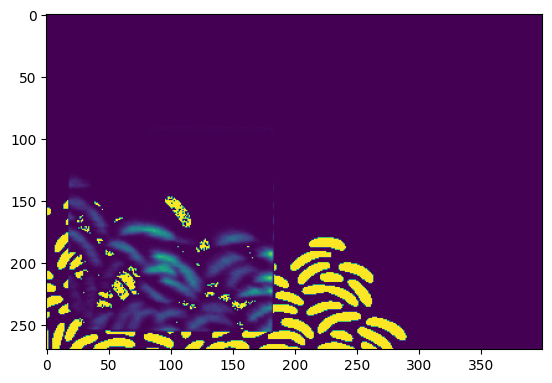

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -1
Scaling                                                   0.65
CrossCorr                                      72920976.923077
y                                                           90
x                                                           18
Name: 71, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


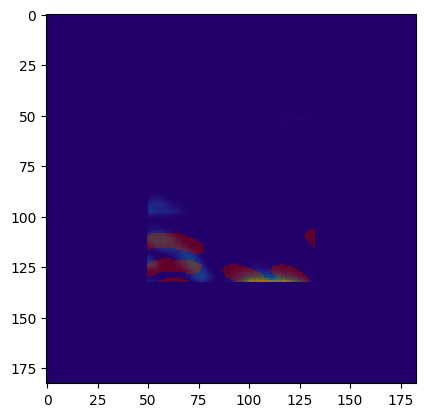

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                            3873195.0
y                                                           50
x                                                           50
Name: 137, dtype: object
68 151 140 223
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


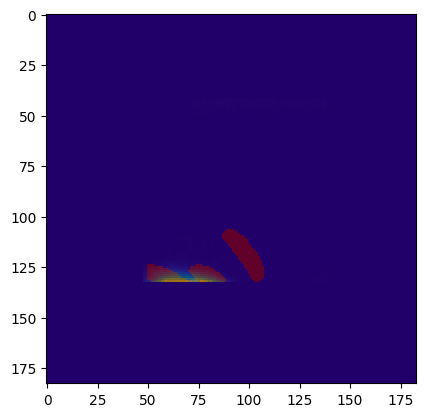

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       2203895.454545
y                                                           42
x                                                           48
Name: 142, dtype: object
107 190 132 215
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


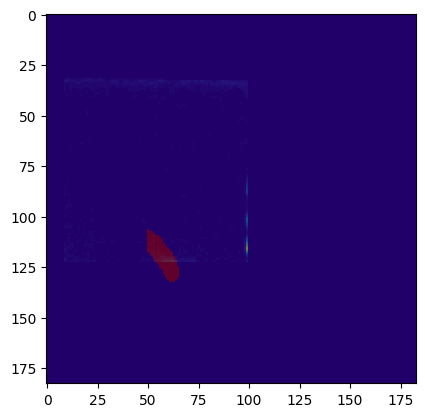

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                         36163.636364
y                                                           32
x                                                            9
Name: 142, dtype: object
110 193 122 205
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


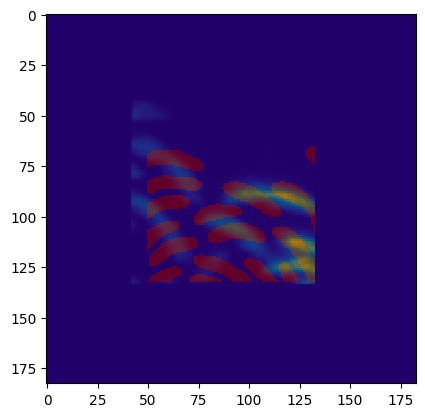

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      18197727.272727
y                                                           43
x                                                           42
Name: 142, dtype: object
60 143 174 257
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


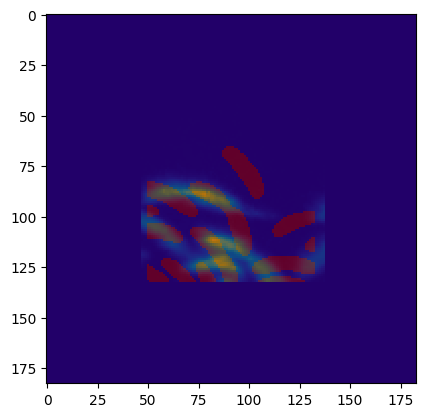

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      17954318.181818
y                                                           42
x                                                           47
Name: 142, dtype: object
106 189 173 256
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


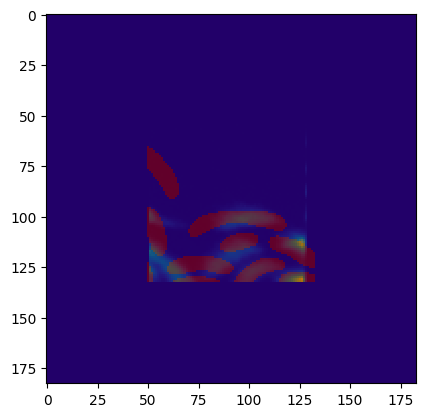

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.94
CrossCorr                                       12127148.93617
y                                                           55
x                                                           51
Name: 134, dtype: object
152 235 186 269
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


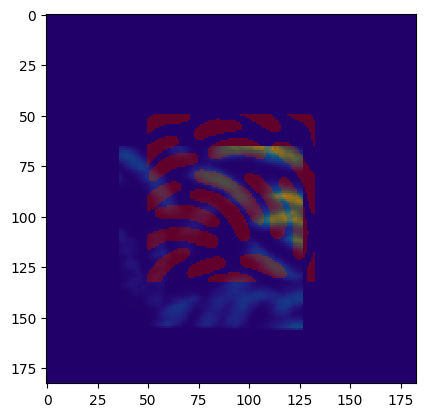

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                           19902750.0
y                                                           66
x                                                           36
Name: 142, dtype: object
54 137 239 322
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


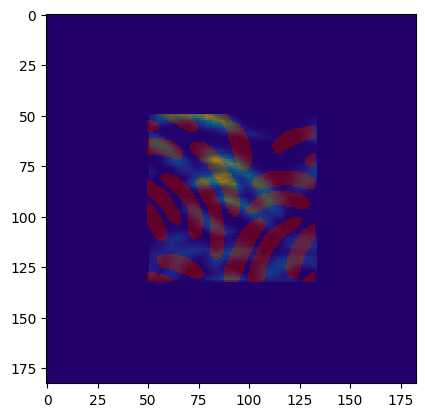

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           25001475.0
y                                                           50
x                                                           51
Name: 137, dtype: object
110 193 223 306
(627, 527)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


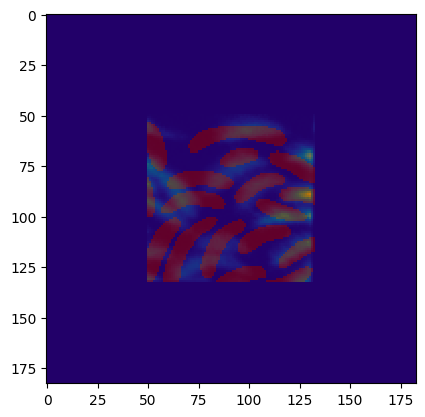

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           23841480.0
y                                                           50
x                                                           50
Name: 137, dtype: object
151 234 223 306
(627, 527)
(83, 83)


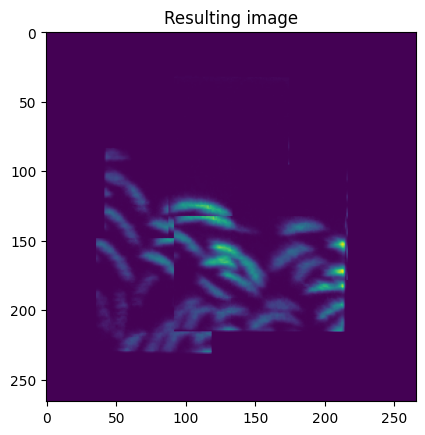

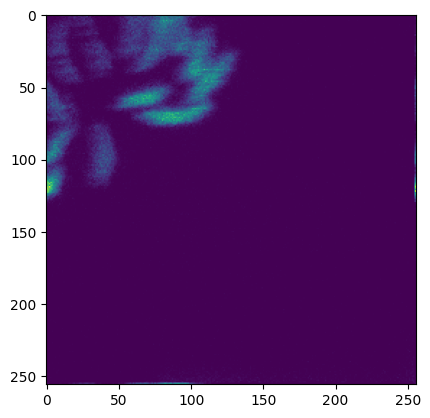

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


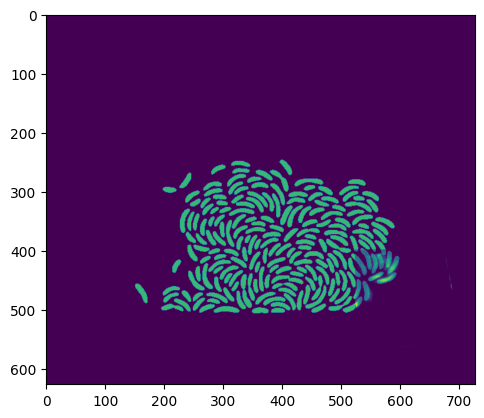

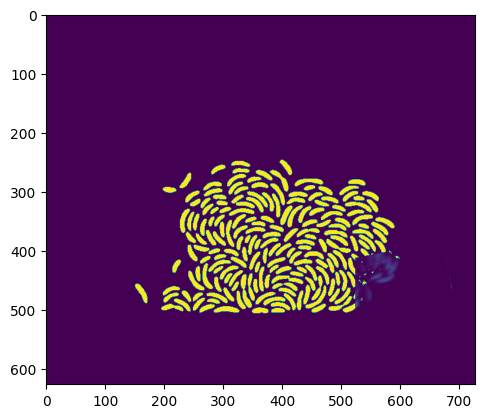

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    11
Scaling                                                   0.65
CrossCorr                                      18743676.923077
y                                                          399
x                                                          524
Name: 143, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


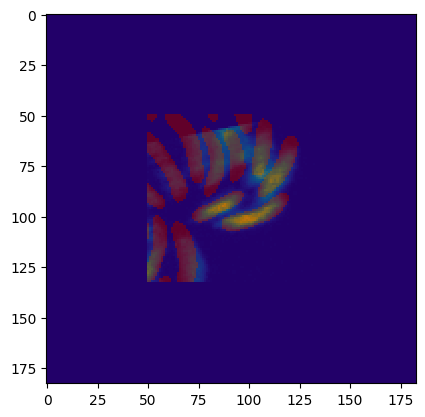

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                           11305680.0
y                                                           50
x                                                           50
Name: 137, dtype: object
574 657 449 532
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


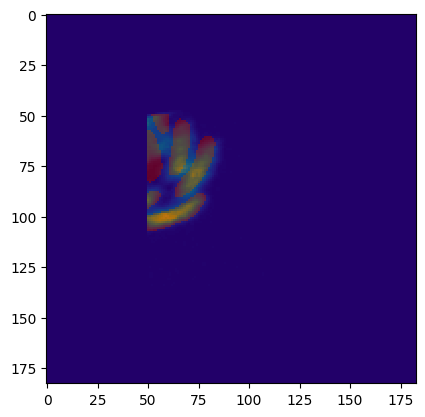

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       6461931.818182
y                                                           44
x                                                           50
Name: 142, dtype: object
615 698 443 526
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


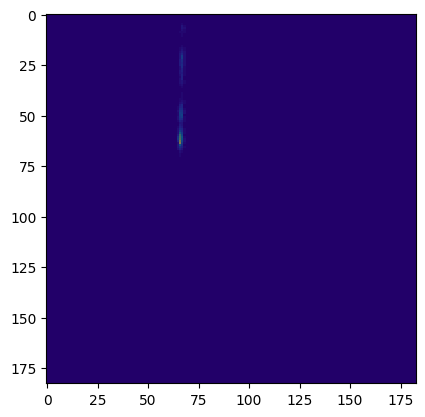

C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
607 690 399 482
(727, 827)
(83, 83)
75


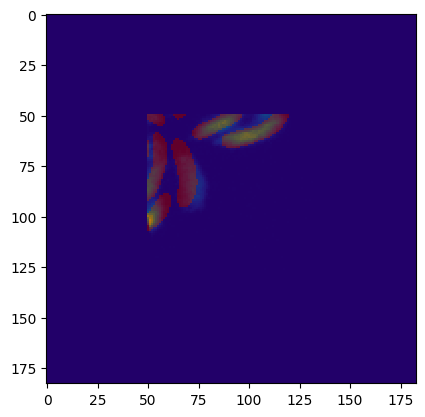

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                            6104700.0
y                                                           50
x                                                           50
Name: 137, dtype: object
574 657 490 573
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


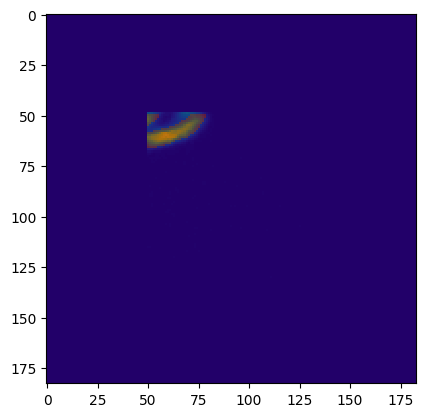

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                       2415777.272727
y                                                           49
x                                                           50
Name: 142, dtype: object
615 698 489 572
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


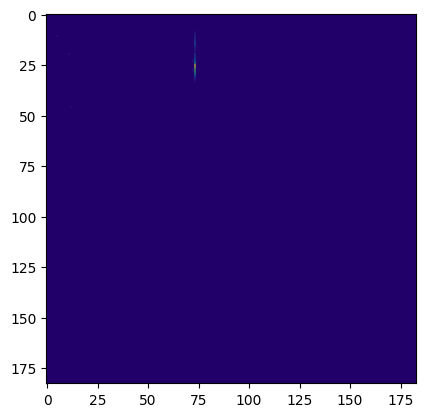

C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
607 690 440 523
(727, 827)
(83, 83)
75


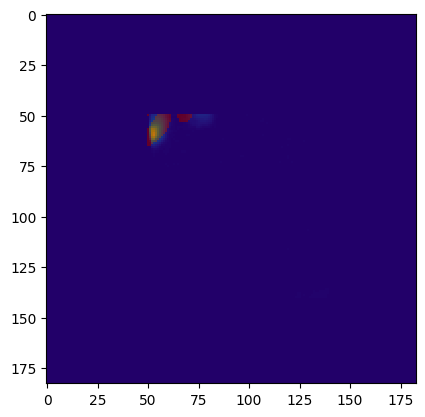

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    -2
Scaling                                                    1.1
CrossCorr                                        892268.181818
y                                                           50
x                                                           50
Name: 120, dtype: object
574 657 532 615
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


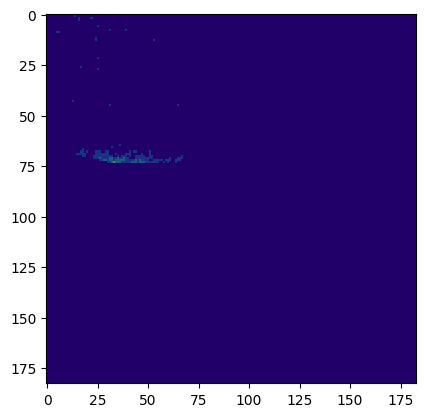

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
565 648 482 565
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:348: RuntimeWarning: divide by zero encountered in floor_divide
  image1 = (np.array(image1,dtype=np.uint)*256)//np.max(image1)


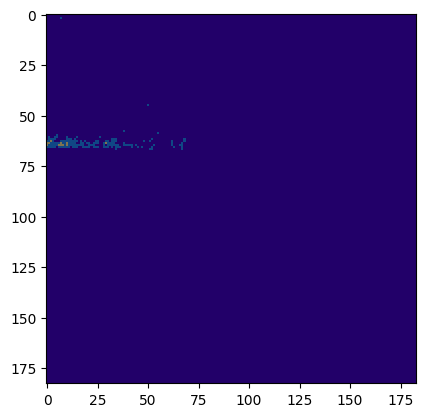

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                   -12
Scaling                                                    0.9
CrossCorr                                                  0.0
y                                                            0
x                                                            0
Name: 0, dtype: object
607 690 482 565
(727, 827)
(83, 83)


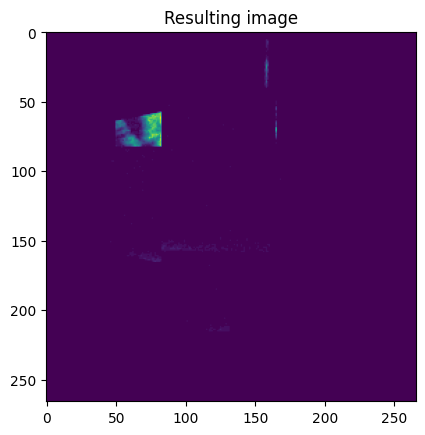

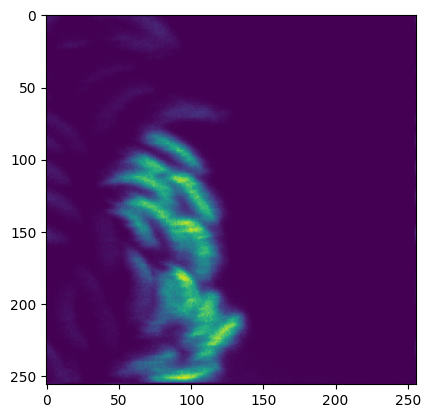

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


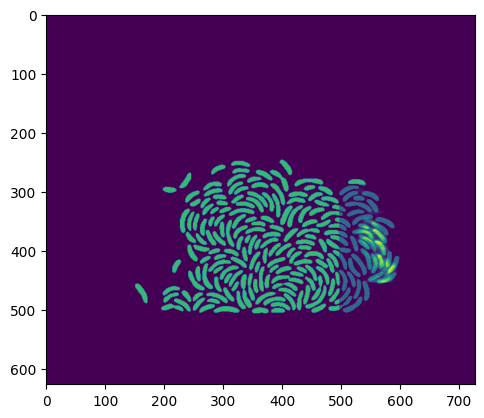

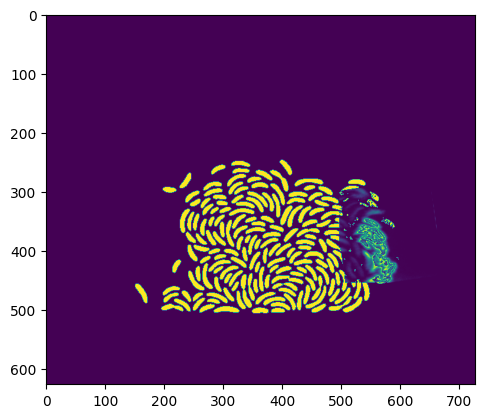

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     8
Scaling                                                   0.65
CrossCorr                                     315739038.461538
y                                                          289
x                                                          497
Name: 125, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


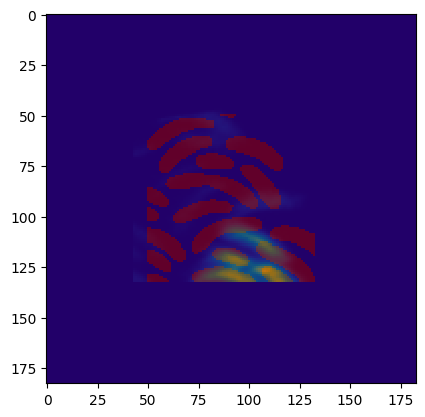

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      48257822.727273
y                                                           42
x                                                           43
Name: 142, dtype: object
540 623 331 414
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


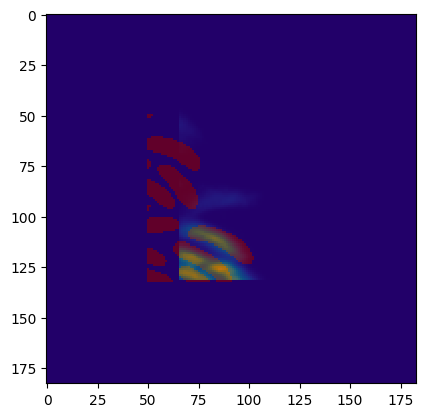

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      40092259.090909
y                                                           41
x                                                           66
Name: 142, dtype: object
604 687 330 413
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


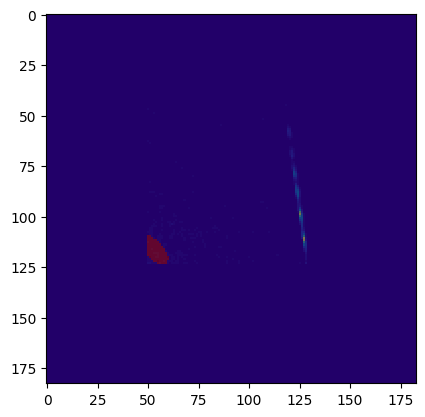

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.96
CrossCorr                                            28421.875
y                                                           45
x                                                           50
Name: 135, dtype: object
630 713 334 417
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


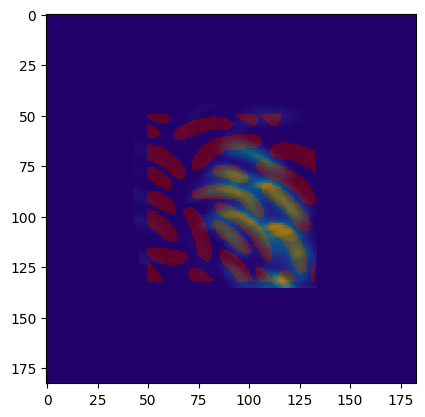

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                          125225400.0
y                                                           45
x                                                           43
Name: 142, dtype: object
540 623 375 458
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


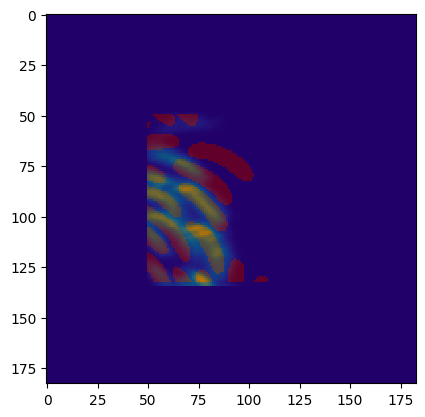

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                     105411605.769231
y                                                           49
x                                                           50
Name: 139, dtype: object
588 671 379 462
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


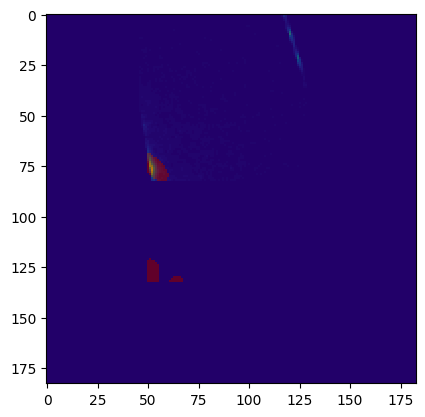

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    10
Scaling                                                    1.0
CrossCorr                                             276930.0
y                                                            0
x                                                           46
Name: 247, dtype: object
626 709 330 413
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


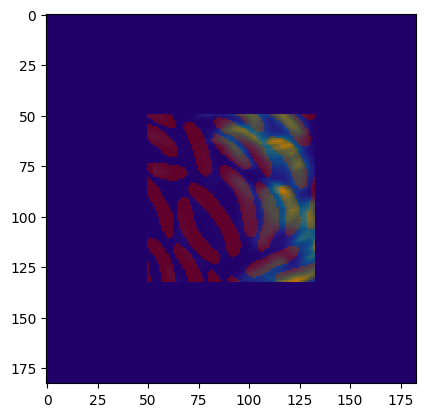

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          136880175.0
y                                                           50
x                                                           50
Name: 137, dtype: object
547 630 422 505
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


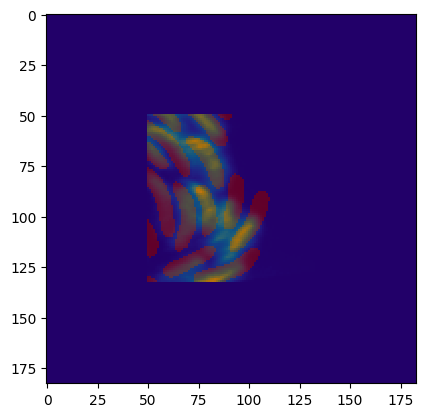

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                          151131360.0
y                                                           50
x                                                           50
Name: 137, dtype: object
588 671 422 505
(727, 827)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


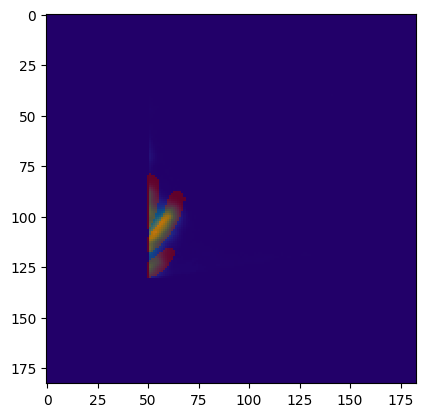

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      25403563.636364
y                                                           40
x                                                           51
Name: 142, dtype: object
631 714 412 495
(727, 827)
(83, 83)


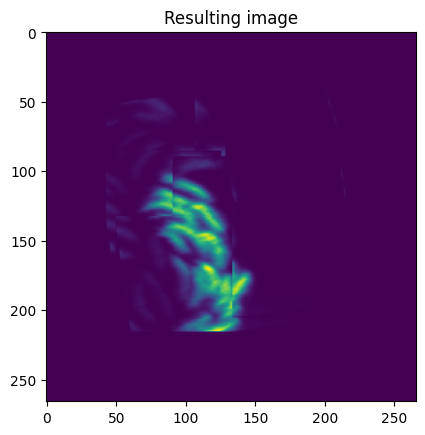

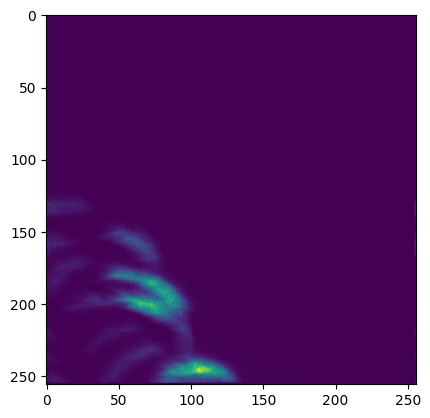

1000


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


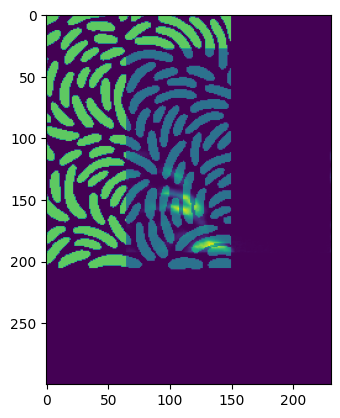

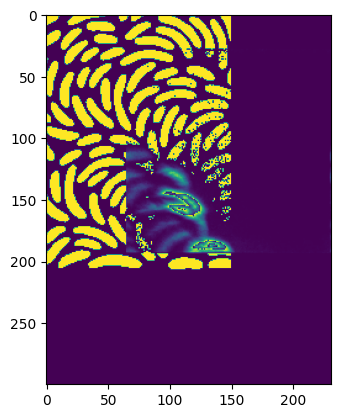

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   0.65
CrossCorr                                      84703153.846154
y                                                           28
x                                                           65
Name: 77, dtype: object
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


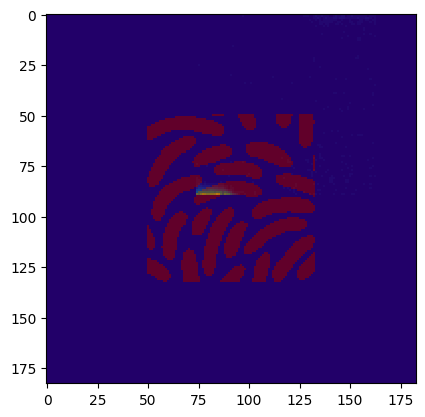

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.08
CrossCorr                                        205180.555556
y                                                            1
x                                                           74
Name: 141, dtype: object
139 222 29 112
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


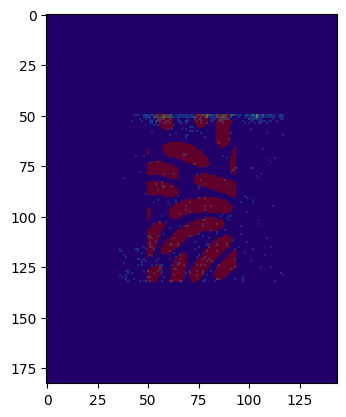

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                              50490.0
y                                                           50
x                                                           35
Name: 137, dtype: object
141 224 78 161
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


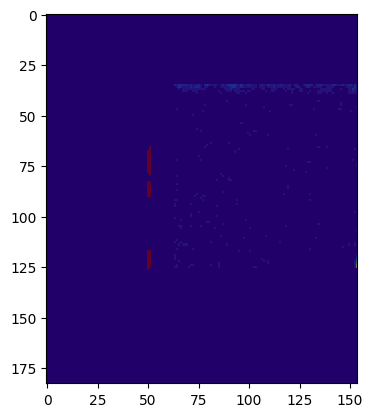

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                         10895.454545
y                                                           35
x                                                           63
Name: 142, dtype: object
211 294 63 146
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


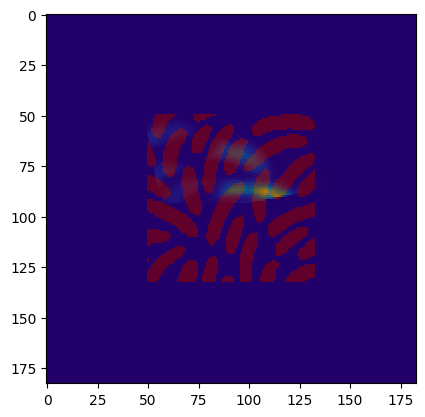

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                    11
Scaling                                                    1.1
CrossCorr                                      16142659.090909
y                                                            3
x                                                           49
Name: 263, dtype: object
114 197 72 155
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


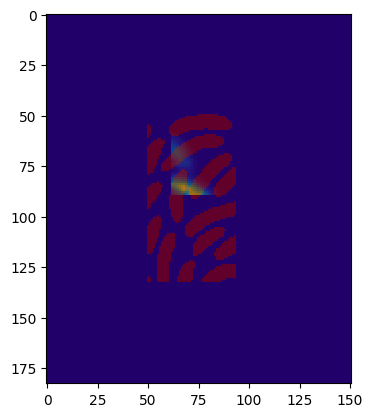

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.08
CrossCorr                                       8581458.333333
y                                                            1
x                                                           62
Name: 141, dtype: object
168 251 70 153
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


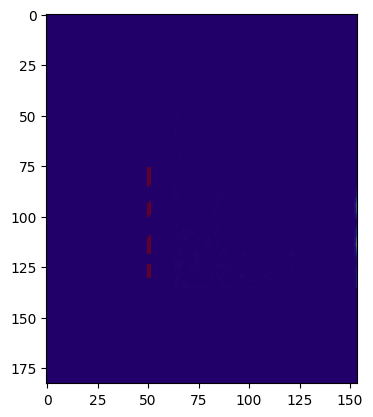

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                        189859.090909
y                                                           45
x                                                           63
Name: 142, dtype: object
211 294 114 197
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


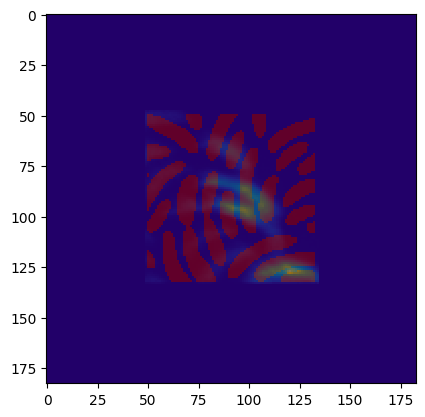

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                   1.04
CrossCorr                                      54272091.346154
y                                                           48
x                                                           49
Name: 139, dtype: object
114 197 159 242
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


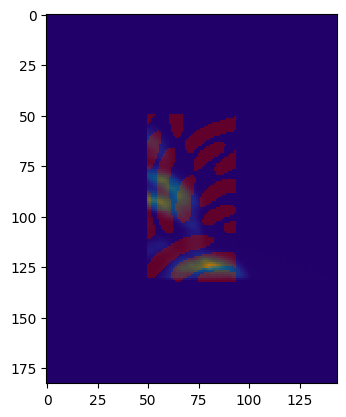

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.1
CrossCorr                                      41683922.727273
y                                                           41
x                                                           50
Name: 142, dtype: object
156 239 152 235
(427, 577)
(83, 83)
75


C:\Users\raachben\AppData\Local\Temp\ipykernel_10620\441106317.py:190: RuntimeWarning: overflow encountered in scalar negative
  image1[image1 == 0] = - np.max(image1) * self.negative_weighting


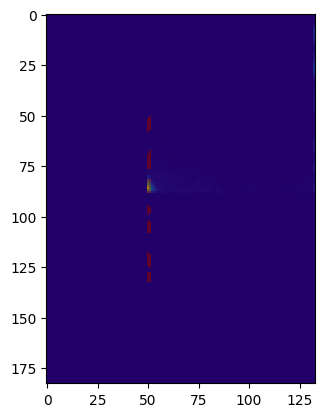

Path         C:\Users\raachben\Documents\Projects\Glen\Nano...
Rotation                                                     0
Scaling                                                    1.0
CrossCorr                                             346035.0
y                                                            6
x                                                           50
Name: 137, dtype: object
198 281 117 200
(427, 577)
(83, 83)


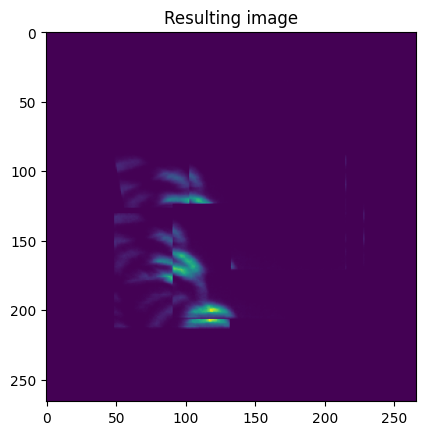

In [14]:
NanoSIMS_channel_11_2 = Image_stitching()

NanoSIMS_path_14N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\14N\FW_1108_pos11b_chn1_", "-14N12C.tif"]
NanoSIMS_path_15N = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\15N\FW_1108_pos11b_chn1_", "-15N12C.tif"]
NanoSIMS_path_12C = [r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\12C\FW_1108_pos11b_chn1_", "-12C2.tif"]
MF_mask_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\seg_im_bin\Timelapse_pos11_TxRed_frame049_seg_bin.png"
Results_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Combined"
h5_path = r'C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\track_output\tracking_strack.h5'
arrangement = [[1, 2, 3], [6, 5, 4], [7, 8, 9], [12, 11, 10]]  #[[1, 2, 3], [6, 5, 4], [7, 8, 9], [12, 11, 10]] 

#arrangement = [[10]]

mode = "overlay" # Choose "onoff" ; "overlay" ; "twochanneloverlay"

res_list_channel_11_2 = NanoSIMS_channel_11_2.create_combined_image(NanoSIMS_path_14N = NanoSIMS_path_14N, NanoSIMS_path_15N = NanoSIMS_path_15N, NanoSIMS_path_12C = NanoSIMS_path_12C, MF_mask_path = MF_mask_path, Results_path = Results_path, h5_path = h5_path, arrangement = arrangement, mode = mode)

In [19]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]

print(len(np.unique(labels)) -1 )

204


In [26]:
## Everything based on 14N 
intensity_map_14N_11_2 = np.array(NanoSIMS_channel_11_2.intensity_map_14N)
intensity_map_14N_11_2_unique = np.array([np.unique(intensity_map_14N_11_2[:,0]),np.array([float(max(intensity_map_14N_11_2[:,1][np.argwhere(intensity_map_14N_11_2[:,0] == index)])) for index in np.unique(intensity_map_14N_11_2[:,0])])]).T
intensity_map_unique_df_11_2 = pd.DataFrame(intensity_map_14N_11_2_unique, columns=("trackID", "14N"))
"""for i in np.unique(intensity_map_14N[:,0]):
    print(intensity_map_14N[np.where(intensity_map_14N[:,0] == i)])"""


intensity_map_15N_11_2 = np.array(NanoSIMS_channel_11_2.intensity_map_15N)
intensity_map_unique_df_11_2["15N"] = np.array([float(max(intensity_map_15N_11_2[:,1][np.argwhere(intensity_map_14N_11_2[:,0] == index)])) for index in np.unique(intensity_map_14N_11_2[:,0])])
"""for i in np.unique(intensity_map_15N[:,0]):
    print(intensity_map_15N[np.where(intensity_map_15N[:,0] == i)])"""


intensity_map_12C_11_2 = np.array(NanoSIMS_channel_11_2.intensity_map_12C)
intensity_map_unique_df_11_2["12C"] = np.array([float(max(intensity_map_12C_11_2[:,1][np.argwhere(intensity_map_14N_11_2[:,0] == index)])) for index in np.unique(intensity_map_14N_11_2[:,0])])
"""for i in np.unique(intensity_map_12C[:,0]):
    print(intensity_map_12C[np.where(intensity_map_12C[:,0] == i)])"""

intensity_map_unique_df_11_2["total_N"] =  (intensity_map_unique_df_11_2["15N"] + intensity_map_unique_df_11_2["14N"])
intensity_map_unique_df_11_2["15N_to_total_N"] = intensity_map_unique_df_11_2["15N"] / intensity_map_unique_df_11_2["total_N"]
intensity_map_unique_df_11_2["15N_to_14N"] = intensity_map_unique_df_11_2["15N"] / intensity_map_unique_df_11_2["14N"]
intensity_map_unique_df_11_2["total_N_to_12C"] = intensity_map_unique_df_11_2["total_N"] /intensity_map_unique_df_11_2["12C"] 


growth_df_11_2 = pd.read_csv(r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\track_output\analyzed\Chamber11_2-growth_rates_lineage_biomass_benny.csv")
growth_df_11_2 = growth_df_11_2[["trackID", "biomass_gain"]]

data_df_11_2 = pd.merge(intensity_map_unique_df_11_2, growth_df_11_2, on="trackID")
#data_df = data_df[["15N_to_total","growth_rate_lineage"]]

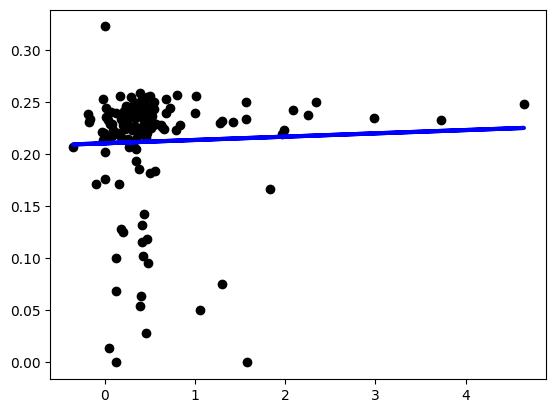

In [21]:
y = data_df_11_2["15N_to_total_N"]
x = data_df_11_2["biomass_gain"]
y = y[np.isfinite(x)]
x = x[np.isfinite(x)]
z = np.polyfit(x, y, deg=1)
#print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)

In [22]:
data_df_11_2

,trackID,14N,15N,12C,total_N,15N_to_total_N,total_N_to_12C,biomass_gain
0,4.0,0.100000,0.016667,0.016667,0.116667,0.142857,7.000000,0.430341
1,5.0,0.117978,0.056180,0.033708,0.174157,0.322581,5.166667,-0.003096
2,7.0,17.779553,5.517572,6.268371,23.297125,0.236835,3.716616,0.403587
3,31.0,0.531646,0.113924,0.177215,0.645570,0.176471,3.642857,0.003115
4,36.0,6.950000,2.192857,5.514286,9.142857,0.239844,1.658031,0.123967
...,...,...,...,...,...,...,...,...
142,514.0,0.023364,0.004673,0.004673,0.028037,0.166667,6.000000,1.832827
143,515.0,0.051546,0.015464,0.015464,0.067010,0.230769,4.333333,1.419453
144,517.0,3.129464,0.330357,2.245536,3.459821,0.095484,1.540755,0.474359
145,518.0,1.304965,0.269504,0.241135,1.574468,0.171171,6.529412,-0.096154


Bacteria before the filter: 147
 Bacteria before the filter: 118


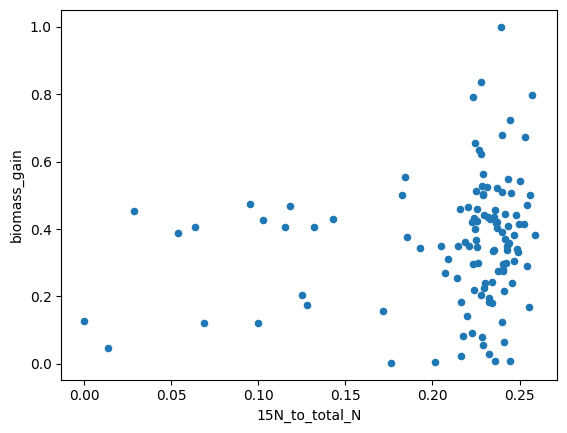

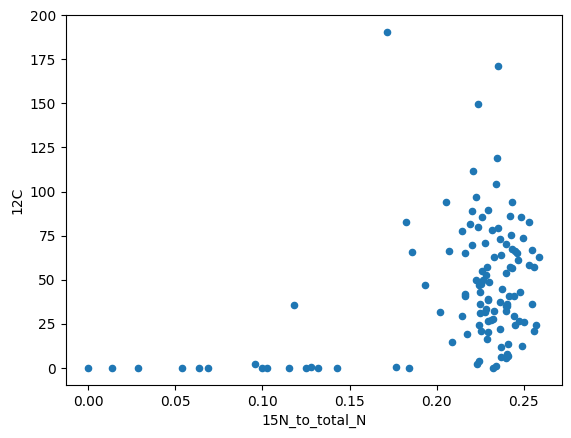

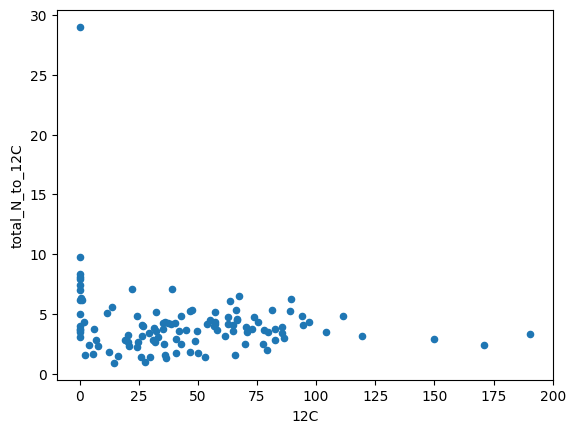

[0.05037215 0.19413192]


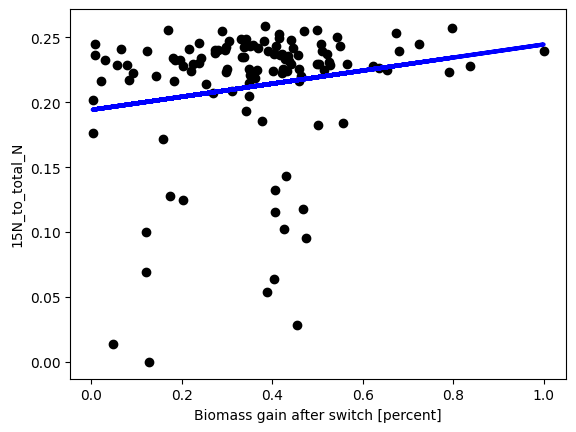

In [23]:
data_df_crop_11_2 = data_df_11_2
data_df_crop_11_2 = data_df_crop_11_2.loc[data_df_crop_11_2["15N_to_total_N"]      >= 0.0]
data_df_crop_11_2 = data_df_crop_11_2.loc[data_df_crop_11_2["biomass_gain"] <= 1.0]
data_df_crop_11_2 = data_df_crop_11_2.loc[data_df_crop_11_2["biomass_gain"] >= 0.00]

print("Bacteria before the filter: " + str(len(data_df_11_2["14N"])) + "\n", 
      "Bacteria before the filter: " + str(len(data_df_crop_11_2["14N"])))

data_df_crop_11_2.plot.scatter("15N_to_total_N", "biomass_gain")
plt.show()

data_df_crop_11_2.plot.scatter("15N_to_total_N", "12C")
plt.show()

data_df_crop_11_2.plot.scatter("12C", "total_N_to_12C")
plt.show()
data_df_crop_11_2.corr(method="spearman")


y = data_df_crop_11_2["15N_to_total_N"]
x = data_df_crop_11_2["biomass_gain"] # (np.exp(data_df_crop_11_2["lineages15_growth_rates"] * 10/12) - 1) * 100
z = np.polyfit(x, y, deg=1)
print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)
plt.ylabel("15N_to_total_N")
plt.xlabel("Biomass gain after switch [percent]")
plt.show()

204


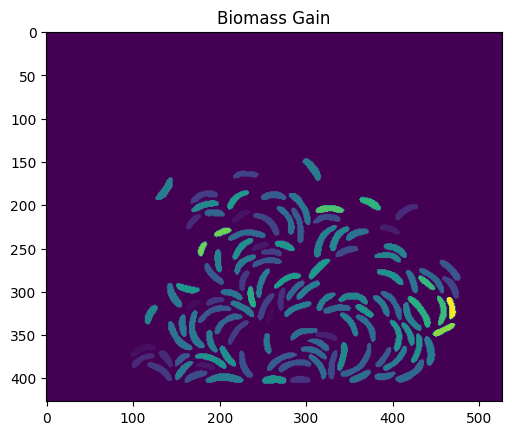

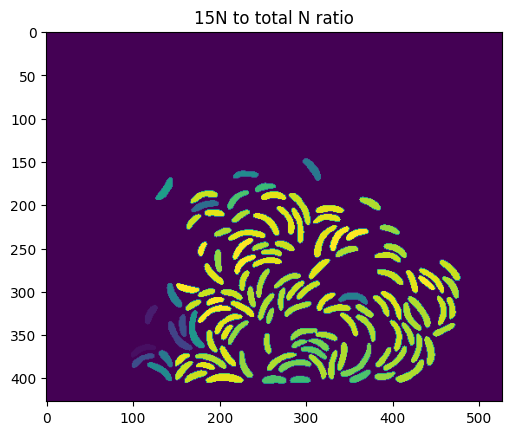

In [25]:
h5_path = r"C:\Users\raachben\Documents\Projects\Glen\NanoSims\NewAnalysisSept23\Chamber11_2\Growth\pos11\TxRed\track_output\tracking_strack.h5"

with h5py.File(h5_path, 'r') as f:

    images = f['images'][:]
    labels = f['labels'][:]

labels = labels[49]
biomass_gain_segmentation = labels.copy()
N15_total_N_ratio = labels.copy()
non_tracked_cells = np.unique(labels)[np.in1d(np.unique(labels), data_df_crop_11_2["trackID"], invert=True)]
print(len(np.unique(labels)) -1 )
for trackID in data_df_crop_11_2["trackID"].values: 
    biomass_gain_segmentation[labels == int(trackID)] = data_df_crop_11_2[data_df_crop_11_2["trackID"] == trackID]["biomass_gain"].values[0] * 100
    N15_total_N_ratio[labels == int(trackID)] = data_df_crop_11_2[data_df_crop_11_2["trackID"] == trackID]["15N_to_total_N"].values[0] * 100


for trackID in non_tracked_cells:
    biomass_gain_segmentation[labels == int(trackID)] = 0
    N15_total_N_ratio[labels == int(trackID)] = 0

plt.imshow(biomass_gain_segmentation)
plt.title("Biomass Gain")
plt.show()
plt.imshow(N15_total_N_ratio)
plt.title("15N to total N ratio")
plt.show()

<Axes: >

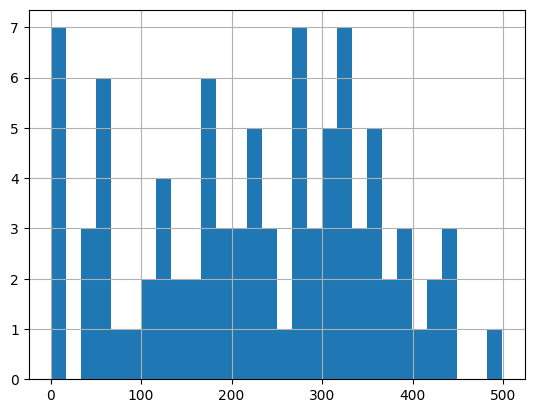

In [29]:
data_df["14N"].hist(bins = 30)

In [49]:
data_df_crop = data_df.     loc[data_df     ["14N"]                 >= 60]
data_df_crop = data_df_crop.loc[data_df_crop["15N_to_total_N"]      >= 0.0]
data_df_crop = data_df_crop.loc[data_df     ["lineages15_growth_rates"] <= 1.0]
data_df_crop = data_df_crop.loc[data_df     ["lineages15_growth_rates"] >= 0.15]

print("Bacteria before the filter: " + str(len(data_df["14N"])) + "\n", 
      "Bacteria before the filter: " + str(len(data_df_crop["14N"])))

data_df_crop.plot.scatter("15N_to_total_N", "lineages15_growth_rates")
plt.show()

data_df_crop.plot.scatter("15N_to_total_N", "12C")
plt.show()

data_df_crop.plot.scatter("12C", "total_N_to_12C")
plt.show()
data_df_crop.corr(method="spearman")


y = data_df_crop["15N_to_total_N"]
x = (np.exp(data_df_crop["lineages15_growth_rates"] * 10/12) - 1) * 100
z = np.polyfit(x, y, deg=1)
print(z)
p = np.poly1d(z)
plt.scatter(x, y,  color='black')
plt.plot(x, p(x), color='blue', linewidth=3)
plt.ylabel("15N_to_total_N")
plt.xlabel("Biomass gain after switch [percent]")
plt.show()

NameError: name 'data_df' is not defined

NameError: name 'data_df_crop_11_1' is not defined

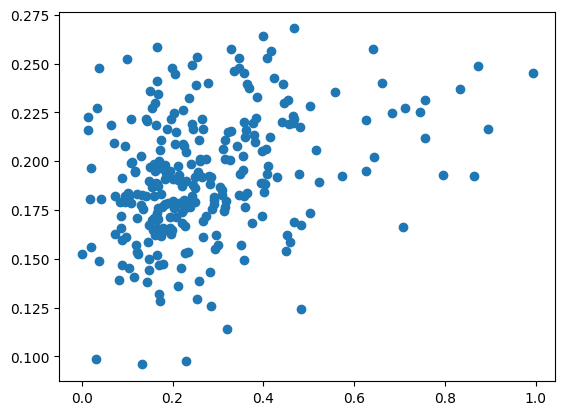

In [13]:
biomass_change_8_1 = data_df_crop_8_1["biomass_gain"] # (np.exp(data_df_crop_8_1["lineages15_growth_rates"] * 10/12) - 1) * 100
plt.scatter(biomass_change_8_1, data_df_crop_8_1["15N_to_total_N"],  label = "8_1")


biomass_change_11_1 = data_df_crop_11_1["biomass_gain"] # (np.exp(data_df_crop_11_1["lineages15_growth_rates"] * 10/12) - 1) * 100
plt.scatter(biomass_change_11_1, data_df_crop_11_1["15N_to_total_N"],  label = "11_1")


biomass_change_11_2 = data_df_crop_11_2["biomass_gain"]#(np.exp(data_df_crop_11_2["lineages15_growth_rates"] * 10/12) - 1) * 100
plt.scatter(biomass_change_11_2, data_df_crop_11_2["15N_to_total_N"],  label = "11_2")


plt.legend()

In [79]:
data_df_crop_8_1

,trackID,14N,15N,12C,total_N,15N_to_total_N,total_N_to_12C,lineages15_growth_rates
2,59.0,158.472028,44.804196,44.402098,203.276224,0.220410,4.578077,0.535398
3,76.0,221.517949,68.846154,50.179487,290.364103,0.237103,5.786510,0.535398
4,77.0,173.553571,59.203571,23.375000,232.757143,0.254358,9.957525,0.535398
5,88.0,447.885714,142.118367,87.816327,590.004082,0.240877,6.718615,0.535398
6,106.0,326.478261,109.748792,75.207729,436.227053,0.251586,5.800295,0.247000
...,...,...,...,...,...,...,...,...
378,2282.0,72.782051,22.291667,16.618590,95.073718,0.234467,5.720926,0.385181
379,2284.0,254.743243,79.493243,64.469595,334.236486,0.237835,5.184405,0.385181
380,2289.0,84.851695,23.216102,21.500000,108.067797,0.214829,5.026409,0.338561
381,2290.0,101.990000,15.420000,27.395000,117.410000,0.131335,4.285819,0.338561


In [217]:
data_df_crop_8_1

,trackID,14N,15N,12C,total_N,15N_to_total_N,total_N_to_12C,cell_area,biomass_gain,division_events
2,59.0,158.472028,44.804196,44.402098,203.276224,0.220410,4.578077,9.555,0.541096,1.0
3,76.0,221.517949,68.846154,50.179487,290.364103,0.237103,5.786510,16.315,0.278146,0.0
4,77.0,173.553571,59.203571,23.375000,232.757143,0.254358,9.957525,15.015,0.168142,0.0
7,107.0,392.602740,130.027397,91.821918,522.630137,0.248794,5.691780,8.710,0.873239,2.0
8,128.0,79.729508,18.110656,24.483607,97.840164,0.185105,3.996150,11.960,0.523810,1.0
...,...,...,...,...,...,...,...,...,...,...
379,2284.0,254.743243,79.493243,64.469595,334.236486,0.237835,5.184405,12.935,0.364532,0.0
380,2289.0,84.851695,23.216102,21.500000,108.067797,0.214829,5.026409,13.845,0.384164,1.0
381,2290.0,101.990000,15.420000,27.395000,117.410000,0.131335,4.285819,10.010,0.108504,1.0
382,2318.0,160.504630,49.967593,25.745370,210.472222,0.237407,8.175148,10.595,0.444015,1.0


(array([ 4., 11.,  9.,  7., 12.,  8., 15., 10.,  5.,  3.,  4.,  2.,  1.,
         3.,  1.,  0.,  1.,  0.,  0.,  1.]),
 array([ 6.63  ,  7.2735,  7.917 ,  8.5605,  9.204 ,  9.8475, 10.491 ,
        11.1345, 11.778 , 12.4215, 13.065 , 13.7085, 14.352 , 14.9955,
        15.639 , 16.2825, 16.926 , 17.5695, 18.213 , 18.8565, 19.5   ]),
 <BarContainer object of 20 artists>)

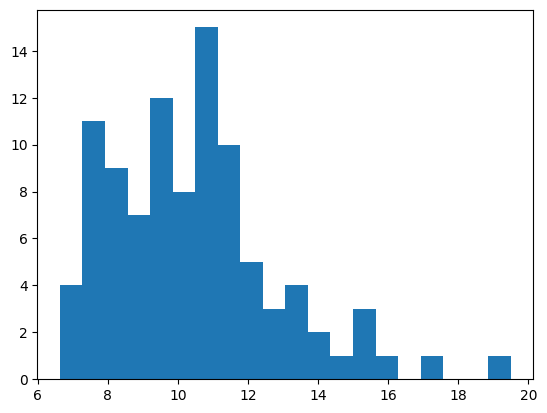

In [55]:
plt.hist(data_df_crop_8_1["cell_area"], bins = 20)

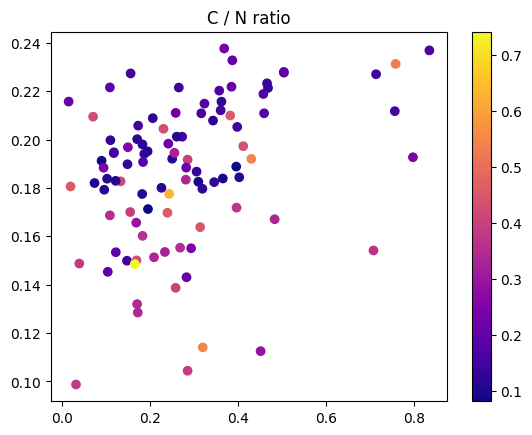

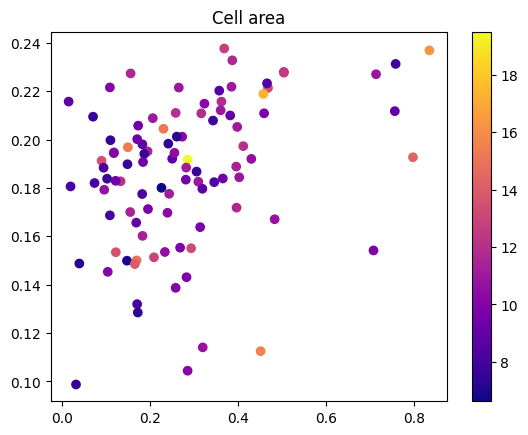

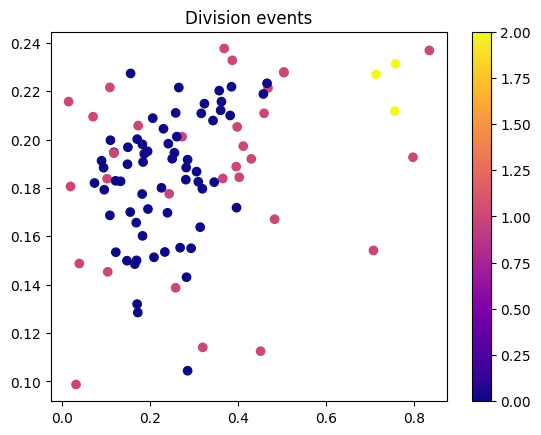

Empty DataFrame
Columns: [trackID, 14N, 15N, 12C, total_N, 15N_to_total_N, total_N_to_12C, cell_area, biomass_gain, division_events]
Index: []
    trackID         14N       15N       12C     total_N  15N_to_total_N  \
30   1067.0  227.470219  70.62069  50.15047  298.090909         0.23691   

    total_N_to_12C  cell_area  biomass_gain  division_events  
30         5.94393      16.25      0.833935              1.0  


In [56]:
C_N_ratio_8_1 = data_df_crop_8_1["12C"] / (data_df_crop_8_1["14N"] + data_df_crop_8_1["15N"])
plt.scatter(biomass_change_8_1, data_df_crop_8_1["15N_to_total_N"],  label = "8_1", c = C_N_ratio_8_1, cmap='plasma')
plt.title("C / N ratio")
plt.colorbar()
plt.show()
plt.scatter(biomass_change_8_1, data_df_crop_8_1["15N_to_total_N"],  label = "8_1", c = data_df_crop_8_1["cell_area"], cmap='plasma')
plt.title("Cell area"),
plt.colorbar()
plt.show()
plt.scatter(biomass_change_8_1, data_df_crop_8_1["15N_to_total_N"],  label = "8_1", c = data_df_crop_8_1["division_events"], cmap='plasma')
plt.title("Division events")
plt.colorbar()
plt.show()
outliers = data_df_crop_8_1[(data_df_crop_8_1["15N_to_total_N"] > 0.225) & (data_df_crop_8_1["biomass_gain"] < 0.1)]
print(outliers)

outliers = data_df_crop_8_1[(data_df_crop_8_1["biomass_gain"] > 0.8)]
print(outliers)

In [50]:
np.mean(np.argwhere(labels[i] == cell_id).T, axis = 1)

NameError: name 'i' is not defined

In [53]:
import numpy as np
import matplotlib.pyplot as plt
import imageio

cell_id =  77 # Left outliers 77, 578, 569, 1621, 1821
brange = 50

# Function to generate frames
def generate_frame(index):

    plt.figure(figsize=(5, 5))
    mid_pos = np.mean(np.argwhere(labels[index] == cell_id).T, axis = 1)
    if np.isnan(mid_pos).any():
        index = 25
        mid_pos = np.mean(np.argwhere(labels[index] == cell_id).T, axis = 1)
    mid_y , mid_x = int(mid_pos[0]), int(mid_pos[1])
    temp = labels[index][mid_y - brange: mid_y + brange, mid_x - brange: mid_x + brange]
    temp = np.where((temp != cell_id) & (temp != 0), 1, temp)
    temp = np.where(temp == cell_id, 2, temp)
    plt.imshow(temp)
    plt.axis('off')  # Turn off the axis
    # Save the plot as a PNG file
    filename = f'frame_{index}_cell_id_{cell_id}.png'
    plt.savefig(filename)
    plt.close()  # Close the figure to free memory
    return filename

# Generate frames
filenames = []
for index in np.arange(14, 40, 1):
    filename = generate_frame(index)
    filenames.append(filename)

# Create the GIF
with imageio.get_writer("cell_index" + str(cell_id) + ".gif", mode='I', duration=0.3) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)


print("GIF created successfully!")

ValueError: cannot convert float NaN to integer

<Figure size 500x500 with 0 Axes>

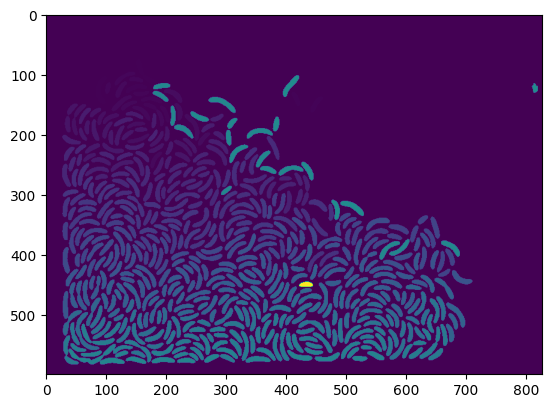

In [266]:
index = 14
temp = np.where(labels[index] == cell_id, 5000, labels[index])
plt.imshow(temp)

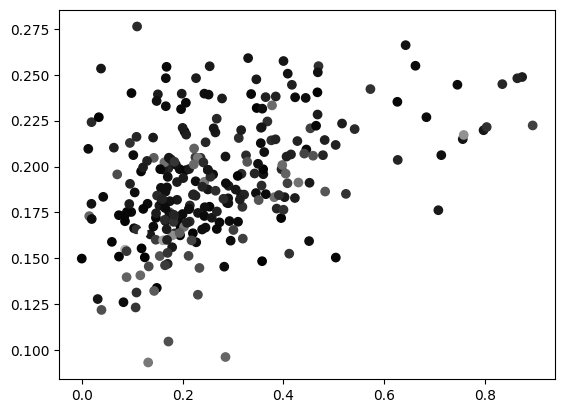

(array([127.,  93.,  17.,  18.,  11.,   2.,   2.,   0.,   0.,   1.]),
 array([0.0709329 , 0.16295923, 0.25498556, 0.34701189, 0.43903821,
        0.53106454, 0.62309087, 0.7151172 , 0.80714353, 0.89916985,
        0.99119618]),
 <BarContainer object of 10 artists>)

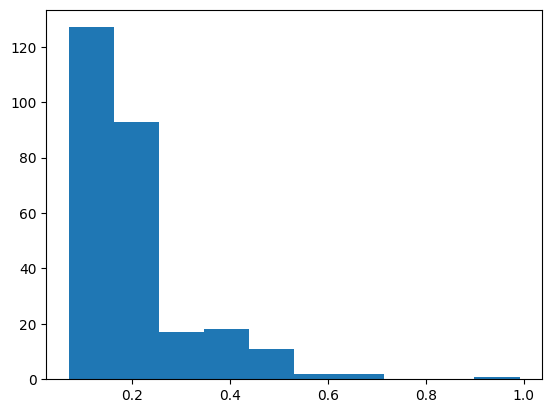

In [224]:
C_N_ratio_8_1 = data_df_crop_8_1["12C"] / (data_df_crop_8_1["14N"] + data_df_crop_8_1["15N"])
plt.scatter(biomass_change_8_1, data_df_crop_8_1["15N_to_total_N"],  label = "8_1", c = C_N_ratio_8_1, cmap='gray')
plt.show()
plt.hist(C_N_ratio_8_1)

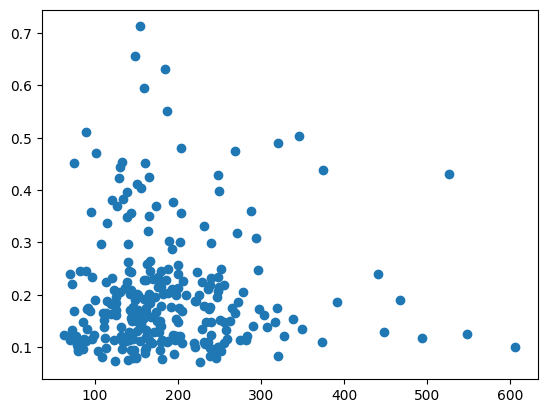

In [76]:
#plt.scatter(biomass_change_8_1, biomass_change_8_1/data_df_crop_8_1["15N_to_total_N"])
plt.scatter(biomass_change_8_1/data_df_crop_8_1["15N_to_total_N"], data_df_crop_8_1["12C"] / (data_df_crop_8_1["14N"] + data_df_crop_8_1["15N"]))

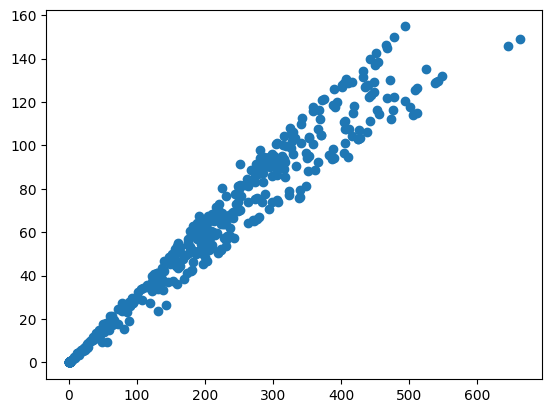

In [34]:
plt.scatter(intensity_map_14N[:,1], intensity_map_15N[:,1] )